**Woohyun Song_Network analysis on global trade data of Maize (Corn) and Poultry Meat**

# Network analysis on global trade data

## Deng et al. (2021)
### Social network analysis of virtual water trade among major countries in the world

In [1]:
import math
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt 
import plotly.express as px

pd.set_option('display.max_columns', None)

In [2]:
from collections import Counter 
import numpy as np
from operator import itemgetter
import powerlaw as pwl
from networkx.algorithms import community

In [3]:
pip install powerlaw

Note: you may need to restart the kernel to use updated packages.


# Data prep

### Visit the following website and download the bilateral trade data: https://www.fao.org/faostat/en/#data  
    - Trade > Detailed trade matrix    
    
### Find dataset for the node  
    - Population and Employment  
    - Macro Indicators  
    - SDG Indictors
    
    
### Navigate the metadata and other resources

# Link

### Load the trade data

In [4]:
origin_link = pd.read_csv("Trade_DetailedTradeMatrix_E_All_Data_(Normalized).csv", encoding='ISO-8859-1')

### Create an edge list

#### The final data format: O_code | D_code | O_name | D_name | year | item | weight (traded volume)

In [5]:
# select variables
origin_link = origin_link[['Reporter Country Code', 'Reporter Countries', 'Partner Country Code', 'Partner Countries', 'Item', 'Element', 'Year', 'Unit', 'Value']]
origin_link

,Reporter Country Code,Reporter Countries,Partner Country Code,Partner Countries,Item,Element,Year,Unit,Value
0,2,Afghanistan,9,Argentina,"Cake, oilseeds nes",Import quantity,2017,t,463.11
1,2,Afghanistan,9,Argentina,"Cake, oilseeds nes",Import quantity,2019,t,1192.62
2,3,Albania,3,Albania,Cigarettes,Import quantity,2004,t,12.00
3,4,Algeria,2,Afghanistan,"Almonds, shelled",Import quantity,2005,t,3.00
4,3,Albania,3,Albania,Cigarettes,Import value,2004,1000 USD,104.00
...,...,...,...,...,...,...,...,...,...
50428175,150,Netherlands (Kingdom of the),181,Zimbabwe,Wine,Export value,1988,1000 USD,1.00
50428176,150,Netherlands (Kingdom of the),181,Zimbabwe,Wine,Export value,1992,1000 USD,8.00
50428177,150,Netherlands (Kingdom of the),181,Zimbabwe,Wine,Export value,1999,1000 USD,2.00
50428178,150,Netherlands (Kingdom of the),181,Zimbabwe,Wine,Export value,2004,1000 USD,2.00


### Export Link

In [6]:
# filter down.. export quantity only.. select items... Remove 0 values
link_export = origin_link[
    (origin_link['Value'] > 0) & 
    (origin_link['Element'] == "Export quantity") & 
    (origin_link['Item'].isin(["Maize (corn)", "Meat of chickens, fresh or chilled"]))]
link_export = link_export.drop(['Unit'], axis = 1)
link_export

,Reporter Country Code,Reporter Countries,Partner Country Code,Partner Countries,Item,Element,Year,Value
197,9,Argentina,2,Afghanistan,Maize (corn),Export quantity,2017,130.00
637,9,Argentina,2,Afghanistan,"Meat of chickens, fresh or chilled",Export quantity,2005,126.00
667,9,Argentina,2,Afghanistan,"Meat of chickens, fresh or chilled",Export quantity,2009,530.00
709,9,Argentina,2,Afghanistan,"Meat of chickens, fresh or chilled",Export quantity,2010,281.00
741,9,Argentina,2,Afghanistan,"Meat of chickens, fresh or chilled",Export quantity,2011,722.00
...,...,...,...,...,...,...,...,...
50426472,150,Netherlands (Kingdom of the),181,Zimbabwe,"Meat of chickens, fresh or chilled",Export quantity,1988,18.00
50426473,150,Netherlands (Kingdom of the),181,Zimbabwe,"Meat of chickens, fresh or chilled",Export quantity,1989,611.00
50426474,150,Netherlands (Kingdom of the),181,Zimbabwe,"Meat of chickens, fresh or chilled",Export quantity,2011,27.00
50426475,150,Netherlands (Kingdom of the),181,Zimbabwe,"Meat of chickens, fresh or chilled",Export quantity,2012,405.00


In [7]:
print(link_export['Item'].value_counts())

Item
Meat of chickens, fresh or chilled    58636
Maize (corn)                          50123
Name: count, dtype: int64


### Import Link

In [8]:
link_import = origin_link[
    (origin_link['Value'] > 0) & 
    (origin_link['Element'] == "Import quantity") & 
    (origin_link['Item'].isin(["Maize (corn)", "Meat of chickens, fresh or chilled"]))]
link_import = link_import.drop(['Unit'], axis = 1)
link_import = link_import.iloc[:, [0, 3, 2, 1, 4, 5, 6, 7]]
link_import

,Reporter Country Code,Partner Countries,Partner Country Code,Reporter Countries,Item,Element,Year,Value
8,3,Albania,3,Albania,Maize (corn),Import quantity,2005,52.00
27,2,Argentina,9,Afghanistan,"Meat of chickens, fresh or chilled",Import quantity,2011,198.00
850,32,Afghanistan,2,Cameroon,Maize (corn),Import quantity,2000,22.00
1309,37,Antigua and Barbuda,8,Central African Republic,"Meat of chickens, fresh or chilled",Import quantity,2023,46.00
1315,46,Albania,3,Congo,"Meat of chickens, fresh or chilled",Import quantity,2021,23.73
...,...,...,...,...,...,...,...,...
50426372,150,Zimbabwe,181,Netherlands (Kingdom of the),Maize (corn),Import quantity,1998,28.00
50426373,150,Zimbabwe,181,Netherlands (Kingdom of the),Maize (corn),Import quantity,1999,19.00
50426374,150,Zimbabwe,181,Netherlands (Kingdom of the),Maize (corn),Import quantity,2000,5.00
50426379,150,Zimbabwe,181,Netherlands (Kingdom of the),Maize (corn),Import quantity,2005,2.00


In [9]:
print(link_import['Item'].value_counts())

Item
Maize (corn)                          51337
Meat of chickens, fresh or chilled    42059
Name: count, dtype: int64


### Merge Export/Import Link

In [10]:
link = pd.merge(link_export, link_import, on = ["Reporter Countries", "Partner Countries", "Year", "Item"])
link

,Reporter Country Code_x,Reporter Countries,Partner Country Code_x,Partner Countries,Item,Element_x,Year,Value_x,Reporter Country Code_y,Partner Country Code_y,Element_y,Value_y
0,53,Benin,10,Australia,"Meat of chickens, fresh or chilled",Export quantity,2001,24.00,53,10,Import quantity,23.00
1,249,Yemen,9,Argentina,Maize (corn),Export quantity,2014,2278.44,249,9,Import quantity,880928.37
2,249,Yemen,9,Argentina,Maize (corn),Export quantity,2015,4532.50,249,9,Import quantity,498098.76
3,249,Yemen,9,Argentina,Maize (corn),Export quantity,2018,1965.86,249,9,Import quantity,604625.70
4,249,Yemen,9,Argentina,Maize (corn),Export quantity,2019,72.00,249,9,Import quantity,693330.00
...,...,...,...,...,...,...,...,...,...,...,...,...
31830,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1988,3.00,150,248,Import quantity,161.00
31831,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1989,7.00,150,248,Import quantity,339.00
31832,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1990,20753.00,150,248,Import quantity,202.00
31833,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1991,704.00,150,248,Import quantity,73.00


In [11]:
link["Final Value"] = np.where(link["Value_x"] > link["Value_y"], link['Value_x'], link['Value_y'])
link

,Reporter Country Code_x,Reporter Countries,Partner Country Code_x,Partner Countries,Item,Element_x,Year,Value_x,Reporter Country Code_y,Partner Country Code_y,Element_y,Value_y,Final Value
0,53,Benin,10,Australia,"Meat of chickens, fresh or chilled",Export quantity,2001,24.00,53,10,Import quantity,23.00,24.00
1,249,Yemen,9,Argentina,Maize (corn),Export quantity,2014,2278.44,249,9,Import quantity,880928.37,880928.37
2,249,Yemen,9,Argentina,Maize (corn),Export quantity,2015,4532.50,249,9,Import quantity,498098.76,498098.76
3,249,Yemen,9,Argentina,Maize (corn),Export quantity,2018,1965.86,249,9,Import quantity,604625.70,604625.70
4,249,Yemen,9,Argentina,Maize (corn),Export quantity,2019,72.00,249,9,Import quantity,693330.00,693330.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...
31830,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1988,3.00,150,248,Import quantity,161.00,161.00
31831,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1989,7.00,150,248,Import quantity,339.00,339.00
31832,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1990,20753.00,150,248,Import quantity,202.00,20753.00
31833,150,Netherlands (Kingdom of the),248,Yugoslav SFR,Maize (corn),Export quantity,1991,704.00,150,248,Import quantity,73.00,704.00


### Final Link !!

In [12]:
link.rename(columns={'Reporter Country Code_x': 'O_code',
                             'Reporter Country Code_y': 'O_code2',
                             'Partner Country Code_x': 'D_code', 
                             'Partner Country Code_y': 'D_code2', 
                             'Reporter Countries': 'O_name',
                             'Partner Countries': 'D_name',
                             'Value_x': 'Export Weight',
                             'Value_y': 'Import Weight',
                             'Element_x': 'Export Quantity',
                             'Element_y': 'Import Quantity'}, inplace=True)

link = link[['O_code', 'D_code', 'O_name', 'D_name', 'Item', 'Export Quantity', 'Year', 'Export Weight', 'Import Quantity', 'Import Weight', 'Final Value']]
link

,O_code,D_code,O_name,D_name,Item,Export Quantity,Year,Export Weight,Import Quantity,Import Weight,Final Value
0,53,10,Benin,Australia,"Meat of chickens, fresh or chilled",Export quantity,2001,24.00,Import quantity,23.00,24.00
1,249,9,Yemen,Argentina,Maize (corn),Export quantity,2014,2278.44,Import quantity,880928.37,880928.37
2,249,9,Yemen,Argentina,Maize (corn),Export quantity,2015,4532.50,Import quantity,498098.76,498098.76
3,249,9,Yemen,Argentina,Maize (corn),Export quantity,2018,1965.86,Import quantity,604625.70,604625.70
4,249,9,Yemen,Argentina,Maize (corn),Export quantity,2019,72.00,Import quantity,693330.00,693330.00
...,...,...,...,...,...,...,...,...,...,...,...
31830,150,248,Netherlands (Kingdom of the),Yugoslav SFR,Maize (corn),Export quantity,1988,3.00,Import quantity,161.00,161.00
31831,150,248,Netherlands (Kingdom of the),Yugoslav SFR,Maize (corn),Export quantity,1989,7.00,Import quantity,339.00,339.00
31832,150,248,Netherlands (Kingdom of the),Yugoslav SFR,Maize (corn),Export quantity,1990,20753.00,Import quantity,202.00,20753.00
31833,150,248,Netherlands (Kingdom of the),Yugoslav SFR,Maize (corn),Export quantity,1991,704.00,Import quantity,73.00,704.00


### Link of Year = 1986, 2023

#### When Year = 1986

In [13]:
link_1986 = link[(link["Year"] == 1986) & (link['Item'])]

link_1986

,O_code,D_code,O_name,D_name,Item,Export Quantity,Year,Export Weight,Import Quantity,Import Weight,Final Value
60,248,11,Yugoslav SFR,Austria,Maize (corn),Export quantity,1986,7059.0,Import quantity,15.0,7059.0
310,135,68,Martinique,France,"Meat of chickens, fresh or chilled",Export quantity,1986,19.0,Import quantity,5445.0,5445.0
343,11,9,Austria,Argentina,Maize (corn),Export quantity,1986,300.0,Import quantity,2109.0,2109.0
348,15,10,Belgium-Luxembourg,Australia,Maize (corn),Export quantity,1986,2.0,Import quantity,3.0,3.0
352,248,68,Yugoslav SFR,France,Maize (corn),Export quantity,1986,734.0,Import quantity,8.0,734.0
...,...,...,...,...,...,...,...,...,...,...,...
31636,68,231,France,United States of America,Maize (corn),Export quantity,1986,12.0,Import quantity,77308.0,77308.0
31707,68,248,France,Yugoslav SFR,Maize (corn),Export quantity,1986,4.0,Import quantity,16773.0,16773.0
31713,150,229,Netherlands (Kingdom of the),United Kingdom of Great Britain and Northern I...,Maize (corn),Export quantity,1986,18513.0,Import quantity,5.0,18513.0
31751,150,229,Netherlands (Kingdom of the),United Kingdom of Great Britain and Northern I...,"Meat of chickens, fresh or chilled",Export quantity,1986,27916.0,Import quantity,2375.0,27916.0


#### When Year = 2023

In [14]:
link_2023 = link[(link["Year"] == 2023) & (link['Item'])]

link_2023

,O_code,D_code,O_name,D_name,Item,Export Quantity,Year,Export Weight,Import Quantity,Import Weight,Final Value
6,251,7,Zambia,Angola,Maize (corn),Export quantity,2023,312.50,Import quantity,0.03,312.50
31,89,9,Guatemala,Argentina,Maize (corn),Export quantity,2023,0.50,Import quantity,773.88,773.88
93,113,57,Kyrgyzstan,Belarus,"Meat of chickens, fresh or chilled",Export quantity,2023,449.56,Import quantity,4160.14,4160.14
114,200,9,Singapore,Argentina,"Meat of chickens, fresh or chilled",Export quantity,2023,26.99,Import quantity,1936.74,1936.74
121,235,57,Uzbekistan,Belarus,"Meat of chickens, fresh or chilled",Export quantity,2023,601.11,Import quantity,3032.87,3032.87
...,...,...,...,...,...,...,...,...,...,...,...
31682,150,230,Netherlands (Kingdom of the),Ukraine,Maize (corn),Export quantity,2023,6.00,Import quantity,1583700.95,1583700.95
31695,150,230,Netherlands (Kingdom of the),Ukraine,"Meat of chickens, fresh or chilled",Export quantity,2023,21.50,Import quantity,99427.42,99427.42
31712,68,251,France,Zambia,Maize (corn),Export quantity,2023,1.45,Import quantity,1.75,1.75
31750,150,229,Netherlands (Kingdom of the),United Kingdom of Great Britain and Northern I...,Maize (corn),Export quantity,2023,1735.84,Import quantity,77.78,1735.84


# Node

### Create a node data combining multiple sources

#### The final data format: country | country_code | continent | population | var1 | var2 | var3...

In [15]:
pop = pd.read_csv("Population_E_All_Data_(Normalized).csv")
macro = pd.read_csv("Macro-Statistics_Key_Indicators_E_All_Data_(Normalized).csv", encoding_errors = "ignore")
crop = pd.read_csv("Production_Crops_Livestock_E_All_Data_(Normalized).csv")

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/1538018799.py:3: DtypeWarning: Columns (13) have mixed types. Specify dtype option on import or set low_memory=False.
  crop = pd.read_csv("Production_Crops_Livestock_E_All_Data_(Normalized).csv")


### Node 1: pop

In [16]:
pop = pop[["Area Code", "Area", "Item", "Element", "Year", "Unit", "Value"]]
pop['Element'].unique()

array(['Total Population - Both sexes', 'Total Population - Male',
       'Total Population - Female', 'Rural population',
       'Urban population'], dtype=object)

In [17]:
pop = pop[
    pop['Element'] == 'Total Population - Both sexes'
].copy()

pop = pop.rename(columns={
    'Area': 'country',
    'Area Code': 'country_code',
    'Value': 'population'
})

pop = pop[['country_code', 'country', 'Year', 'population']]
pop

,country_code,country,Year,population
0,2,Afghanistan,1950,7776.176
1,2,Afghanistan,1951,7879.339
2,2,Afghanistan,1952,7987.783
3,2,Afghanistan,1953,8096.698
4,2,Afghanistan,1954,8207.950
...,...,...,...,...
168180,5817,Net Food Importing Developing Countries,2096,4144125.869
168181,5817,Net Food Importing Developing Countries,2097,4158246.297
168182,5817,Net Food Importing Developing Countries,2098,4171739.404
168183,5817,Net Food Importing Developing Countries,2099,4184643.628


### Node 2: Macro

In [18]:
macro = macro[["Area Code", "Area", "Item", "Element", "Year", "Unit", "Value"]]
macro['Element'].unique()

array(['Value Standard Local Currency', 'Value US$',
       'Value US$ per capita',
       'Value Standard Local Currency, 2015 prices',
       'Value US$ per capita, 2015 prices', 'Value US$, 2015 prices',
       'Annual growth Standard Local Currency',
       'Annual growth Standard Local Currency, 2015 prices',
       'Annual growth US$', 'Annual growth US$ per capita',
       'Annual growth US$, 2015 prices',
       'Annual growth US$ per capita, 2015 prices', 'Share of GDP US$',
       'Share of GDP US$, 2015 prices',
       'Share of GDP Standard Local Currency',
       'Share of GDP Standard Local Currency, 2015 prices',
       'Ratio of Value Added (Agriculture, Forestry and Fishing) Standard Local Currency',
       'Ratio of Value Added (Agriculture, Forestry and Fishing) US$',
       'Share of Value Added (Total Manufacturing) Standard Local Currency',
       'Share of Value Added (Total Manufacturing) US$'], dtype=object)

In [19]:
macro = macro[
    macro['Element'].isin(['Value US$', 'Value US$ per capita'])
].copy()

macro = macro.rename(columns={
    'Area': 'country',
    'Area Code': 'country_code'
})

macro = macro.pivot_table(
    index=['country_code', 'country', 'Year'],
    columns='Element',
    values='Value'
).reset_index()

macro.columns.name = None
macro = macro.rename(columns={
    'Value US$': 'GDP_total',
    'Value US$ per capita': 'GDP_per_capita'
})

macro

,country_code,country,Year,GDP_total,GDP_per_capita
0,1,Armenia,1990,1.342140e+03,648.434280
1,1,Armenia,1991,1.209531e+03,581.384603
2,1,Armenia,1992,6.902243e+02,350.112378
3,1,Armenia,1993,6.617702e+02,338.009416
4,1,Armenia,1994,7.105644e+02,371.965737
...,...,...,...,...,...
12683,5817,Net Food Importing Developing Countries,2019,1.484120e+06,1785.972381
12684,5817,Net Food Importing Developing Countries,2020,1.466407e+06,1732.888236
12685,5817,Net Food Importing Developing Countries,2021,1.634971e+06,1893.627261
12686,5817,Net Food Importing Developing Countries,2022,1.708618e+06,1943.686661


### Node 3: Crop

In [20]:
crop = crop[["Area Code", "Area", "Item", "Element", "Year", "Unit", "Value"]]
crop['Element'].unique()

array(['Area harvested', 'Yield', 'Production', 'Stocks',
       'Producing Animals/Slaughtered', 'Yield/Carcass Weight', 'Laying',
       'Milk Animals'], dtype=object)

In [21]:
crop = crop[
    crop['Element'].isin(['Area harvested', 'Production', 'Producing Animals/Slaughtered'])
].copy()

crop = crop.rename(columns={
    'Area': 'country',
    'Area Code': 'country_code'
})

crop = crop.pivot_table(
    index=['country_code', 'country', 'Year'],
    columns='Element',
    values='Value'
).reset_index()

crop

Element,country_code,country,Year,Area harvested,Producing Animals/Slaughtered,Production
0,1,Armenia,1992,1.432831e+04,2.246316e+05,5.427447e+04
1,1,Armenia,1993,1.617544e+04,2.004684e+05,5.280955e+04
2,1,Armenia,1994,1.525567e+04,1.840318e+05,5.572169e+04
3,1,Armenia,1995,1.380900e+04,1.753334e+05,5.759095e+04
4,1,Armenia,1996,1.512586e+04,1.608089e+05,5.889337e+04
...,...,...,...,...,...,...
14073,5817,Net Food Importing Developing Countries,2019,3.777406e+06,5.515324e+07,1.010309e+07
14074,5817,Net Food Importing Developing Countries,2020,3.886402e+06,5.675486e+07,1.048946e+07
14075,5817,Net Food Importing Developing Countries,2021,3.923839e+06,5.604965e+07,1.074867e+07
14076,5817,Net Food Importing Developing Countries,2022,3.949062e+06,5.703704e+07,1.086831e+07


### Merge the Node 

In [22]:
node_merge = pd.merge(pop, macro, on=['country_code', 'country', 'Year'], how='inner')

node = pd.merge(node_merge, crop, on=['country_code', 'country', 'Year'], how='inner')

node

,country_code,country,Year,population,GDP_total,GDP_per_capita,Area harvested,Producing Animals/Slaughtered,Production
0,2,Afghanistan,1970,11290.128,9.762904e+02,164.295571,1.674061e+05,2.203211e+06,1.426433e+05
1,2,Afghanistan,1971,11567.667,1.022292e+03,167.939527,1.774311e+05,2.219689e+06,1.344967e+05
2,2,Afghanistan,1972,11853.696,8.947686e+02,142.940332,2.013650e+05,1.848032e+06,1.494889e+05
3,2,Afghanistan,1973,12157.999,9.745076e+02,151.375805,1.775709e+05,1.998084e+06,1.624347e+05
4,2,Afghanistan,1974,12469.127,1.218110e+03,183.564538,1.835789e+05,2.113111e+06,1.677311e+05
...,...,...,...,...,...,...,...,...,...
11564,5817,Net Food Importing Developing Countries,2019,1676505.386,1.484120e+06,1785.972381,3.777406e+06,5.515324e+07,1.010309e+07
11565,5817,Net Food Importing Developing Countries,2020,1711081.717,1.466407e+06,1732.888236,3.886402e+06,5.675486e+07,1.048946e+07
11566,5817,Net Food Importing Developing Countries,2021,1745883.120,1.634971e+06,1893.627261,3.923839e+06,5.604965e+07,1.074867e+07
11567,5817,Net Food Importing Developing Countries,2022,1780529.299,1.708618e+06,1943.686661,3.949062e+06,5.703704e+07,1.086831e+07


#### Check if the countries match well with the edge list above

In [23]:
node_countries = set(node['country'].unique())

link_reporters = set(link['O_name'].unique())
link_partners = set(link['D_name'].unique())

missing_reporters = link_reporters - node_countries
missing_partners = link_partners - node_countries

print("Missing Reporter Countries:", missing_reporters)
print("Missing Partner Countries:", missing_partners)

Missing Reporter Countries: {'TÃ¼rkiye', 'Guadeloupe', 'Belgium-Luxembourg', "CÃ´te d'Ivoire", 'Serbia and Montenegro', 'RÃ©union', 'Martinique', 'China, Taiwan Province of'}
Missing Partner Countries: {'TÃ¼rkiye', 'Guadeloupe', 'Belgium-Luxembourg', "CÃ´te d'Ivoire", 'Serbia and Montenegro', 'Faroe Islands', 'RÃ©union', 'Martinique', 'China, Taiwan Province of'}


# Analysis  

- density, asymmetry
- out-degree, in-degree (fitting power-law distribution)
- network visualization
- temporal change
- alternative visualizations: chordal graph

# Density

## Seperate the Link (Maize & Chicken)

In [24]:
lm = link[link['Item'] == 'Maize (corn)'].copy()

lc = link[link['Item'] == 'Meat of chickens, fresh or chilled'].copy()

In [25]:
print("Maize link number:", len(lm))
print("Chicken link number:", len(lc))


Maize link number: 17951
Chicken link number: 13884


In [26]:
lm.head()

,O_code,D_code,O_name,D_name,Item,Export Quantity,Year,Export Weight,Import Quantity,Import Weight,Final Value
1,249,9,Yemen,Argentina,Maize (corn),Export quantity,2014,2278.44,Import quantity,880928.37,880928.37
2,249,9,Yemen,Argentina,Maize (corn),Export quantity,2015,4532.50,Import quantity,498098.76,498098.76
3,249,9,Yemen,Argentina,Maize (corn),Export quantity,2018,1965.86,Import quantity,604625.70,604625.70
4,249,9,Yemen,Argentina,Maize (corn),Export quantity,2019,72.00,Import quantity,693330.00,693330.00
5,133,9,Mali,Argentina,Maize (corn),Export quantity,2008,92.00,Import quantity,182.00,182.00


In [27]:
lc.head()

,O_code,D_code,O_name,D_name,Item,Export Quantity,Year,Export Weight,Import Quantity,Import Weight,Final Value
0,53,10,Benin,Australia,"Meat of chickens, fresh or chilled",Export quantity,2001,24.00,Import quantity,23.00,24.00
7,196,9,Seychelles,Argentina,"Meat of chickens, fresh or chilled",Export quantity,2006,11.00,Import quantity,23.00,23.00
8,72,41,Djibouti,"China, mainland","Meat of chickens, fresh or chilled",Export quantity,2021,58.79,Import quantity,37.36,58.79
21,135,15,Martinique,Belgium-Luxembourg,"Meat of chickens, fresh or chilled",Export quantity,1992,25.00,Import quantity,471.00,471.00
22,181,9,Zimbabwe,Argentina,"Meat of chickens, fresh or chilled",Export quantity,2010,3.00,Import quantity,420.00,420.00


## Maize (Corn) Network

In [28]:
# Set link
gm = nx.from_pandas_edgelist(lm,
                            source = 'O_name',
                            target = 'D_name',
                            edge_attr='Final Value',
                            create_using=nx.DiGraph())

In [29]:
# Set Node
node_unique = node.drop_duplicates(subset='country')

node_attr = node_unique.set_index('country').to_dict('index')
nx.set_node_attributes(gm, node_attr)

In [30]:
gm.nodes(data = True)

NodeDataView({'Yemen': {'country_code': 249, 'Year': 1989, 'population': 13364.174, 'GDP_total': 1600.9902212000002, 'GDP_per_capita': 253.654588, 'Area harvested': 34036.703125, 'Producing Animals/Slaughtered': 1086128.2105263157, 'Production': 49671.08111111111}, 'Argentina': {'country_code': 9, 'Year': 1970, 'population': 23878.327, 'GDP_total': 16012.4307734, 'GDP_per_capita': 1265.7520565, 'Area harvested': 561355.1666666666, 'Producing Animals/Slaughtered': 5234064.92, 'Production': 768239.7094039735}, 'Mali': {'country_code': 133, 'Year': 1970, 'population': 6276.472, 'GDP_total': 196.16133059999999, 'GDP_per_capita': 52.368023, 'Area harvested': 96937.29268292683, 'Producing Animals/Slaughtered': 632798.6, 'Production': 51102.12829787234}, 'Zambia': {'country_code': 251, 'Year': 1970, 'population': 4321.718, 'GDP_total': 745.9087818, 'GDP_per_capita': 369.72144000000003, 'Area harvested': 75537.88571428572, 'Producing Animals/Slaughtered': 75081.57894736843, 'Production': 47015

In [31]:
gm.edges(data=True)

OutEdgeDataView([('Yemen', 'Argentina', {'Final Value': 693330.0}), ('Yemen', 'India', {'Final Value': 1478.7}), ('Yemen', 'Oman', {'Final Value': 2.0}), ('Yemen', 'Saudi Arabia', {'Final Value': 10695.94}), ('Yemen', 'Sudan (former)', {'Final Value': 3005.0}), ('Yemen', 'United Arab Emirates', {'Final Value': 762.0}), ('Argentina', 'Australia', {'Final Value': 315.0}), ('Argentina', 'Austria', {'Final Value': 23.7}), ('Argentina', 'Belgium-Luxembourg', {'Final Value': 124172.0}), ('Argentina', 'Bolivia (Plurinational State of)', {'Final Value': 880.5}), ('Argentina', 'Brazil', {'Final Value': 2635.24}), ('Argentina', 'Canada', {'Final Value': 110.63}), ('Argentina', 'Chile', {'Final Value': 1382025.11}), ('Argentina', 'China, Taiwan Province of', {'Final Value': 140252.0}), ('Argentina', 'Colombia', {'Final Value': 1018558.0}), ('Argentina', 'France', {'Final Value': 752.27}), ('Argentina', 'Germany', {'Final Value': 3016.6}), ('Argentina', 'Guatemala', {'Final Value': 688.81}), ('Arg

## Meat of chickens, fresh or chilled Network

In [32]:
# Set link
gc = nx.from_pandas_edgelist(lc,
                            source = 'O_name',
                            target = 'D_name',
                            edge_attr='Final Value',
                            create_using=nx.DiGraph())

In [33]:
# Set Node
node_unique = node.drop_duplicates(subset='country')

node_attr = node_unique.set_index('country').to_dict('index')
nx.set_node_attributes(gc, node_attr)

In [34]:
gc.nodes(data = True)

NodeDataView({'Benin': {'country_code': 53, 'Year': 1970, 'population': 3065.057, 'GDP_total': 162.90109660000002, 'GDP_per_capita': 106.12035599999999, 'Area harvested': 49443.53333333333, 'Producing Animals/Slaughtered': 135283.68421052632, 'Production': 47921.493295454544}, 'Australia': {'country_code': 10, 'Year': 1970, 'population': 12599.411, 'GDP_total': 23171.6575682, 'GDP_per_capita': 3570.2966109999998, 'Area harvested': 279869.0853658537, 'Producing Animals/Slaughtered': 10931666.869565217, 'Production': 685306.3551923076}, 'Seychelles': {'country_code': 196, 'Year': 1970, 'population': 54.252, 'GDP_total': 11.0565308, 'GDP_per_capita': 408.7653965, 'Area harvested': 1622.875, 'Producing Animals/Slaughtered': 1179.4375, 'Production': 968.5355319148936}, 'Argentina': {'country_code': 9, 'Year': 1970, 'population': 23878.327, 'GDP_total': 16012.4307734, 'GDP_per_capita': 1265.7520565, 'Area harvested': 561355.1666666666, 'Producing Animals/Slaughtered': 5234064.92, 'Production

In [35]:
gc.edges(data=True)

OutEdgeDataView([('Benin', 'Australia', {'Final Value': 24.0}), ('Benin', 'Belgium', {'Final Value': 180.0}), ('Benin', 'Brazil', {'Final Value': 992.0}), ('Benin', 'Canada', {'Final Value': 2294.0}), ('Benin', "CÃ´te d'Ivoire", {'Final Value': 25.0}), ('Benin', 'Denmark', {'Final Value': 966.0}), ('Benin', 'France', {'Final Value': 4888.57}), ('Benin', 'Italy', {'Final Value': 6577.82}), ('Benin', 'Netherlands (Kingdom of the)', {'Final Value': 3190.0}), ('Benin', 'Nigeria', {'Final Value': 1935.0}), ('Benin', 'Spain', {'Final Value': 2276.0}), ('Benin', 'United Kingdom of Great Britain and Northern Ireland', {'Final Value': 3705.0}), ('Benin', 'United States of America', {'Final Value': 635.0}), ('Australia', 'Australia', {'Final Value': 253.0}), ('Australia', 'New Zealand', {'Final Value': 88.18}), ('Australia', 'Singapore', {'Final Value': 82.26}), ('Australia', 'South Africa', {'Final Value': 968.0}), ('Seychelles', 'Argentina', {'Final Value': 23.0}), ('Seychelles', 'Australia', 

## Make Density Plot (Maize) (1986-2023)

### Caluculate Density of Maize (1986-2023)

In [36]:
density_maize = []

for i in range(1986, 2024):

    lm_i = lm[lm['Year'] == i]
    
    node_i = node[node['Year'] == i].drop_duplicates(subset='country')

    g_i = nx.from_pandas_edgelist(lm_i,
                                   source='O_name',
                                   target='D_name',
                                   edge_attr='Final Value',
                                   create_using=nx.DiGraph())

    node_attr = node_i.set_index('country').to_dict('index')
    nx.set_node_attributes(g_i, node_attr)

    density_i = nx.density(g_i)
    density_maize.append(density_i)

print(density_maize)

[0.04487179487179487, 0.05585106382978723, 0.05612244897959184, 0.0563265306122449, 0.041914682539682536, 0.06234335839598997, 0.05336538461538461, 0.05008525149190111, 0.04477101845522898, 0.045263157894736845, 0.043209876543209874, 0.03945068664169788, 0.0347124824684432, 0.034266517357222845, 0.03706140350877193, 0.042044911610129, 0.038033395176252316, 0.04090909090909091, 0.03976848394324122, 0.043838383838383836, 0.041758241758241756, 0.043202257097513665, 0.05089108910891089, 0.04625928041119361, 0.04400271831464492, 0.045871559633027525, 0.04941156109380408, 0.04995173745173745, 0.048993875765529306, 0.0528236914600551, 0.04987096774193548, 0.051243594550681164, 0.04950266018968309, 0.04996530187369882, 0.049677040516735174, 0.04884070416487763, 0.049601615980249134, 0.04870384917517675]


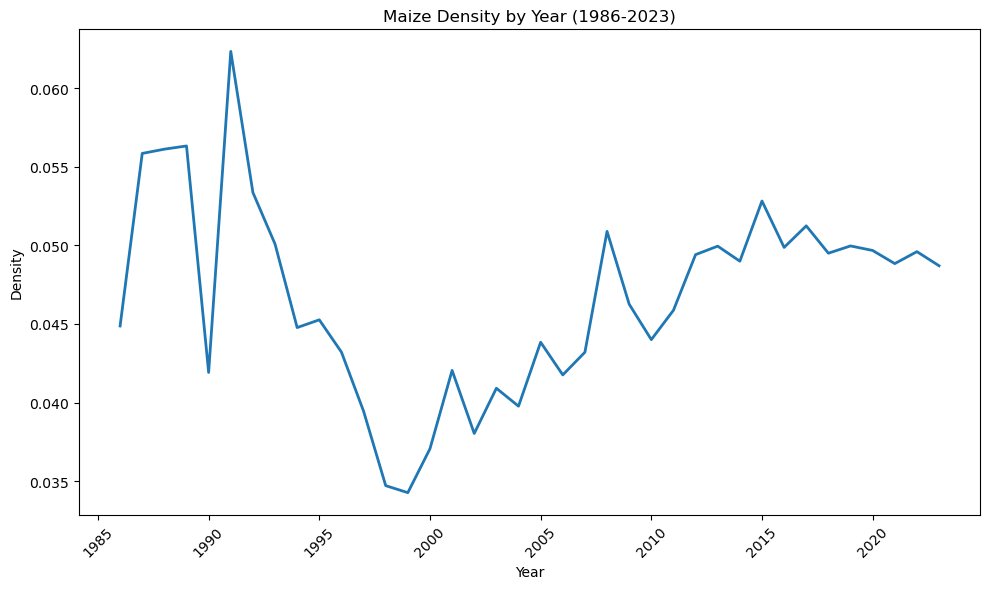

In [37]:
years = list(range(1986, 2024))

plt.figure(figsize=(10, 6))
plt.plot(years, density_maize, linestyle='-', linewidth=2)

plt.title("Maize Density by Year (1986-2023)")
plt.xlabel("Year")
plt.ylabel("Density")
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

## Make Density Plot (Meat of chickens, fresh or chilled) (1986-2023)

### Caluculate Density of Chickens (1986-2023)

In [38]:
density_chicken = []

for i in range(1986, 2024):

    lc_i = lc[lc['Year'] == i]
    
    node_i = node[node['Year'] == i].drop_duplicates(subset='country')

    g_i = nx.from_pandas_edgelist(lc_i,
                                   source='O_name',
                                   target='D_name',
                                   edge_attr='Final Value',
                                   create_using=nx.DiGraph())

    node_attr = node_i.set_index('country').to_dict('index')
    nx.set_node_attributes(g_i, node_attr)

    density_i = nx.density(g_i)
    density_chicken.append(density_i)

print(density_chicken)

[0.09544159544159544, 0.05903271692745377, 0.07560483870967742, 0.07754010695187166, 0.060365853658536583, 0.06464646464646465, 0.06235294117647059, 0.06009783368273934, 0.054098360655737705, 0.06565656565656566, 0.0592896174863388, 0.0442428730099963, 0.04229104229104229, 0.04008438818565401, 0.04828504828504829, 0.05160628844839371, 0.04933463161311263, 0.04584190420217455, 0.0515406162464986, 0.06972972972972973, 0.06143856143856144, 0.06106442577030812, 0.06643356643356643, 0.07543859649122807, 0.06993670886075949, 0.07108081791626096, 0.06683878370625358, 0.06785225718194254, 0.05898989898989899, 0.05797979797979798, 0.054424943988050783, 0.06101010101010101, 0.060026138909634055, 0.05324967824967825, 0.05937266616878267, 0.060714285714285714, 0.05659397715472482, 0.06820175438596492]


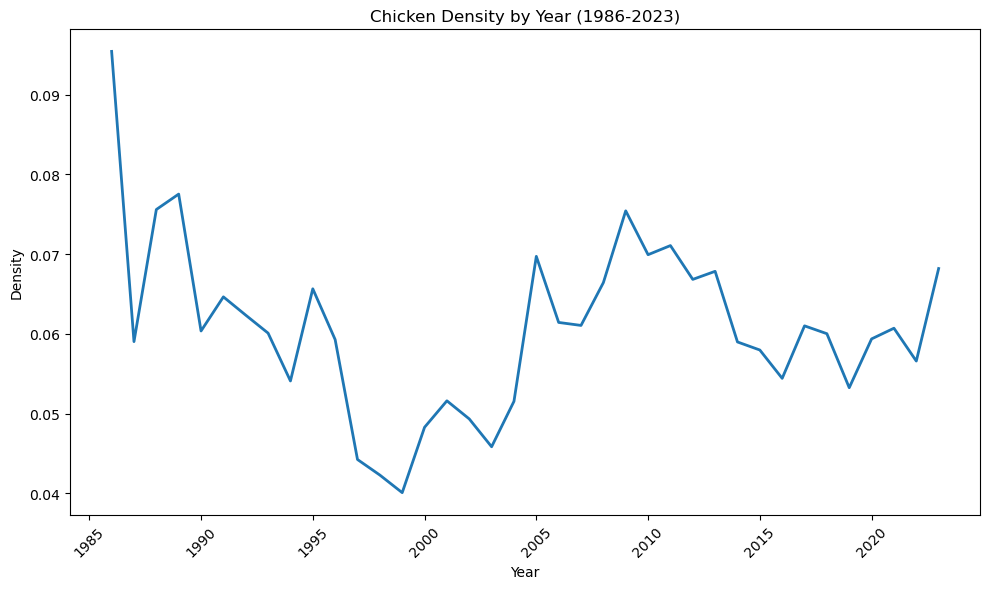

In [39]:
years = list(range(1986, 2024))

plt.figure(figsize=(10, 6))
plt.plot(years, density_chicken, linestyle='-', linewidth=2)

plt.title("Chicken Density by Year (1986-2023)")
plt.xlabel("Year")
plt.ylabel("Density")
plt.xticks(rotation=45)
plt.tight_layout()

plt.show()

In [40]:
years = list(range(1986, 2024))

df_density = pd.DataFrame({
    "Year": years,
    "Maize": density_maize,
    "Chicken": density_chicken
})

df_long = df_density.melt(id_vars="Year", var_name="Item", value_name="Density")
df_long

,Year,Item,Density
0,1986,Maize,0.044872
1,1987,Maize,0.055851
2,1988,Maize,0.056122
3,1989,Maize,0.056327
4,1990,Maize,0.041915
...,...,...,...
71,2019,Chicken,0.053250
72,2020,Chicken,0.059373
73,2021,Chicken,0.060714
74,2022,Chicken,0.056594


In [41]:
import plotly.express as px
density_plot = px.line(
    df_long,
    x="Year",
    y="Density",
    color="Item",  # Maize vs Chicken
    markers=True,
    title="Interactive Network Density Plot of Maize (Corn) & Poultry Meat (1986–2023)",
    hover_data={"Year": False}
)

density_plot.update_layout(
    template="plotly_white",
    width=900,
    height=500,
    hovermode="x" 
)

density_plot.show()


# In-Degree & Out-Degree

## [Maize] In-Degree, Out-Degree Dataframe

In [42]:
density_maize = []

for i in range(1986, 2024):

    lm_i = lm[lm['Year'] == i]
    
    node_i = node[node['Year'] == i].drop_duplicates(subset='country')

    g_i = nx.from_pandas_edgelist(lm_i,
                                   source='O_name',
                                   target='D_name',
                                   edge_attr='Final Value',
                                   create_using=nx.DiGraph())

    node_attr = node_i.set_index('country').to_dict('index')
    nx.set_node_attributes(g_i, node_attr)

    out_degree_dict = dict(g_i.out_degree(weight='Final Value'))
    in_degree_dict = dict(g_i.in_degree(weight='Final Value'))
    
    nx.set_node_attributes(g_i, out_degree_dict, 'i_degree')
    nx.set_node_attributes(g_i, in_degree_dict, 'o_degree')
    
    for country in set(in_degree_dict.keys()).union(out_degree_dict.keys()):
        density_maize.append({
            'Year': i,
            'Country': country,
            'In Degree': in_degree_dict.get(country, 0),
            'Out Degree': out_degree_dict.get(country, 0)
        })
        
    for country in set(in_degree_dict.keys()).union(out_degree_dict.keys()):
        if country in gm.nodes:
            gm.nodes[country]['i_degree'] = in_degree_dict.get(country, 0)
            gm.nodes[country]['o_degree'] = out_degree_dict.get(country, 0)

df_maize_degree = pd.DataFrame(density_maize)
df_maize_degree

,Year,Country,In Degree,Out Degree
0,1986,Sweden,91.00,1376.00
1,1986,Israel,8.00,0.00
2,1986,Hungary,14797.00,29036.00
3,1986,Belgium-Luxembourg,713419.00,1309726.00
4,1986,Norway,0.00,91.00
...,...,...,...,...
3706,2023,Jordan,93.55,0.00
3707,2023,Lithuania,263541.80,126622.24
3708,2023,Canada,3926134.47,4370423.29
3709,2023,"China, mainland",6461880.09,7828223.18


### [Maize] Top 5 Countries of In-Degree & Out-Degree (1986 & 2023)

In [43]:
# 1986
Mtop5_out_1986 = df_maize_degree[df_maize_degree['Year'] == 1986].sort_values('Out Degree', ascending=False).head(5)
Mtop5_in_1986 = df_maize_degree[df_maize_degree['Year'] == 1986].sort_values('In Degree', ascending=False).head(5)

# 2023
Mtop5_out_2023 = df_maize_degree[df_maize_degree['Year'] == 2023].sort_values('Out Degree', ascending=False).head(5)
Mtop5_in_2023 = df_maize_degree[df_maize_degree['Year'] == 2023].sort_values('In Degree', ascending=False).head(5)

In [44]:
# 1986
Mtop5_out_1986 = df_maize_degree[
    (df_maize_degree['Year'] == 1986) &
    (df_maize_degree['Country'] != 'United States of America') &
    (df_maize_degree['Country'] != 'Belgium-Luxembourg')
].sort_values('Out Degree', ascending=False).head(5)[['Country', 'Year', 'Out Degree']]

Mtop5_in_1986 = df_maize_degree[
    (df_maize_degree['Year'] == 1986) &
    (df_maize_degree['Country'] != 'United States of America')
].sort_values('In Degree', ascending=False).head(5)[['Country', 'Year', 'In Degree']]

# 2023
Mtop5_out_2023 = df_maize_degree[
    (df_maize_degree['Year'] == 2023) &
    (df_maize_degree['Country'] != 'United States of America')
].sort_values('Out Degree', ascending=False).head(5)[['Country', 'Year', 'Out Degree']]

Mtop5_in_2023 = df_maize_degree[
    (df_maize_degree['Year'] == 2023) &
    (df_maize_degree['Country'] != 'United States of America')
].sort_values('In Degree', ascending=False).head(5)[['Country', 'Year', 'In Degree']]

In [45]:
Mtop5_out_1986

,Country,Year,Out Degree
20,Netherlands (Kingdom of the),1986,1819169.0
44,Mexico,1986,1393393.0
49,Republic of Korea,1986,1324937.0
11,France,1986,1237978.0
36,Argentina,1986,1087280.0


In [46]:
Mtop5_in_1986

,Country,Year,In Degree
11,France,1986,2987733.0
49,Republic of Korea,1986,1522841.0
44,Mexico,1986,1392236.0
9,Italy,1986,1031307.0
36,Argentina,1986,955659.0


In [47]:
Mtop5_out_2023

,Country,Year,Out Degree
3704,Mexico,2023,17521410.15
3582,Ukraine,2023,14130861.13
3709,"China, mainland",2023,7828223.18
3710,Spain,2023,6260976.56
3583,Italy,2023,6013157.89


In [48]:
Mtop5_in_2023

,Country,Year,In Degree
3704,Mexico,2023,20616040.59
3582,Ukraine,2023,10473328.82
3710,Spain,2023,7175291.99
3583,Italy,2023,6981733.50
3709,"China, mainland",2023,6461880.09


### In-Degree

### Line Graph of Top 5 Countries In-Degree (1986)

In [49]:
Mtop5_in_1986_names = Mtop5_in_1986['Country'].tolist()
Mtop5_in_2023_names = Mtop5_in_2023['Country'].tolist()

In [50]:
Mdf_in_1986 = df_maize_degree[df_maize_degree['Country'].isin(Mtop5_in_1986_names)]
Mdf_in_2023 = df_maize_degree[df_maize_degree['Country'].isin(Mtop5_in_2023_names)]

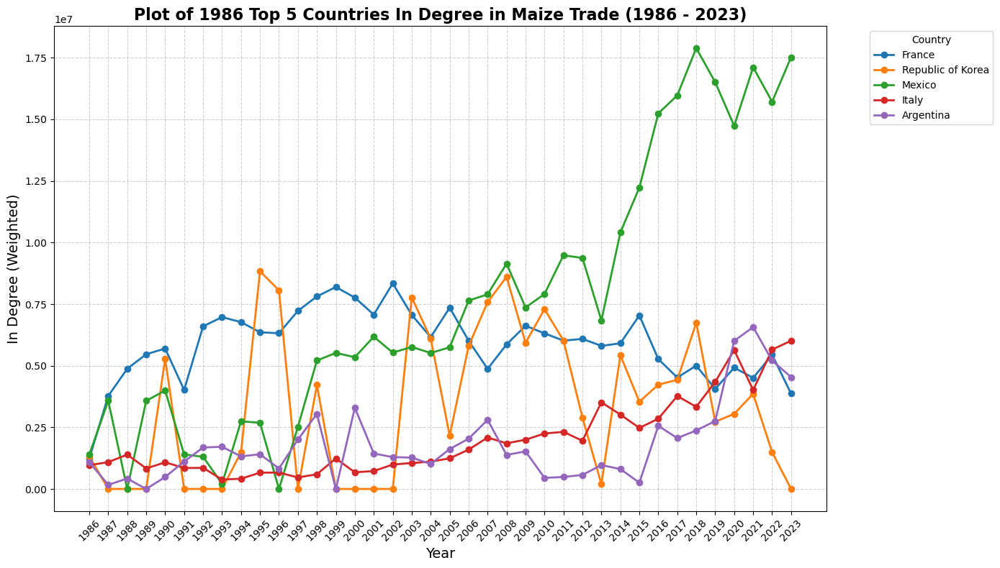

In [51]:
plt.figure(figsize=(14, 8))

for country in Mtop5_in_1986_names:
    df_c = Mdf_in_1986[Mdf_in_1986["Country"] == country]
    plt.plot(df_c["Year"], df_c["Out Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of 1986 Top 5 Countries In Degree in Maize Trade (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Mdf_in_1986["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries In-Degree (1986)

In [52]:
Mdf_in_1986_final = df_maize_degree[
    (df_maize_degree['Country'].isin(Mtop5_in_1986_names)) &
    (df_maize_degree['Year'] == 1986)
][["Year", "Country", "In Degree"]]
Mdf_in_1986_final

,Year,Country,In Degree
9,1986,Italy,1031307.0
11,1986,France,2987733.0
36,1986,Argentina,955659.0
44,1986,Mexico,1392236.0
49,1986,Republic of Korea,1522841.0


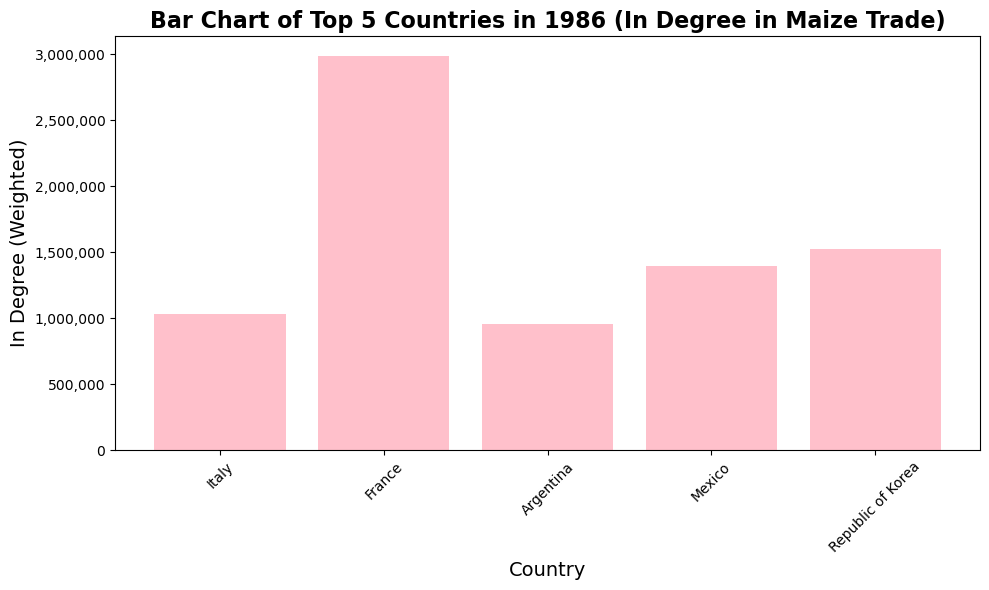

In [53]:
from matplotlib.ticker import FuncFormatter
plt.figure(figsize=(10, 6))
plt.bar(Mdf_in_1986_final["Country"], Mdf_in_1986_final["In Degree"], color='pink')

plt.title("Bar Chart of Top 5 Countries in 1986 (In Degree in Maize Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### Line Graph of Top 5 Countries In-Degree (2023)

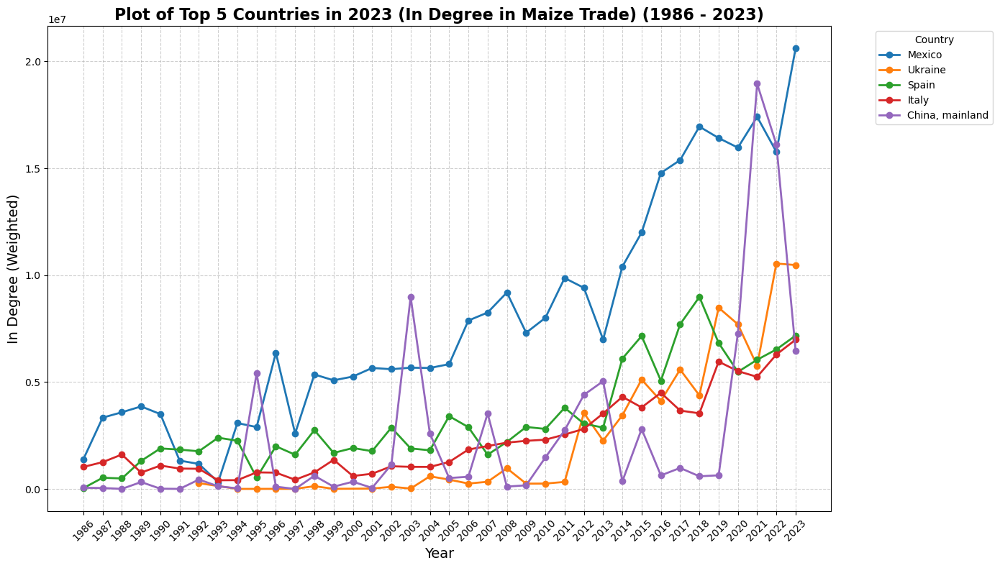

In [54]:
plt.figure(figsize=(14, 8))

for country in Mtop5_in_2023_names:
    df_c = Mdf_in_2023[Mdf_in_2023["Country"] == country]
    plt.plot(df_c["Year"], df_c["In Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of Top 5 Countries in 2023 (In Degree in Maize Trade) (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Mdf_in_2023["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries In-Degree (2023)

In [55]:
Mdf_in_2023_final = df_maize_degree[
    (df_maize_degree['Country'].isin(Mtop5_in_2023_names)) &
    (df_maize_degree['Year'] == 2023)
][["Year", "Country", "In Degree"]]
Mdf_in_2023_final

,Year,Country,In Degree
3582,2023,Ukraine,10473328.82
3583,2023,Italy,6981733.50
3704,2023,Mexico,20616040.59
3709,2023,"China, mainland",6461880.09
3710,2023,Spain,7175291.99


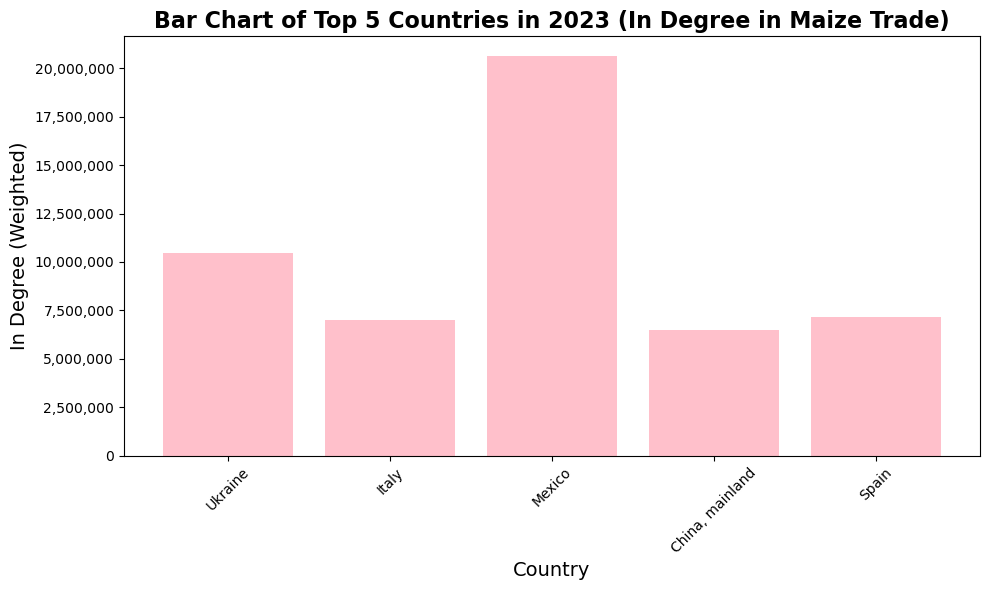

In [56]:
plt.figure(figsize=(10, 6))
plt.bar(Mdf_in_2023_final["Country"], Mdf_in_2023_final["In Degree"], color='pink')

plt.title("Bar Chart of Top 5 Countries in 2023 (In Degree in Maize Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### Out-Degree

### Line Graph of Top 5 Countries Out-Degree (1986)

In [57]:
Mtop5_out_1986_names = Mtop5_out_1986['Country'].tolist()
Mtop5_out_2023_names = Mtop5_out_2023['Country'].tolist()

In [58]:
Mdf_out_1986 = df_maize_degree[df_maize_degree['Country'].isin(Mtop5_out_1986_names)]
Mdf_out_2023 = df_maize_degree[df_maize_degree['Country'].isin(Mtop5_out_2023_names)]

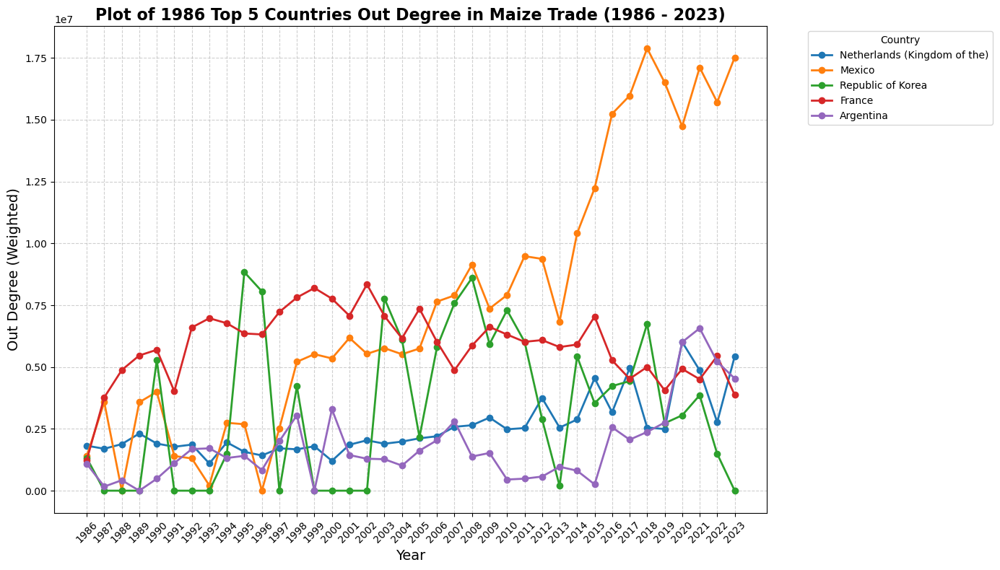

In [59]:
plt.figure(figsize=(14, 8))

for country in Mtop5_out_1986_names:
    df_c = Mdf_out_1986[Mdf_out_1986["Country"] == country]
    plt.plot(df_c["Year"], df_c["Out Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of 1986 Top 5 Countries Out Degree in Maize Trade (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Mdf_out_1986["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries Out-Degree (1986)

In [60]:
Mdf_out_1986_final = df_maize_degree[
    (df_maize_degree['Country'].isin(Mtop5_out_1986_names)) &
    (df_maize_degree['Year'] == 1986)
][["Year", "Country", "Out Degree"]]
Mdf_out_1986_final

,Year,Country,Out Degree
11,1986,France,1237978.0
20,1986,Netherlands (Kingdom of the),1819169.0
36,1986,Argentina,1087280.0
44,1986,Mexico,1393393.0
49,1986,Republic of Korea,1324937.0


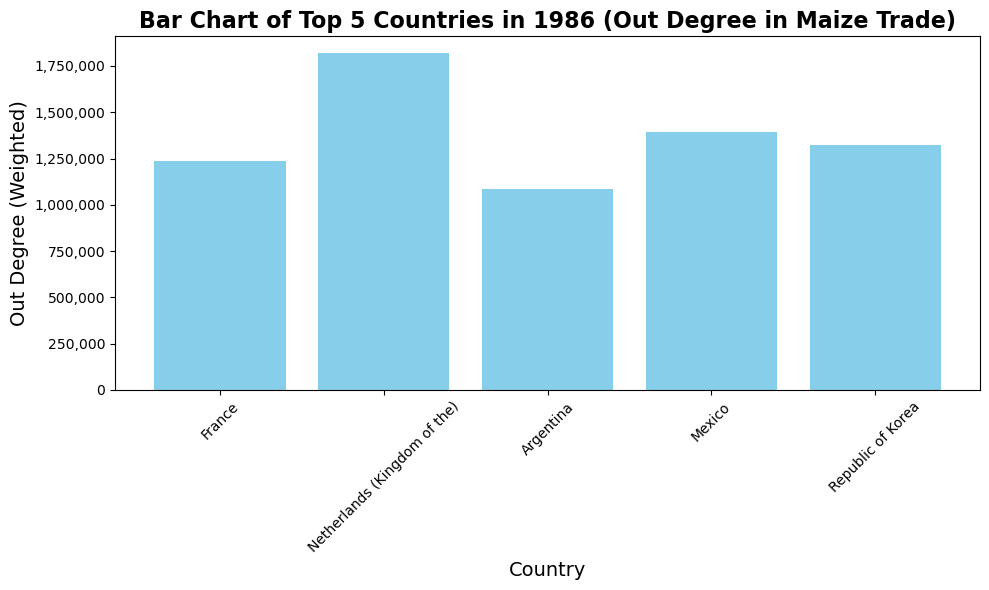

In [61]:
from matplotlib.ticker import FuncFormatter

plt.figure(figsize=(10, 6))
plt.bar(Mdf_out_1986_final["Country"], Mdf_out_1986_final["Out Degree"], color='skyblue')

plt.title("Bar Chart of Top 5 Countries in 1986 (Out Degree in Maize Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### Line Graph of Top 5 Countries Out-Degree (2023)

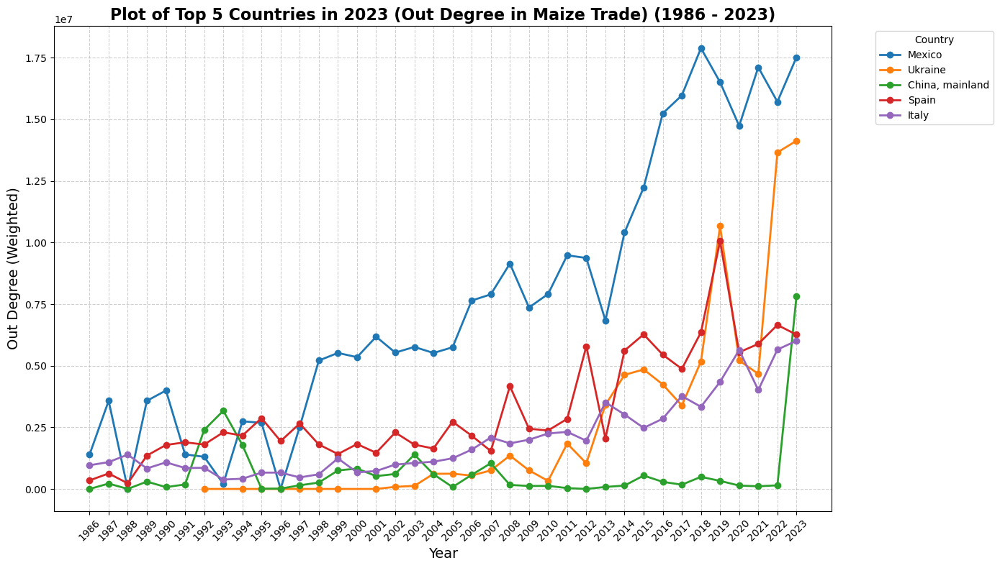

In [62]:
plt.figure(figsize=(14, 8))

for country in Mtop5_out_2023_names:
    df_c = Mdf_out_2023[Mdf_out_2023["Country"] == country]
    plt.plot(df_c["Year"], df_c["Out Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of Top 5 Countries in 2023 (Out Degree in Maize Trade) (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Mdf_out_2023["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries Out-Degree (2023)

In [63]:
Mdf_out_2023_final = df_maize_degree[
    (df_maize_degree['Country'].isin(Mtop5_out_2023_names)) &
    (df_maize_degree['Year'] == 2023)
][["Year", "Country", "Out Degree"]]
Mdf_out_2023_final

,Year,Country,Out Degree
3582,2023,Ukraine,14130861.13
3583,2023,Italy,6013157.89
3704,2023,Mexico,17521410.15
3709,2023,"China, mainland",7828223.18
3710,2023,Spain,6260976.56


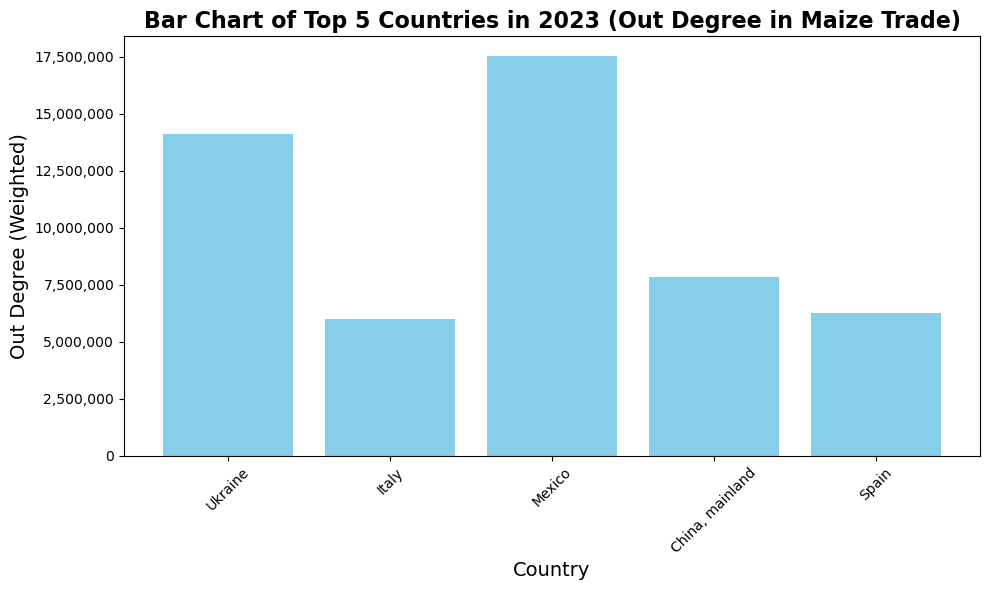

In [64]:
plt.figure(figsize=(10, 6))
plt.bar(Mdf_out_2023_final["Country"], Mdf_out_2023_final["Out Degree"], color='skyblue')

plt.title("Bar Chart of Top 5 Countries in 2023 (Out Degree in Maize Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### [Maize] Comparison of In/Out Degree of Top5 (1986 & 2023)

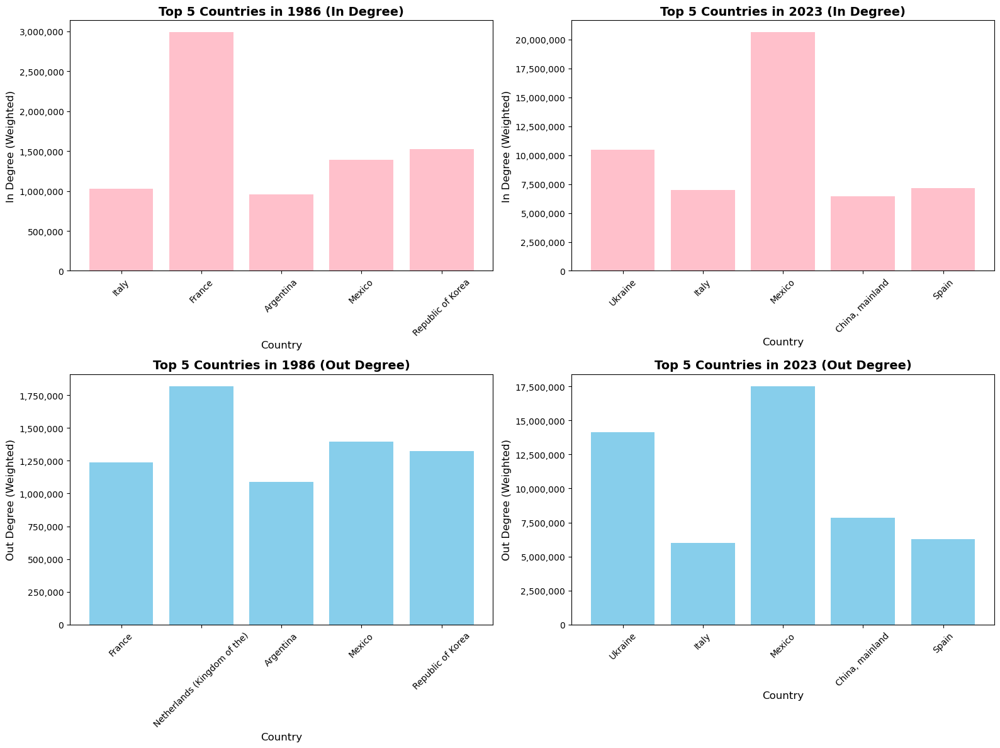

In [65]:
fig, axes = plt.subplots(2, 2, figsize=(16, 12))
formatter = FuncFormatter(lambda x, _: f'{int(x):,}')

# In Degree 1986
axes[0, 0].bar(Mdf_in_1986_final["Country"], Mdf_in_1986_final["In Degree"], color='pink')
axes[0, 0].set_title("Top 5 Countries in 1986 (In Degree)", fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel("Country", fontsize=12)
axes[0, 0].set_ylabel("In Degree (Weighted)", fontsize=12)
axes[0, 0].tick_params(axis='x', rotation=45)
axes[0, 0].yaxis.set_major_formatter(formatter)

# In Degree 2023
axes[0, 1].bar(Mdf_in_2023_final["Country"], Mdf_in_2023_final["In Degree"], color='pink')
axes[0, 1].set_title("Top 5 Countries in 2023 (In Degree)", fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel("Country", fontsize=12)
axes[0, 1].set_ylabel("In Degree (Weighted)", fontsize=12)
axes[0, 1].tick_params(axis='x', rotation=45)
axes[0, 1].yaxis.set_major_formatter(formatter)

# Out Degree 1986
axes[1, 0].bar(Mdf_out_1986_final["Country"], Mdf_out_1986_final["Out Degree"], color='skyblue')
axes[1, 0].set_title("Top 5 Countries in 1986 (Out Degree)", fontsize=14, fontweight='bold')
axes[1, 0].set_xlabel("Country", fontsize=12)
axes[1, 0].set_ylabel("Out Degree (Weighted)", fontsize=12)
axes[1, 0].tick_params(axis='x', rotation=45)
axes[1, 0].yaxis.set_major_formatter(formatter)

# Out Degree 2023
axes[1, 1].bar(Mdf_out_2023_final["Country"], Mdf_out_2023_final["Out Degree"], color='skyblue')
axes[1, 1].set_title("Top 5 Countries in 2023 (Out Degree)", fontsize=14, fontweight='bold')
axes[1, 1].set_xlabel("Country", fontsize=12)
axes[1, 1].set_ylabel("Out Degree (Weighted)", fontsize=12)
axes[1, 1].tick_params(axis='x', rotation=45)
axes[1, 1].yaxis.set_major_formatter(formatter)

plt.tight_layout()
plt.show()

## [Chicken] In-Degree, Out-Degree Dataframe

In [66]:
density_chicken = []

for i in range(1986, 2024):

    lc_i = lc[lc['Year'] == i]
    
    node_i = node[node['Year'] == i].drop_duplicates(subset='country')

    g_i = nx.from_pandas_edgelist(lc_i,
                                   source='O_name',
                                   target='D_name',
                                   edge_attr='Final Value',
                                   create_using=nx.DiGraph())

    node_attr = node_i.set_index('country').to_dict('index')
    nx.set_node_attributes(g_i, node_attr)

    out_degree_dict = dict(g_i.out_degree(weight='Final Value'))
    in_degree_dict = dict(g_i.in_degree(weight='Final Value'))
    
    nx.set_node_attributes(g_i, out_degree_dict, 'i_degree')
    nx.set_node_attributes(g_i, in_degree_dict, 'o_degree')
    
    for country in set(in_degree_dict.keys()).union(out_degree_dict.keys()):
        density_chicken.append({
            'Year': i,
            'Country': country,
            'In Degree': in_degree_dict.get(country, 0),
            'Out Degree': out_degree_dict.get(country, 0)
        })
        
    for country in set(in_degree_dict.keys()).union(out_degree_dict.keys()):
        if country in gc.nodes:
            gc.nodes[country]['i_degree'] = in_degree_dict.get(country, 0)
            gc.nodes[country]['o_degree'] = out_degree_dict.get(country, 0)

df_chicken_degree = pd.DataFrame(density_chicken)
df_chicken_degree

,Year,Country,In Degree,Out Degree
0,1986,Sweden,179.00,0.00
1,1986,Switzerland,7369.00,0.00
2,1986,Belgium-Luxembourg,24014.00,24066.00
3,1986,Egypt,100.00,0.00
4,1986,Singapore,0.00,7646.00
...,...,...,...,...
2881,2023,Latvia,35122.19,39492.87
2882,2023,Lithuania,52999.29,54533.98
2883,2023,Canada,132092.26,135697.83
2884,2023,"China, mainland",257878.91,206414.74


### [Chicken] Top 5 Countries of In-Degree & Out-Degree (1986 & 2023)

In [67]:
# 1986
Ctop5_out_1986 = df_chicken_degree[df_chicken_degree['Year'] == 1986].sort_values('Out Degree', ascending=False).head(5)
Ctop5_in_1986 = df_chicken_degree[df_chicken_degree['Year'] == 1986].sort_values('In Degree', ascending=False).head(5)

# 2023
Ctop5_out_2023 = df_chicken_degree[df_chicken_degree['Year'] == 2023].sort_values('Out Degree', ascending=False).head(5)
Ctop5_in_2023 = df_chicken_degree[df_chicken_degree['Year'] == 2023].sort_values('In Degree', ascending=False).head(5)

In [68]:
# 1986
Ctop5_out_1986 = df_chicken_degree[
    (df_chicken_degree['Year'] == 1986) 
].sort_values('Out Degree', ascending=False).head(5)[['Country', 'Year', 'Out Degree']]

Ctop5_in_1986 = df_chicken_degree[
    (df_chicken_degree['Year'] == 1986) &
    (df_chicken_degree['Country'] != 'Belgium-Luxembourg')
].sort_values('In Degree', ascending=False).head(5)[['Country', 'Year', 'In Degree']]

# 2023
Ctop5_out_2023 = df_chicken_degree[
    (df_chicken_degree['Year'] == 2023) 
].sort_values('Out Degree', ascending=False).head(5)[['Country', 'Year', 'Out Degree']]

Ctop5_in_2023 = df_chicken_degree[
    (df_chicken_degree['Year'] == 2023) 
].sort_values('In Degree', ascending=False).head(5)[['Country', 'Year', 'In Degree']]

In [69]:
Ctop5_out_1986

,Country,Year,Out Degree
9,France,1986,93300.0
15,United Kingdom of Great Britain and Northern I...,1986,88365.0
18,Netherlands (Kingdom of the),1986,57217.0
2,Belgium-Luxembourg,1986,24066.0
11,"China, Hong Kong SAR",1986,23213.0


In [70]:
Ctop5_in_1986

,Country,Year,In Degree
15,United Kingdom of Great Britain and Northern I...,1986,89542.0
9,France,1986,73617.0
18,Netherlands (Kingdom of the),1986,57489.0
23,United States of America,1986,20552.0
21,Canada,1986,16989.0


In [71]:
Ctop5_out_2023

,Country,Year,Out Degree
2847,Netherlands (Kingdom of the),2023,1085135.66
2829,United States of America,2023,877350.39
2877,Mexico,2023,755331.80
2859,Poland,2023,717236.58
2803,Germany,2023,528492.15


In [72]:
Ctop5_in_2023

,Country,Year,In Degree
2829,United States of America,2023,1001880.06
2847,Netherlands (Kingdom of the),2023,977716.28
2852,Brazil,2023,950782.09
2859,Poland,2023,917280.63
2877,Mexico,2023,706925.71


### In-Degree

### Line Graph of Top 5 Countries In-Degree (1986)

In [73]:
Ctop5_in_1986_names = Ctop5_in_1986['Country'].tolist()
Ctop5_in_2023_names = Ctop5_in_2023['Country'].tolist()

In [74]:
Cdf_in_1986 = df_chicken_degree[df_chicken_degree['Country'].isin(Ctop5_in_1986_names)]
Cdf_in_2023 = df_chicken_degree[df_chicken_degree['Country'].isin(Ctop5_in_2023_names)]

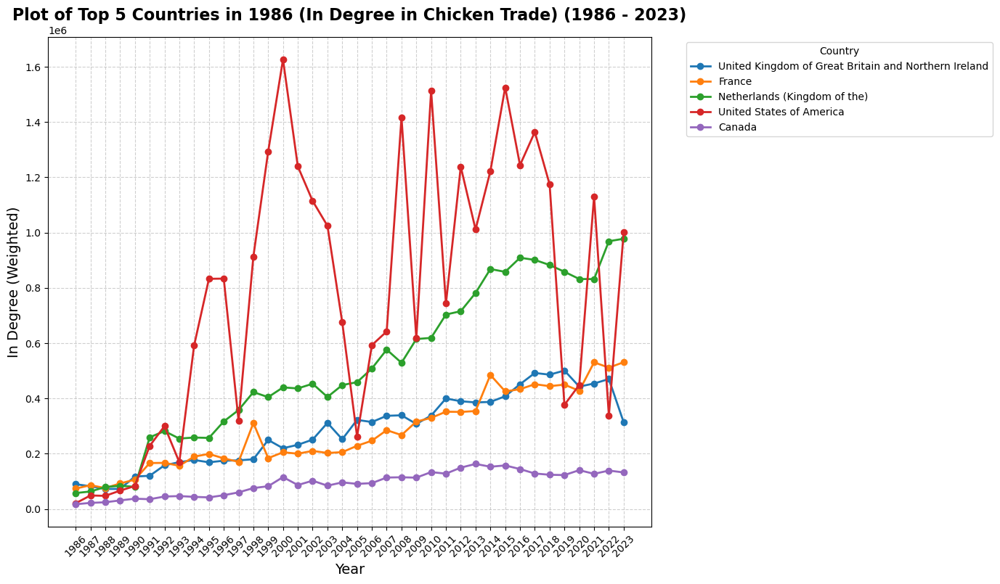

In [75]:
plt.figure(figsize=(14, 8))

for country in Ctop5_in_1986_names:
    df_c = Cdf_in_1986[Cdf_in_1986["Country"] == country]
    plt.plot(df_c["Year"], df_c["In Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of Top 5 Countries in 1986 (In Degree in Chicken Trade) (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Cdf_in_1986["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries In-Degree (1986)

In [76]:
Cdf_in_1986_final = df_chicken_degree[
    (df_chicken_degree['Country'].isin(Ctop5_in_1986_names)) &
    (df_chicken_degree['Year'] == 1986)
][["Year", "Country", "In Degree"]]
Cdf_in_1986_final

,Year,Country,In Degree
9,1986,France,73617.0
15,1986,United Kingdom of Great Britain and Northern I...,89542.0
18,1986,Netherlands (Kingdom of the),57489.0
21,1986,Canada,16989.0
23,1986,United States of America,20552.0


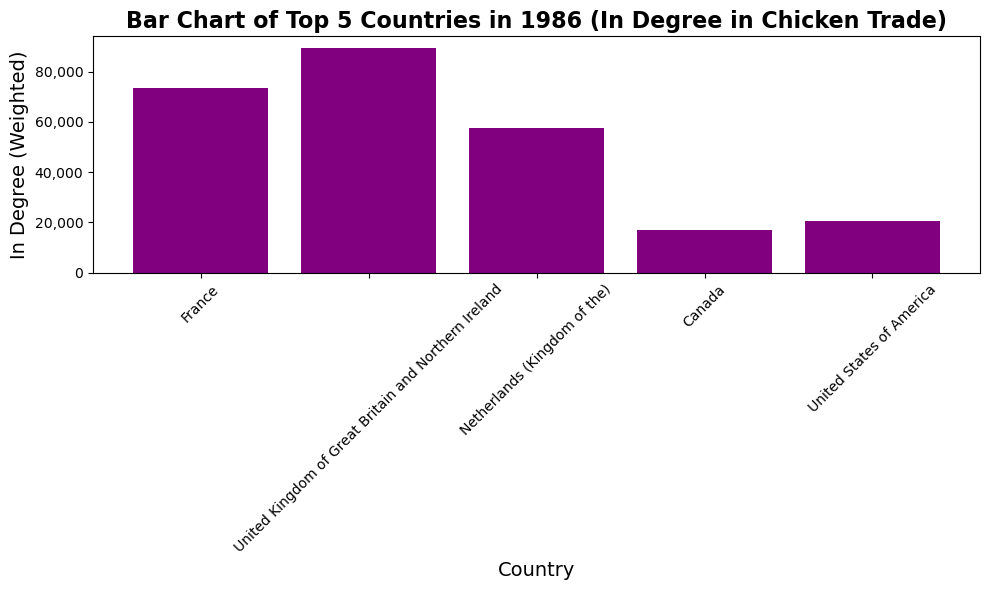

In [77]:
plt.figure(figsize=(10, 6))
plt.bar(Cdf_in_1986_final["Country"], Cdf_in_1986_final["In Degree"], color='purple')

plt.title("Bar Chart of Top 5 Countries in 1986 (In Degree in Chicken Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### Line Graph of Top 5 Countries In-Degree (2023)

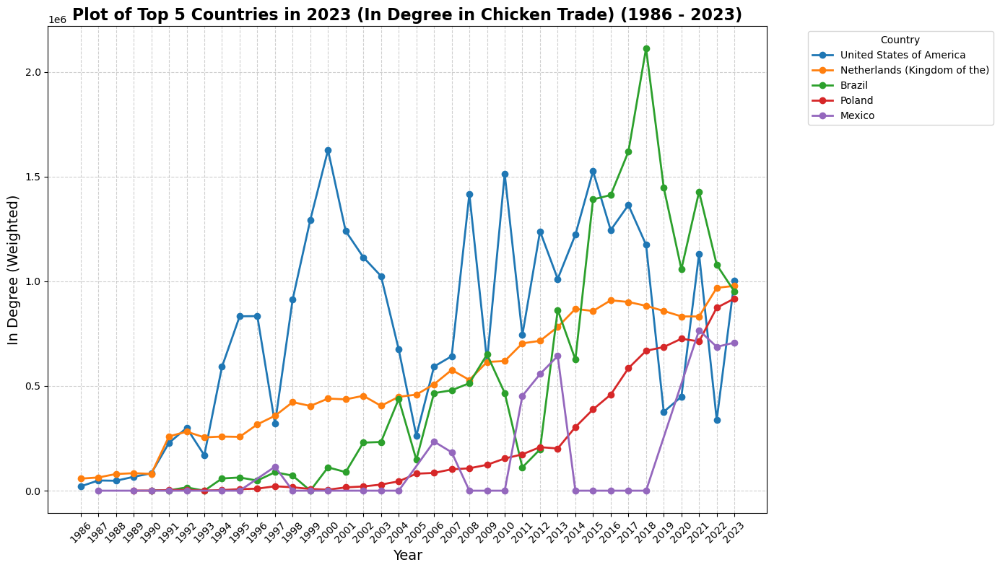

In [78]:
plt.figure(figsize=(14, 8))

for country in Ctop5_in_2023_names:
    df_c = Cdf_in_2023[Cdf_in_2023["Country"] == country]
    plt.plot(df_c["Year"], df_c["In Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of Top 5 Countries in 2023 (In Degree in Chicken Trade) (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Cdf_in_2023["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries In-Degree (2023)

In [79]:
Cdf_in_2023_final = df_chicken_degree[
    (df_chicken_degree['Country'].isin(Ctop5_in_1986_names)) &
    (df_chicken_degree['Year'] == 2023)
][["Year", "Country", "In Degree"]]
Cdf_in_2023_final

,Year,Country,In Degree
2799,2023,France,530976.63
2802,2023,United Kingdom of Great Britain and Northern I...,313270.66
2829,2023,United States of America,1001880.06
2847,2023,Netherlands (Kingdom of the),977716.28
2883,2023,Canada,132092.26


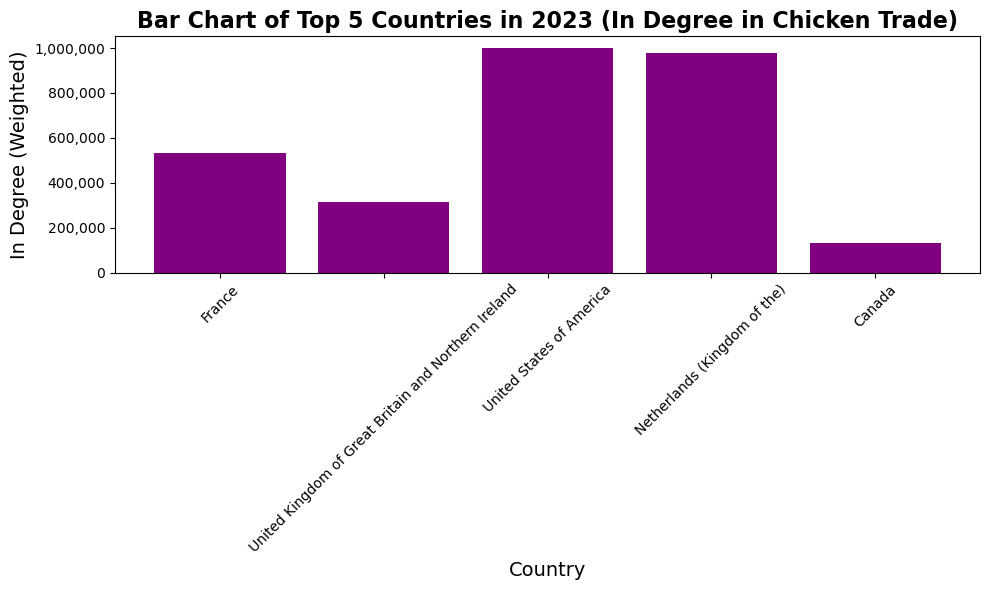

In [80]:
plt.figure(figsize=(10, 6))
plt.bar(Cdf_in_2023_final["Country"], Cdf_in_2023_final["In Degree"], color='purple')

plt.title("Bar Chart of Top 5 Countries in 2023 (In Degree in Chicken Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("In Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### Out-Degree

### Line Graph of Top 5 Countries Out-Degree (1986)

In [81]:
Ctop5_out_1986_names = Ctop5_out_1986['Country'].tolist()
Ctop5_out_2023_names = Ctop5_out_2023['Country'].tolist()

In [82]:
Cdf_out_1986 = df_chicken_degree[df_chicken_degree['Country'].isin(Ctop5_out_1986_names)]
Cdf_out_2023 = df_chicken_degree[df_chicken_degree['Country'].isin(Ctop5_out_2023_names)]

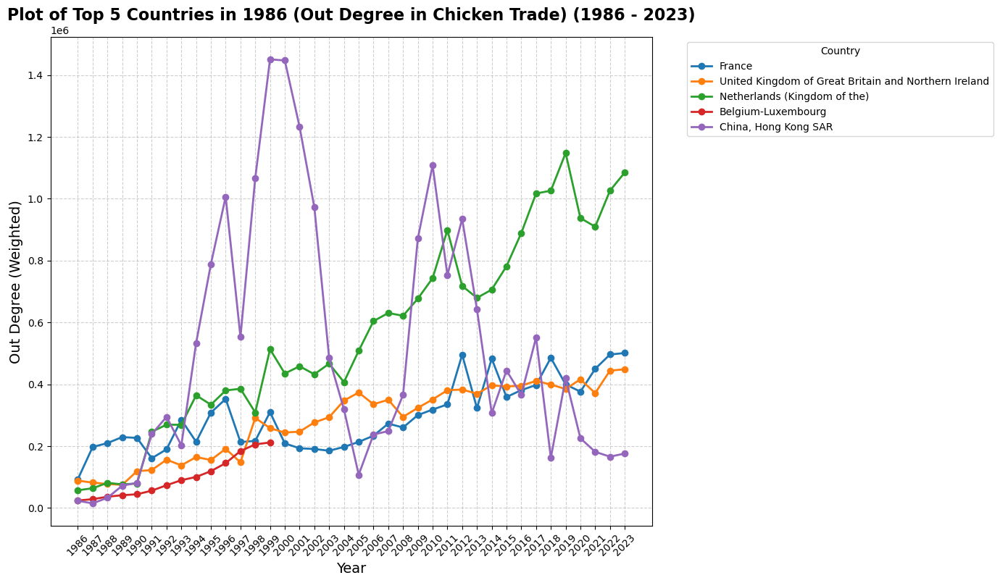

In [83]:
plt.figure(figsize=(14, 8))

for country in Ctop5_out_1986_names:
    df_c = Cdf_out_1986[Cdf_out_1986["Country"] == country]
    plt.plot(df_c["Year"], df_c["Out Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of Top 5 Countries in 1986 (Out Degree in Chicken Trade) (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Cdf_out_1986["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries Out-Degree (1986)

In [84]:
Cdf_out_1986_final = df_chicken_degree[
    (df_chicken_degree['Country'].isin(Ctop5_out_1986_names)) &
    (df_chicken_degree['Year'] == 1986)
][["Year", "Country", "Out Degree"]]
Cdf_out_1986_final

,Year,Country,Out Degree
2,1986,Belgium-Luxembourg,24066.0
9,1986,France,93300.0
11,1986,"China, Hong Kong SAR",23213.0
15,1986,United Kingdom of Great Britain and Northern I...,88365.0
18,1986,Netherlands (Kingdom of the),57217.0


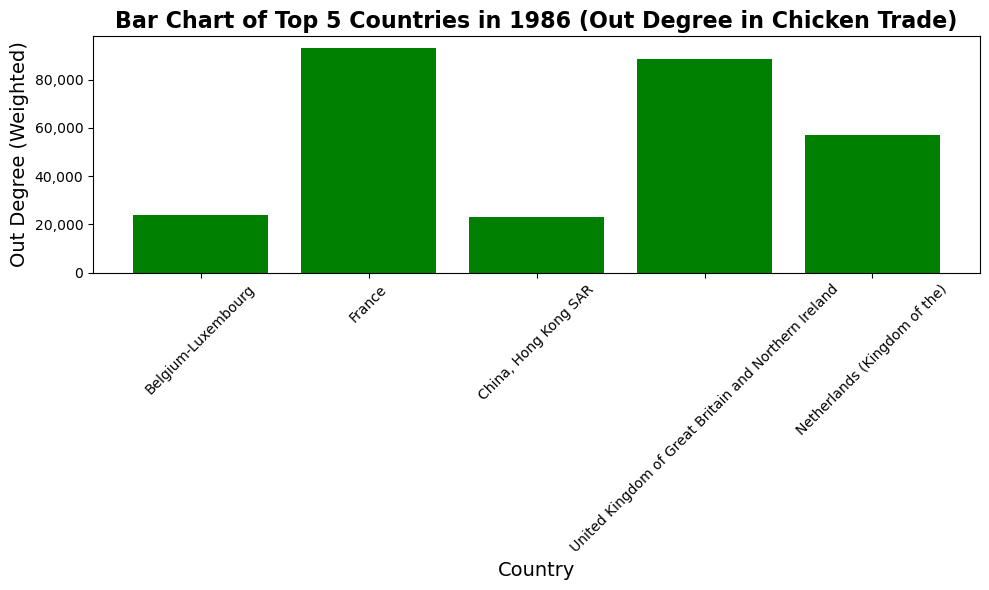

In [85]:
plt.figure(figsize=(10, 6))
plt.bar(Cdf_out_1986_final["Country"], Cdf_out_1986_final["Out Degree"], color='green')

plt.title("Bar Chart of Top 5 Countries in 1986 (Out Degree in Chicken Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

### Line Graph of Top 5 Countries Out-Degree (2023)

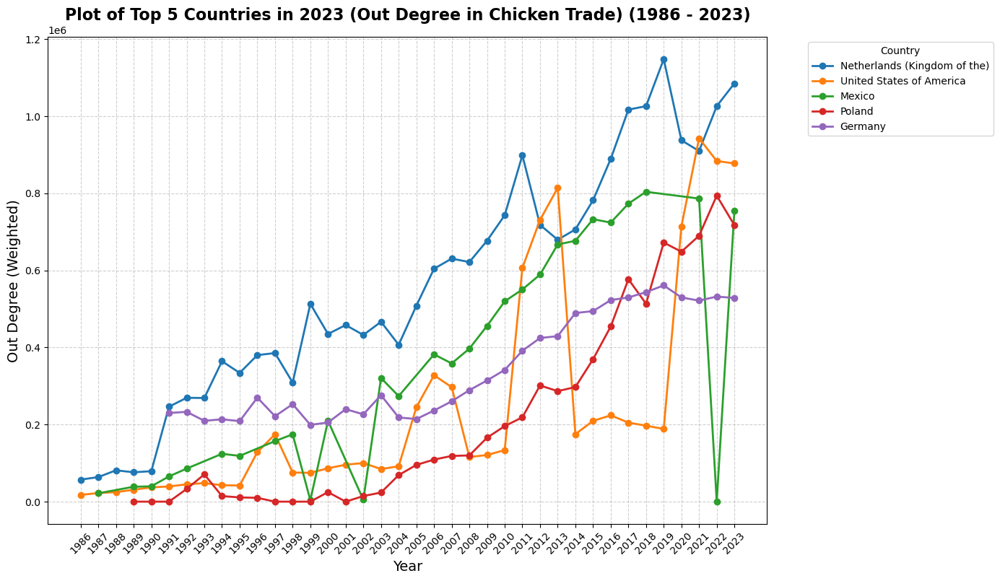

In [86]:
plt.figure(figsize=(14, 8))

for country in Ctop5_out_2023_names:
    df_c = Cdf_out_2023[Cdf_out_2023["Country"] == country]
    plt.plot(df_c["Year"], df_c["Out Degree"], label=country, marker='o', linewidth=2)

plt.title("Plot of Top 5 Countries in 2023 (Out Degree in Chicken Trade) (1986 - 2023)", fontsize=16, fontweight='bold')
plt.xlabel("Year", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(sorted(Cdf_out_2023["Year"].unique()), rotation=45)
plt.legend(title="Country", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.grid(True, linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()

### Bar Chart of Top 5 Countries Out-Degree (2023)

In [87]:
Cdf_out_2023_final = df_chicken_degree[
    (df_chicken_degree['Country'].isin(Ctop5_out_2023_names)) &
    (df_chicken_degree['Year'] == 2023)
][["Year", "Country", "Out Degree"]]
Cdf_out_2023_final

,Year,Country,Out Degree
2803,2023,Germany,528492.15
2829,2023,United States of America,877350.39
2847,2023,Netherlands (Kingdom of the),1085135.66
2859,2023,Poland,717236.58
2877,2023,Mexico,755331.80


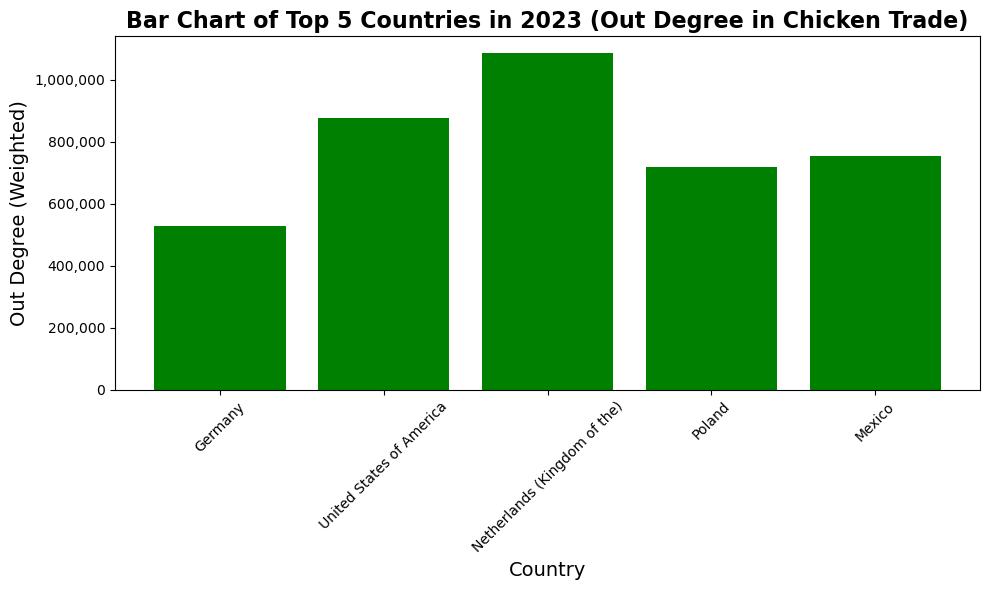

In [88]:
plt.figure(figsize=(10, 6))
plt.bar(Cdf_out_2023_final["Country"], Cdf_out_2023_final["Out Degree"], color='green')

plt.title("Bar Chart of Top 5 Countries in 2023 (Out Degree in Chicken Trade)", fontsize=16, fontweight='bold')
plt.xlabel("Country", fontsize=14)
plt.ylabel("Out Degree (Weighted)", fontsize=14)
plt.xticks(rotation=45)

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

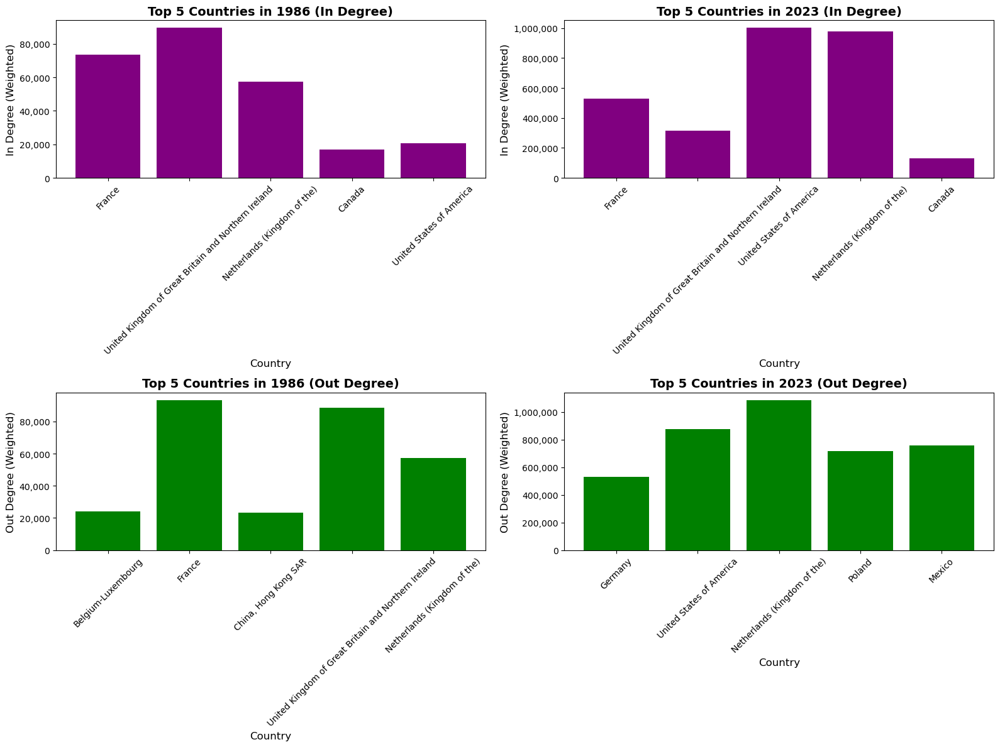

In [89]:
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# In Degree 1986
axes[0, 0].bar(Cdf_in_1986_final["Country"], Cdf_in_1986_final["In Degree"], color='purple')
axes[0, 0].set_title("Top 5 Countries in 1986 (In Degree)", fontsize=14, fontweight='bold')
axes[0, 0].set_xlabel("Country", fontsize=12)
axes[0, 0].set_ylabel("In Degree (Weighted)", fontsize=12)
axes[0, 0].tick_params(axis='x', rotation=45)
axes[0, 0].yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

# In Degree 2023
axes[0, 1].bar(Cdf_in_2023_final["Country"], Cdf_in_2023_final["In Degree"], color='purple')
axes[0, 1].set_title("Top 5 Countries in 2023 (In Degree)", fontsize=14, fontweight='bold')
axes[0, 1].set_xlabel("Country", fontsize=12)
axes[0, 1].set_ylabel("In Degree (Weighted)", fontsize=12)
axes[0, 1].tick_params(axis='x', rotation=45)
axes[0, 1].yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

# Out Degree 1986
axes[1, 0].bar(Cdf_out_1986_final["Country"], Cdf_out_1986_final["Out Degree"], color='green')
axes[1, 0].set_title("Top 5 Countries in 1986 (Out Degree)", fontsize=14, fontweight='bold')
axes[1, 0].set_xlabel("Country", fontsize=12)
axes[1, 0].set_ylabel("Out Degree (Weighted)", fontsize=12)
axes[1, 0].tick_params(axis='x', rotation=45)
axes[1, 0].yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

# Out Degree 2023
axes[1, 1].bar(Cdf_out_2023_final["Country"], Cdf_out_2023_final["Out Degree"], color='green')
axes[1, 1].set_title("Top 5 Countries in 2023 (Out Degree)", fontsize=14, fontweight='bold')
axes[1, 1].set_xlabel("Country", fontsize=12)
axes[1, 1].set_ylabel("Out Degree (Weighted)", fontsize=12)
axes[1, 1].tick_params(axis='x', rotation=45)
axes[1, 1].yaxis.set_major_formatter(FuncFormatter(lambda x, _: f'{int(x):,}'))

plt.tight_layout()
plt.show()

# [Maize] Betweenness Centrality

In [90]:
betweenness_maize = nx.betweenness_centrality(gm, weight='Final Value') 

nx.set_node_attributes(gm, betweenness_maize, 'betweenness')

top20_betweenness = sorted(betweenness_maize.items(), key=itemgetter(1), reverse=True)[:20]

print("Top 20 nodes by betweenness centrality:")
for country, value in top20_betweenness:
    print(f"{country}: {value}")

Top 20 nodes by betweenness centrality:
Chile: 0.4011693575177729
Thailand: 0.3415387681881602
France: 0.25463424357185566
Canada: 0.22868912364626934
Philippines: 0.17839346222842334
Australia: 0.17357650654441564
Netherlands (Kingdom of the): 0.17218125041525478
Kenya: 0.1518503753903395
United Kingdom of Great Britain and Northern Ireland: 0.14859477775563085
China, mainland: 0.12497508471197925
United Arab Emirates: 0.11271676300578033
Zimbabwe: 0.11152082918078532
Belgium: 0.11062387881203906
Switzerland: 0.10268420702943325
United States of America: 0.1020530197329081
Singapore: 0.10098996744402365
TÃ¼rkiye: 0.1001926782273603
India: 0.07770247824064845
Lebanon: 0.07580891635107301
Lithuania: 0.06594246229486413


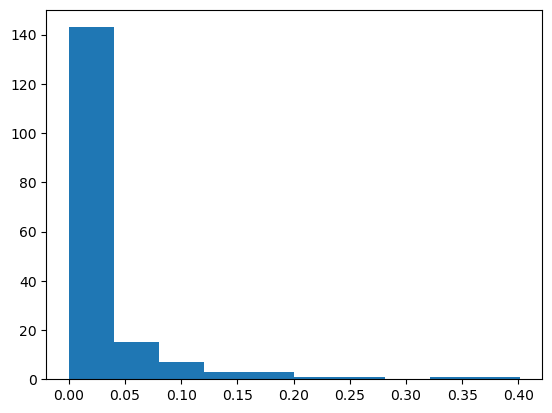

In [91]:
maize_histogram = plt.hist(betweenness_maize.values())

## [Maize] Community Detection

In [92]:
communities = community.greedy_modularity_communities(gm)

In [93]:
modularity_maize = {}

for i, c in enumerate(communities):
    for name in c:
        modularity_maize[name] = i

nx.set_node_attributes(gm, modularity_maize, 'modularity')

In [94]:
print(modularity_maize)

{'Afghanistan': 0, 'Bahamas': 0, 'Nepal': 0, 'Philippines': 0, 'Chile': 0, 'Sierra Leone': 0, 'Bhutan': 0, 'Dominican Republic': 0, 'Japan': 0, 'Papua New Guinea': 0, 'Guatemala': 0, 'Nicaragua': 0, 'India': 0, 'Thailand': 0, 'New Zealand': 0, 'Brunei Darussalam': 0, 'Panama': 0, 'Ecuador': 0, 'Eswatini': 0, 'Antigua and Barbuda': 0, 'Belize': 0, 'Brazil': 0, 'China, Taiwan Province of': 0, 'Puerto Rico': 0, 'El Salvador': 0, 'Colombia': 0, 'Indonesia': 0, 'Paraguay': 0, 'Venezuela (Bolivarian Republic of)': 0, 'Viet Nam': 0, 'Singapore': 0, 'Bolivia (Plurinational State of)': 0, 'Argentina': 0, 'Sri Lanka': 0, "Lao People's Democratic Republic": 0, 'Honduras': 0, 'Haiti': 0, 'China, Hong Kong SAR': 0, 'Peru': 0, 'South Africa': 0, "Democratic People's Republic of Korea": 0, 'Uruguay': 0, 'China, Macao SAR': 0, 'Tonga': 0, 'Australia': 0, 'Lesotho': 0, 'Fiji': 0, 'Mexico': 0, 'Saint Kitts and Nevis': 0, 'Malaysia': 0, 'Costa Rica': 0, 'Myanmar': 0, 'Canada': 0, 'China, mainland': 0, 'U

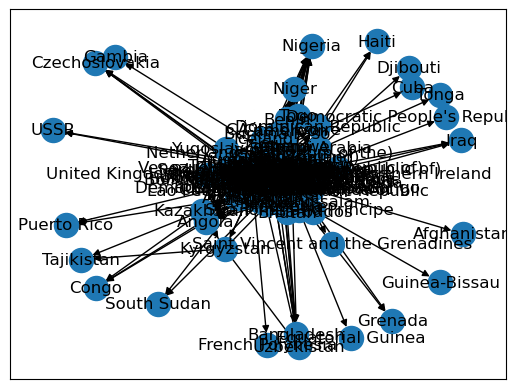

In [95]:
nx.draw_networkx(gm, with_labels=True)

# [Chicken] Betweenness Centrality

In [96]:
betweenness_chicken = nx.betweenness_centrality(gc, weight='Final Value') 

nx.set_node_attributes(gc, betweenness_chicken, 'betweenness')

top20_betweenness = sorted(betweenness_chicken.items(), key=itemgetter(1), reverse=True)[:20]

print("Top 20 nodes by betweenness centrality:")
for country, value in top20_betweenness:
    print(f"{country}: {value}")

Top 20 nodes by betweenness centrality:
France: 0.22578620300043936
Sweden: 0.1516226225597891
Spain: 0.14606741573033707
Norway: 0.14321134894231372
TÃ¼rkiye: 0.14154792542841
Germany: 0.11615717782938922
Singapore: 0.1042935157868307
United Kingdom of Great Britain and Northern Ireland: 0.10209654133450505
United Arab Emirates: 0.10150021969744523
Ireland: 0.09095474232628208
China, mainland: 0.08678049086686333
Italy: 0.0840185801267968
Austria: 0.07814951980415541
Hungary: 0.07733350072186303
United States of America: 0.0760780867491055
Malaysia: 0.06543845332998556
Switzerland: 0.06342979097357353
Belgium: 0.06167221141171301
Latvia: 0.06004017324712824
South Africa: 0.05897307137028435


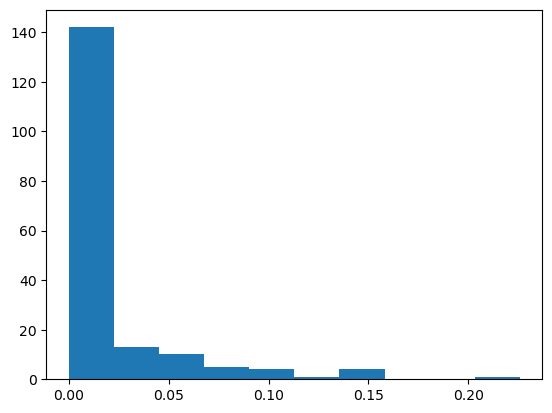

In [97]:
chicken_histogram = plt.hist(betweenness_chicken.values())

## [Chicken] Community Detection

In [98]:
communities_chicken = community.greedy_modularity_communities(gc)

In [99]:
modularity_chicken = {}

for i, c in enumerate(communities_chicken):
    for name in c:
        modularity_chicken[name] = i

nx.set_node_attributes(gc, modularity_chicken, 'modularity')

In [100]:
print(modularity_chicken)

{'Guyana': 0, 'Samoa': 0, 'Afghanistan': 0, 'Bahamas': 0, 'Philippines': 0, 'Chile': 0, 'Grenada': 0, 'Dominican Republic': 0, 'Japan': 0, 'Dominica': 0, 'United Arab Emirates': 0, 'Jamaica': 0, 'Guatemala': 0, 'Mauritius': 0, 'Nicaragua': 0, 'Thailand': 0, 'New Zealand': 0, 'Brunei Darussalam': 0, 'Trinidad and Tobago': 0, 'Vanuatu': 0, 'Tunisia': 0, 'Antigua and Barbuda': 0, 'Ecuador': 0, 'Brazil': 0, 'Seychelles': 0, 'China, Taiwan Province of': 0, 'Djibouti': 0, 'El Salvador': 0, 'Colombia': 0, 'Maldives': 0, 'Indonesia': 0, 'Paraguay': 0, 'Venezuela (Bolivarian Republic of)': 0, 'Viet Nam': 0, 'Singapore': 0, 'Argentina': 0, "Lao People's Democratic Republic": 0, 'Sri Lanka': 0, 'Iran (Islamic Republic of)': 0, 'China, Hong Kong SAR': 0, 'Honduras': 0, 'Peru': 0, 'Uruguay': 0, 'China, Macao SAR': 0, 'Tonga': 0, 'Cambodia': 0, 'Suriname': 0, 'Australia': 0, 'Fiji': 0, 'Mexico': 0, 'Saint Kitts and Nevis': 0, 'Malaysia': 0, 'Costa Rica': 0, 'Myanmar': 0, 'Canada': 0, 'United States 

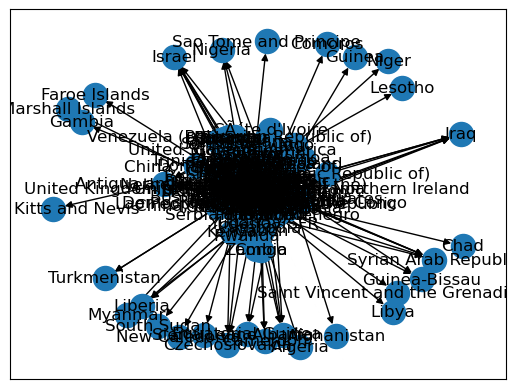

In [101]:
nx.draw_networkx(gc, with_labels=True)

In [102]:
gc.nodes(data = True)

NodeDataView({'Benin': {'country_code': 53, 'Year': 1970, 'population': 3065.057, 'GDP_total': 162.90109660000002, 'GDP_per_capita': 106.12035599999999, 'Area harvested': 49443.53333333333, 'Producing Animals/Slaughtered': 135283.68421052632, 'Production': 47921.493295454544, 'i_degree': 0, 'o_degree': 4888.57, 'betweenness': 0.01431171928943569, 'modularity': 1}, 'Australia': {'country_code': 10, 'Year': 1970, 'population': 12599.411, 'GDP_total': 23171.6575682, 'GDP_per_capita': 3570.2966109999998, 'Area harvested': 279869.0853658537, 'Producing Animals/Slaughtered': 10931666.869565217, 'Production': 685306.3551923076, 'i_degree': 0, 'o_degree': 88.18, 'betweenness': 0.038478438265017886, 'modularity': 0}, 'Seychelles': {'country_code': 196, 'Year': 1970, 'population': 54.252, 'GDP_total': 11.0565308, 'GDP_per_capita': 408.7653965, 'Area harvested': 1622.875, 'Producing Animals/Slaughtered': 1179.4375, 'Production': 968.5355319148936, 'i_degree': 0.6, 'o_degree': 0, 'betweenness': 0.

# [Maize] Fitting Power-Law Distribution

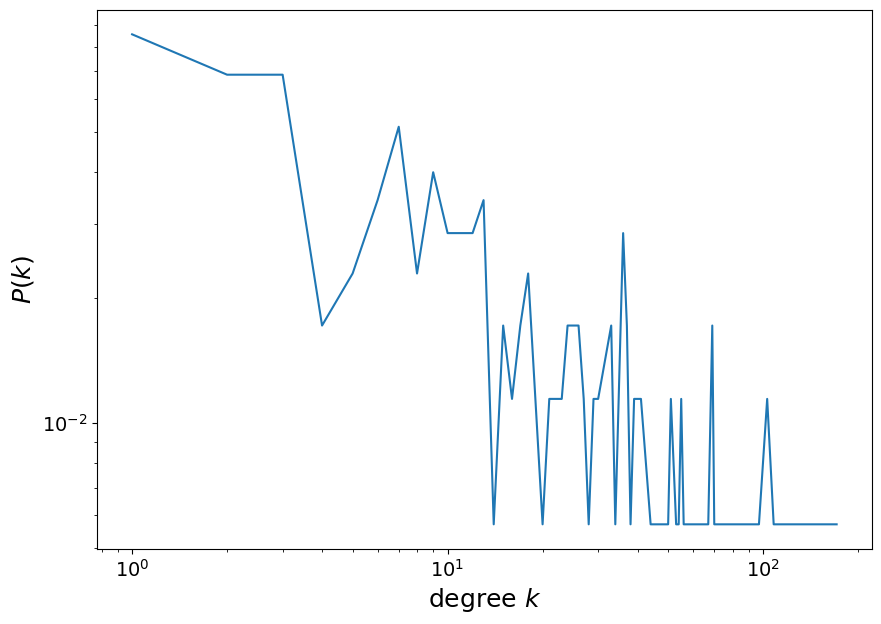

In [103]:
M_deg=dict(gm.degree()).values()
M_deg_distri=Counter(M_deg)

x=[]
y=[]
for i in sorted(M_deg_distri):   
    x.append(i)
    y.append(M_deg_distri[i]/len(gm))

plt.figure(figsize=(10,7))    
plt.plot(x,y)

plt.xlabel('degree $k$', fontsize=18)
plt.ylabel('$P(k)$', fontsize=18)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.yscale('log')
plt.xscale('log')
#plt.axis([1,1000,0.00001,0.2])

In [104]:
M_degree=list(M_deg)
M_pwl_distri=pwl.pdf(M_degree, bins=90)

In [105]:
M_fit_function = pwl.Fit(M_degree)
M_fit_function_fixmin = pwl.Fit(M_degree, xmin=10)

Calculating best minimal value for power law fit


Text(0, 0.5, '$P(k)$')

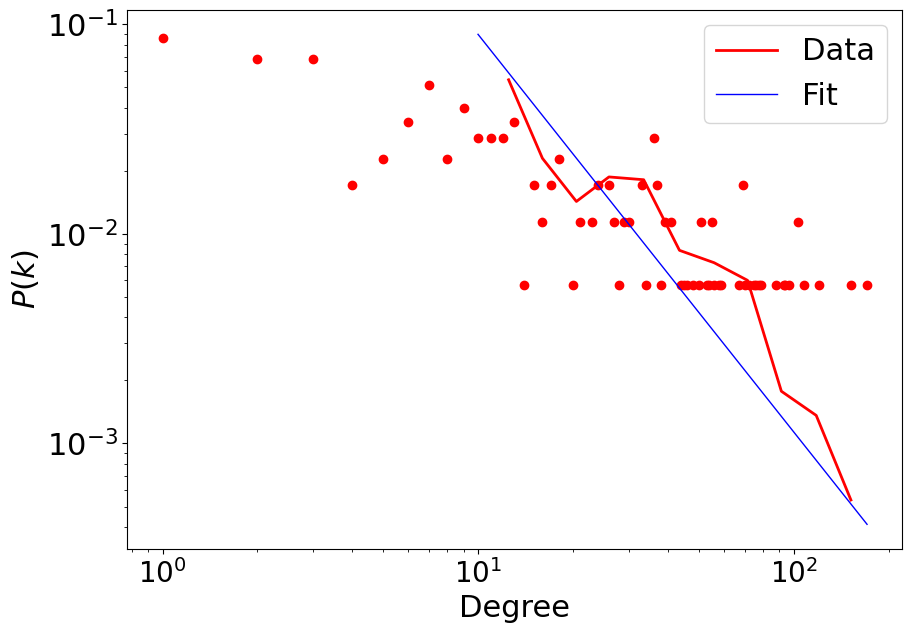

In [106]:
fig=plt.figure(figsize=(10,7))

plt.plot(x,y,'ro')

fig=pwl.plot_pdf([x for x in M_degree if x>10], color='r', linewidth=2, label='Data')

M_fit_function_fixmin.power_law.plot_pdf(ax=fig, color='b', linestyle='-', linewidth=1, label='Fit')

fig.legend(fontsize=22)
plt.xticks(fontsize=20)
plt.yticks(fontsize=22)
plt.xlabel('Degree', fontsize=22)
plt.ylabel('$P(k)$', fontsize=22)

Text(0, 0.5, '$P(k)$')

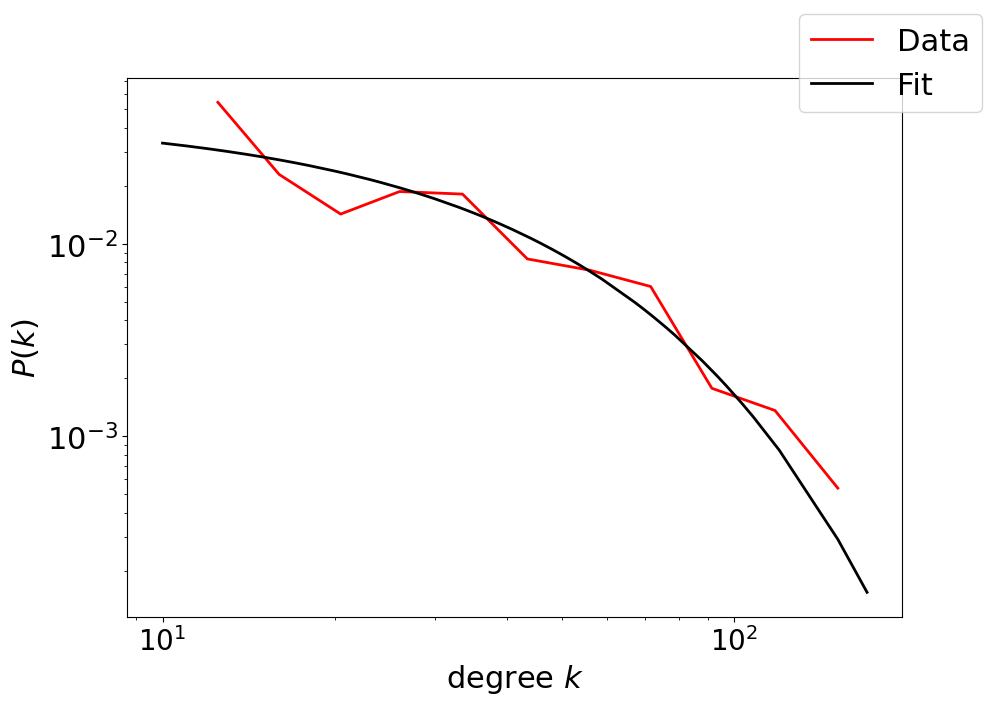

In [107]:
R,p = M_fit_function.distribution_compare('power_law', 'exponential', normalized_ratio=True)
fig=plt.figure(figsize=(10,7))

M_fig=pwl.plot_pdf([x for x in M_degree if x>10], color='r', linewidth=2, label='Data')

M_fit_function_fixmin.exponential.plot_pdf(ax=M_fig, color='black', linestyle='-', linewidth=2, label='Fit')

fig.legend(fontsize=22)

plt.xticks(fontsize=20)
plt.yticks(fontsize=22)
plt.xlabel('degree $k$', fontsize=22)
plt.ylabel('$P(k)$', fontsize=22)

# [Chicken] Fitting Power-Law Distribution

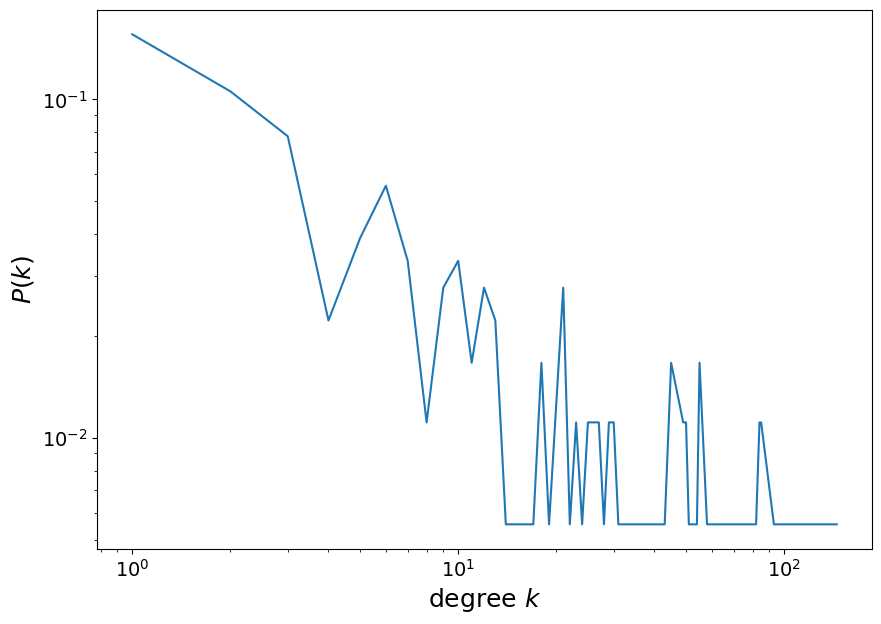

In [108]:
C_deg=dict(gc.degree()).values()
C_deg_distri=Counter(C_deg)

x=[]
y=[]
for i in sorted(C_deg_distri):   
    x.append(i)
    y.append(C_deg_distri[i]/len(gc))

plt.figure(figsize=(10,7))    
plt.plot(x,y)

plt.xlabel('degree $k$', fontsize=18)
plt.ylabel('$P(k)$', fontsize=18)

plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

plt.yscale('log')
plt.xscale('log')

In [109]:
C_degree=list(C_deg)
C_pwl_distri=pwl.pdf(C_degree, bins=90)

In [110]:
C_fit_function = pwl.Fit(C_degree)
C_fit_function_fixmin = pwl.Fit(C_degree, xmin=10)

Calculating best minimal value for power law fit


Text(0, 0.5, '$P(k)$')

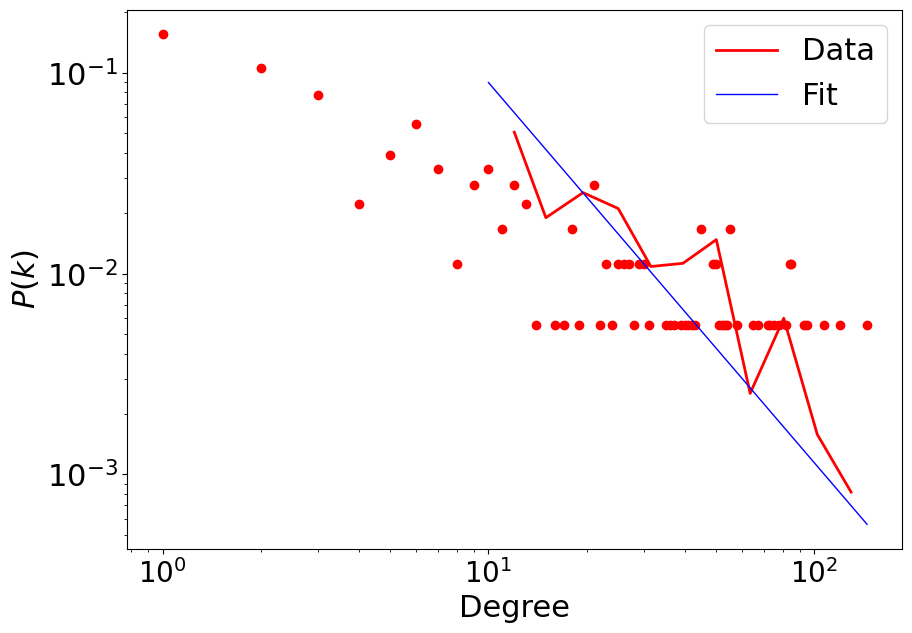

In [111]:
fig=plt.figure(figsize=(10,7))

plt.plot(x,y,'ro')

fig=pwl.plot_pdf([x for x in C_degree if x>10], color='r', linewidth=2, label='Data')

C_fit_function_fixmin.power_law.plot_pdf(ax=fig, color='b', linestyle='-', linewidth=1, label='Fit')

fig.legend(fontsize=22)
plt.xticks(fontsize=20)
plt.yticks(fontsize=22)
plt.xlabel('Degree', fontsize=22)
plt.ylabel('$P(k)$', fontsize=22)

Text(0, 0.5, '$P(k)$')

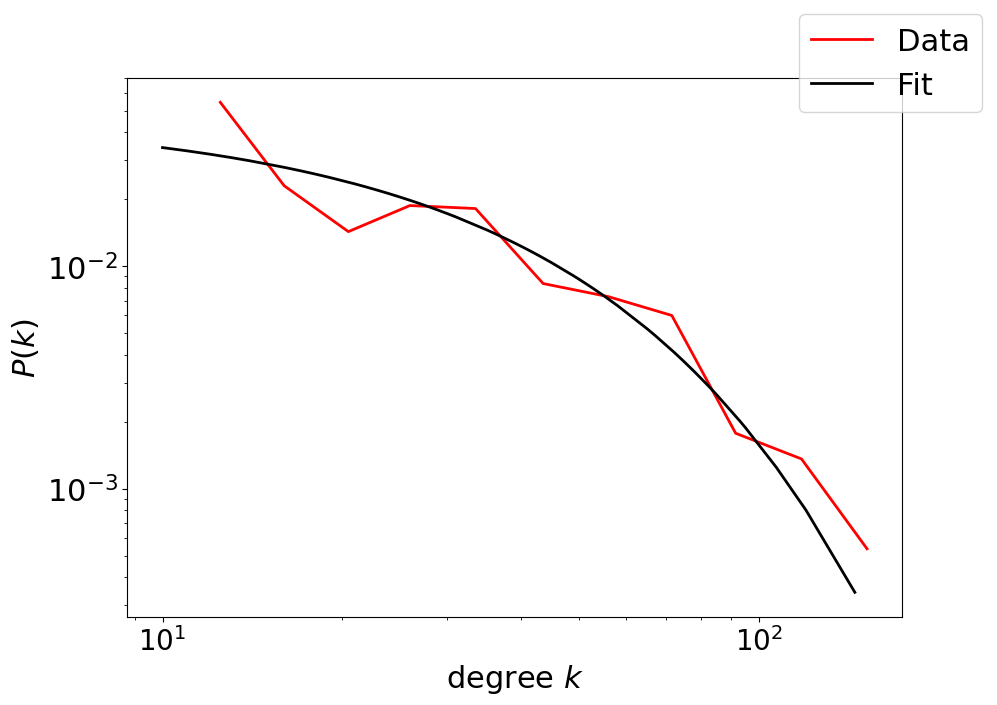

In [112]:
R,p = C_fit_function.distribution_compare('power_law', 'exponential', normalized_ratio=True)
fig=plt.figure(figsize=(10,7))

C_fig=pwl.plot_pdf([x for x in M_degree if x>10], color='r', linewidth=2, label='Data')

C_fit_function_fixmin.exponential.plot_pdf(ax=C_fig, color='black', linestyle='-', linewidth=2, label='Fit')

fig.legend(fontsize=22)

plt.xticks(fontsize=20)
plt.yticks(fontsize=22)
plt.xlabel('degree $k$', fontsize=22)
plt.ylabel('$P(k)$', fontsize=22)

# [Maize] Network Visualization

## All Countries Network Visualization (Size = Betweenness, Color = Modularity)

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/1784320834.py:4: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



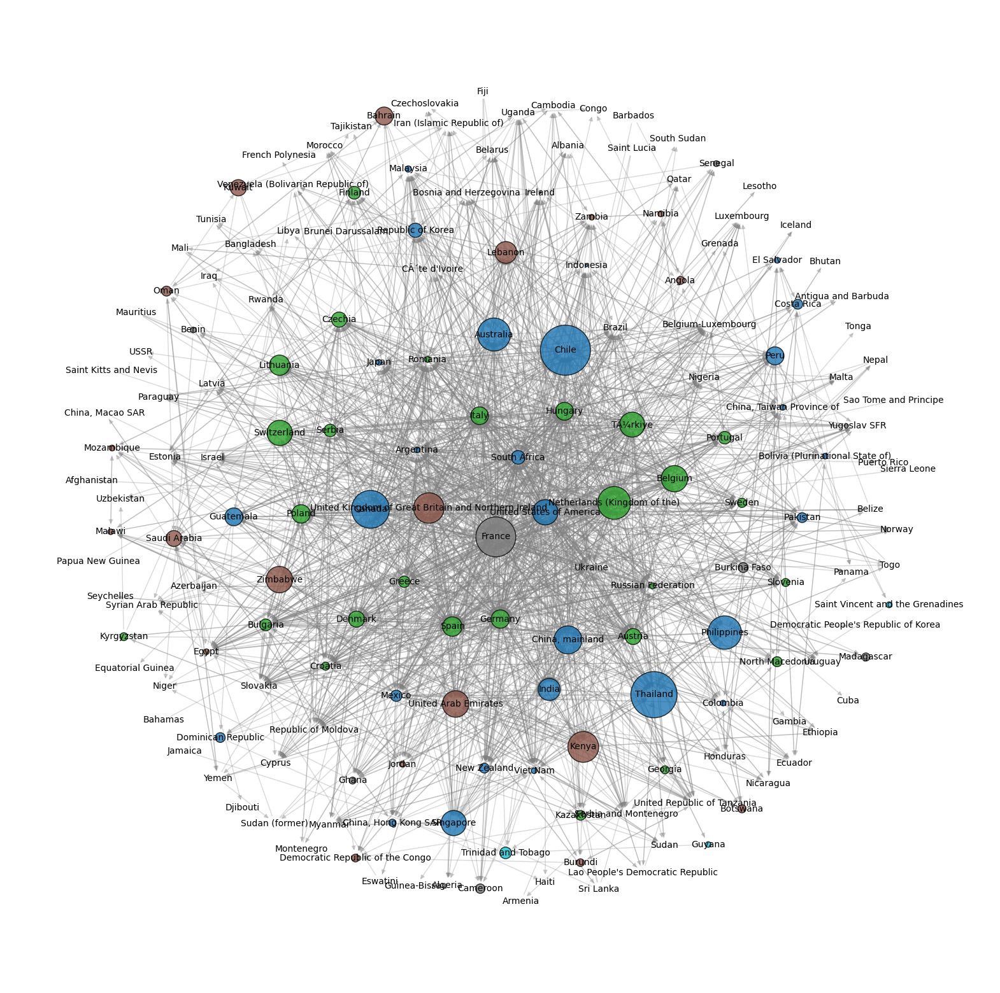

In [113]:
node_sizes = [8000 * gm.nodes[node]['betweenness'] for node in gm.nodes()]  
node_colors = [gm.nodes[node]['modularity'] for node in gm.nodes()] 

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)  
plt.figure(figsize=(20, 20))
#pos = nx.spring_layout(gm, seed=42, k=1.2, iterations=200)  
pos = nx.arf_layout(gm, pos=None, scaling=1, a=1.1, etol=1e-06, dt=0.001, max_iter=1000)

nx.draw_networkx_nodes(gm, pos, 
                       node_size=node_sizes, 
                       node_color=node_colors, 
                       cmap=cmap, 
                       alpha=0.8, 
                       edgecolors='black')

nx.draw_networkx_edges(gm, pos, alpha=0.3, edge_color='gray')

nx.draw_networkx_labels(gm, pos, font_size=10)

plt.axis("off")
plt.show()

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/3517295711.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



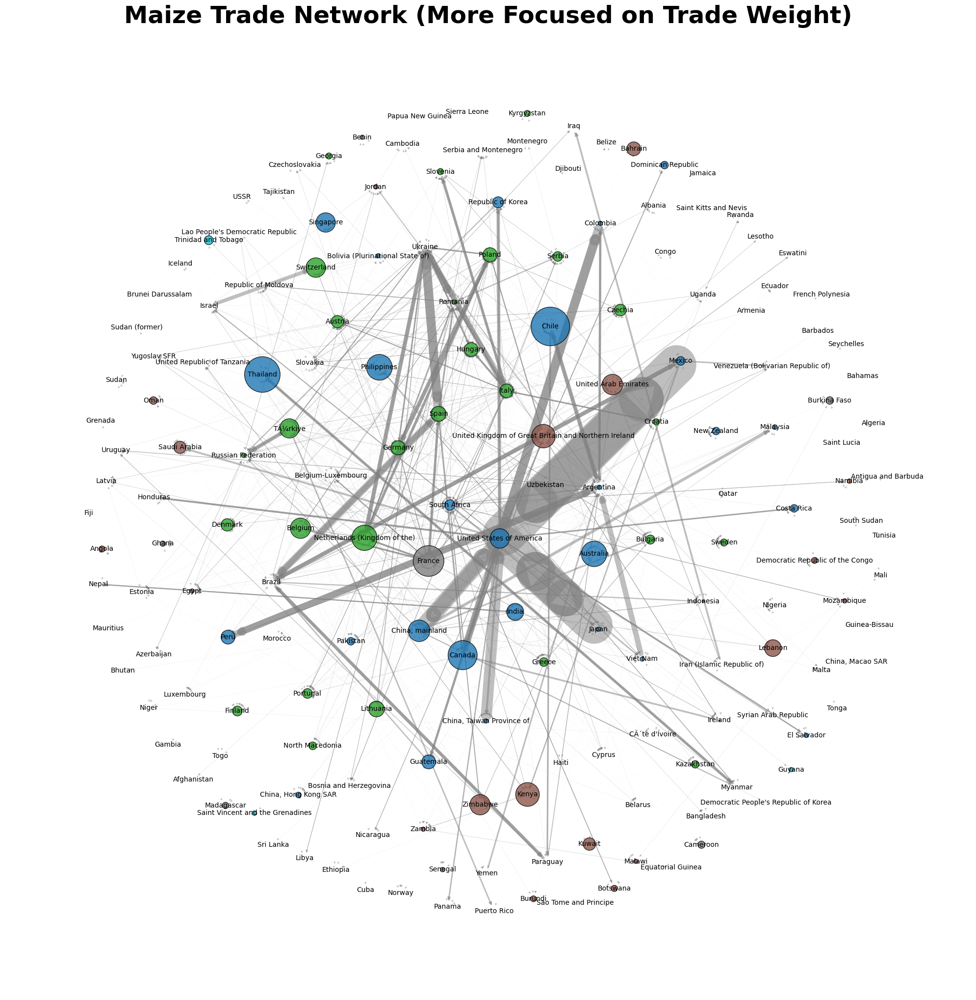

In [114]:
node_sizes = [8000 * gm.nodes[node]['betweenness'] for node in gm.nodes()]  
node_colors = [gm.nodes[node]['modularity'] for node in gm.nodes()] 

edge_weights = [gm[u][v]['Final Value'] for u, v in gm.edges()]
edge_widths = [w / 300000 for w in edge_weights]  


cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)  
plt.figure(figsize=(20, 20))
pos = nx.arf_layout(gm, pos=None, scaling=1, a=1.1, etol=1e-06, dt=0.001, max_iter=1000)

nx.draw_networkx_nodes(gm, pos, 
                       node_size=node_sizes, 
                       node_color=node_colors, 
                       cmap=cmap, 
                       alpha=0.8, 
                       edgecolors='black')

nx.draw_networkx_edges(
    gm, pos,
    arrows=True,
    arrowstyle='-|>',
    arrowsize=8,
    edge_color='gray',
    width=edge_widths,
    alpha=0.5
)

nx.draw_networkx_labels(gm, pos, font_size=10)

plt.axis("off")
plt.tight_layout()
plt.title("Maize Trade Network (More Focused on Trade Weight)", fontsize = 35, fontweight='bold')
plt.show()

## Top50 Countries with highest Betweenness (Size = Betweenness, Color = Modularity)

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/3345877468.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



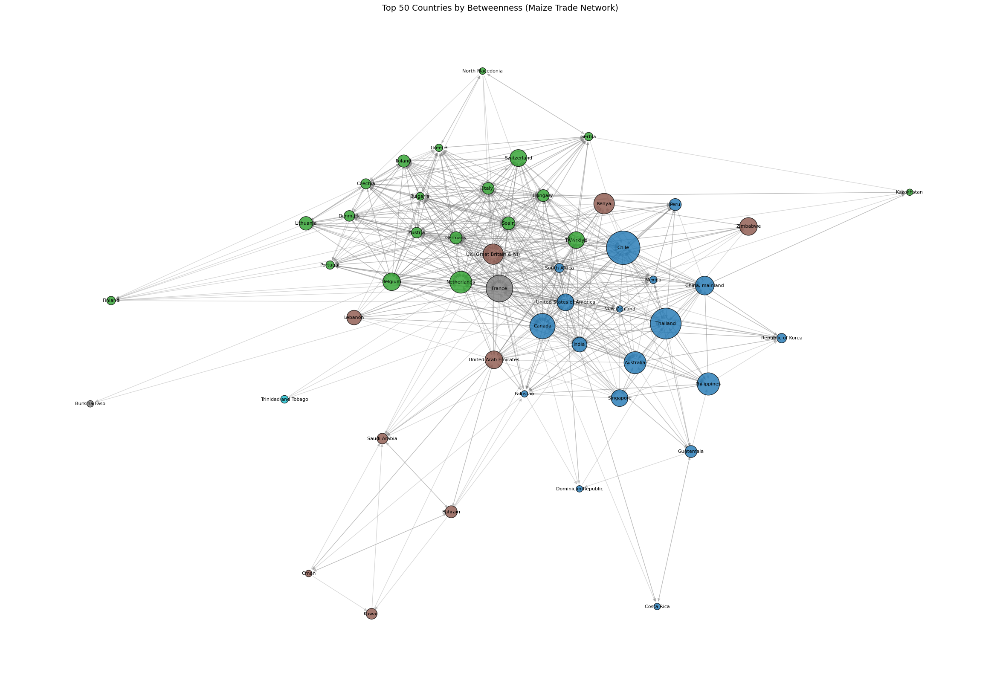

In [115]:
top_nodes = sorted(gm.nodes(data=True), key=lambda x: x[1].get('betweenness', 0), reverse=True)[:50]
top_node_names = [n[0] for n in top_nodes]
gm_sub = gm.subgraph(top_node_names)

node_sizes = [8000 * gm_sub.nodes[node]['betweenness'] for node in gm_sub.nodes()]
node_colors = [gm_sub.nodes[node]['modularity'] for node in gm_sub.nodes()]

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)

plt.figure(figsize=(30, 20))
pos = nx.spring_layout(gm_sub, seed=42, k=1.2, iterations=200) 

nx.draw_networkx_nodes(
    gm_sub, pos,
    node_size=node_sizes,
    node_color=node_colors,
    cmap=cmap,
    alpha=0.8,
    edgecolors='black'
)

nx.draw_networkx_edges(gm_sub, pos, alpha=0.3, edge_color='gray')

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK (Great Britain & NI)"
}

final_labels = {node: custom_labels.get(node, node) for node in gm_sub.nodes()}

nx.draw_networkx_labels(gm_sub, pos, labels=final_labels, font_size=8)

plt.axis("off")
plt.title("Top 50 Countries by Betweenness (Maize Trade Network)", fontsize=14, )
plt.show()


In [116]:
modularity_info = pd.DataFrame([
    {
        "Country": node,
        "Modularity Group": gm_sub.nodes[node].get('modularity'),
        "Betweenness": gm_sub.nodes[node].get('betweenness')
    }
    for node in gm_sub.nodes()
])

modularity_info = modularity_info.sort_values(by="Modularity Group")
display(modularity_info)


,Country,Modularity Group,Betweenness
13,Thailand,0,0.341539
37,Australia,0,0.173577
39,Mexico,0,0.020364
14,New Zealand,0,0.015215
30,Singapore,0,0.100990
12,India,0,0.077702
31,Peru,0,0.051857
10,Guatemala,0,0.051193
33,South Africa,0,0.030098
41,Costa Rica,0,0.015647


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/1125088204.py:11: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



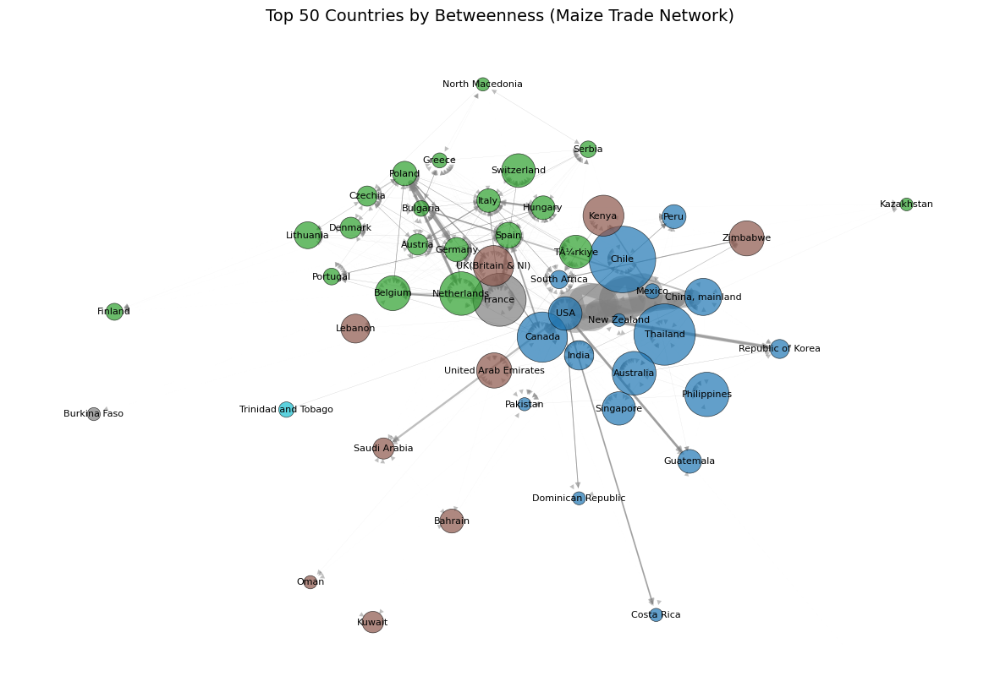

In [117]:
top_nodes = sorted(gm.nodes(data=True), key=lambda x: x[1].get('betweenness', 0), reverse=True)[:50]
top_node_names = [n[0] for n in top_nodes]
gm_sub = gm.subgraph(top_node_names)

node_sizes = [8000 * gm_sub.nodes[node]['betweenness'] for node in gm_sub.nodes()]
node_colors = [gm_sub.nodes[node]['modularity'] for node in gm_sub.nodes()]

edge_weights = [gm_sub[u][v]['Final Value'] for u, v in gm_sub.edges()]
edge_widths = [w / 500000 for w in edge_weights]

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1) 

plt.figure(figsize=(15, 10))
pos = nx.spring_layout(gm_sub, seed=42, k=1.2, iterations=200) 

nx.draw_networkx_nodes(
    gm_sub, pos,
    node_size=node_sizes,
    node_color=node_colors,
    cmap=cmap,
    alpha=0.7,
    edgecolors='black',
    linewidths = 0.5
)

nx.draw_networkx_edges(
    gm_sub, pos,
    edge_color='gray',
    arrows=True,
    arrowstyle='-|>',
    arrowsize=10,
    width=edge_widths,
    alpha=0.5
)

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK(Britain & NI)",
    "United States of America": "USA"
}

final_labels = {node: custom_labels.get(node, node) for node in gm_sub.nodes()}

nx.draw_networkx_labels(gm_sub, pos, labels=final_labels, font_size=8)

plt.axis("off")
plt.title("Top 50 Countries by Betweenness (Maize Trade Network)", fontsize=14, )
plt.show()

## Top 50 Countries by Betweenness (Maize Trade Network)

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/2144710187.py:14: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



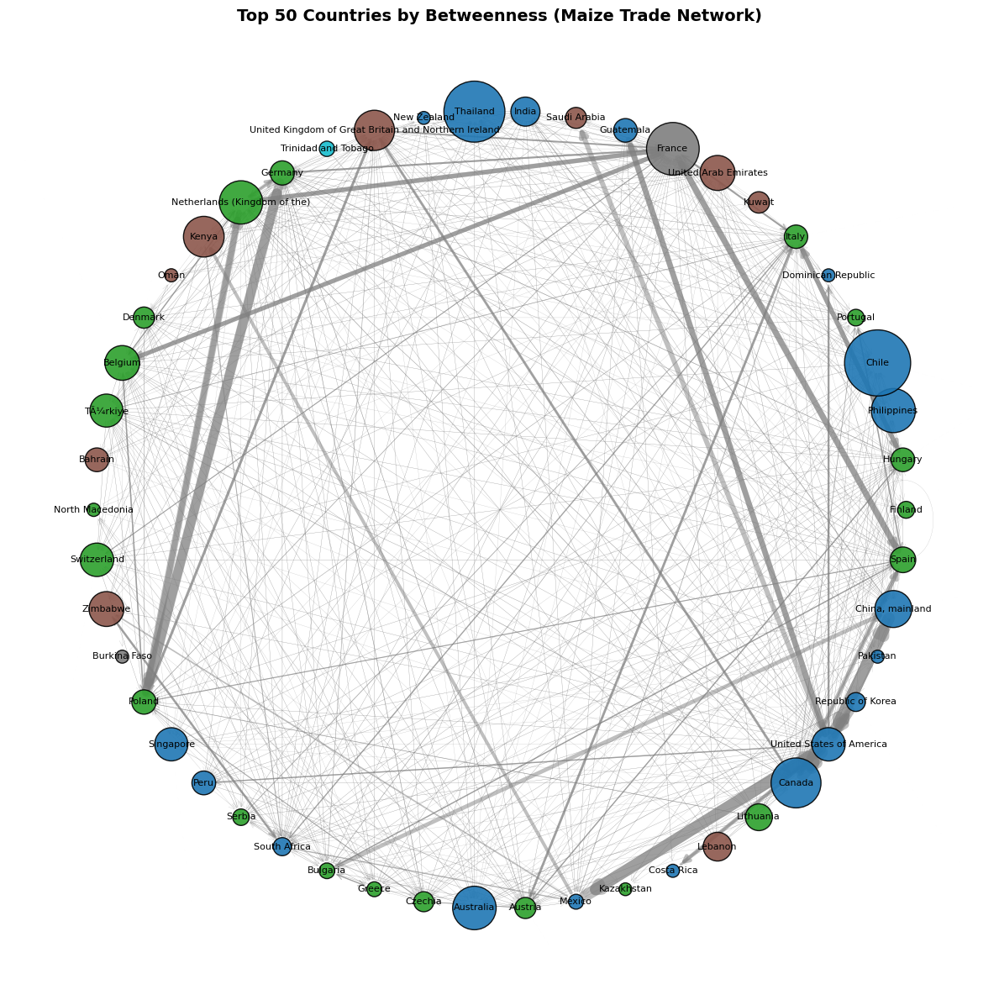

In [118]:
top_nodes = sorted(gm.nodes(data=True), key=lambda x: x[1].get('betweenness', 0), reverse=True)[:50]
top_node_names = [n[0] for n in top_nodes]
gm_sub = gm.subgraph(top_node_names).copy()

node_sizes = [8000 * gm_sub.nodes[node]['betweenness'] for node in gm_sub.nodes()]
node_colors = [gm_sub.nodes[node]['modularity'] for node in gm_sub.nodes()]

edge_weights = []
for u, v, d in gm_sub.edges(data=True):
    weight = d.get('Final Value', 1)
    scaled = max(0.2, min(10, weight / 2e5))  
    edge_weights.append(scaled)

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)
pos = nx.circular_layout(gm_sub)

plt.figure(figsize=(12, 12))

nx.draw_networkx_nodes(gm_sub, pos,
                       node_size=node_sizes,
                       node_color=node_colors,
                       cmap=cmap,
                       alpha=0.9,
                       edgecolors='black')

nx.draw_networkx_edges(gm_sub, pos,
                       edge_color='gray',
                       alpha=0.5,
                       arrows=True,
                       arrowstyle='->',
                       arrowsize=12,
                       width=edge_weights)

nx.draw_networkx_labels(gm_sub, pos, font_size=8)

plt.title("Top 50 Countries by Betweenness (Maize Trade Network)", fontsize=14, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()


## Chordal graph (1986 & 2023)

In [119]:
pip install holoviews bokeh pandas


Note: you may need to restart the kernel to use updated packages.


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
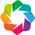

:Chord   [source,target]   (value)

In [120]:
import holoviews as hv
hv.extension('bokeh')

maize_1986 = lm[lm['Year'] == 1986]

chord_df = maize_1986[['O_name', 'D_name', 'Final Value']]

chord_top20 = chord_df.sort_values(by='Final Value', ascending=False).head(20)
chord_top20 = chord_top20[chord_top20['Final Value'] > 0]  

chord_top20 = chord_top20.rename(columns={
    'O_name': 'source',
    'D_name': 'target',
    'Final Value': 'value'
})

nodes = list(set(chord_top20['source']).union(set(chord_top20['target'])))
nodes_df = pd.DataFrame({'name': nodes})

chord = hv.Chord((chord_top20, hv.Dataset(nodes_df, 'name')))

chord.opts(
    width=800, height=800,
    cmap='Category20',
    edge_color='source',
    node_color='name',
    labels='name',
    title='Top 20 Maize Trade Flows (1986)'
)


In [121]:
pip install d3blocks

Note: you may need to restart the kernel to use updated packages.


In [122]:
from d3blocks import D3Blocks

maize_1986 = lm[lm['Year'] == 1986]

chord_df = maize_1986[['O_name', 'D_name', 'Final Value']]

chord_top20 = chord_df.sort_values(by='Final Value', ascending=False).head(20)
chord_top20 = chord_top20[chord_top20['Final Value'] > 0]  # 0 제거

df = chord_top20.rename(columns={
    'O_name': 'source',
    'D_name': 'target',
    'Final Value': 'weight'
})

d3 = D3Blocks(chart='Chord', frame=False)

d3.set_node_properties(df, opacity=0.7, cmap='tab20')
d3.set_edge_properties(df, color='source', opacity='source')

d3.show()


[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Edge properties are set.
[d3blocks] >INFO> File already exists and will be overwritten: [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> File not found: [file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Open browser: file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
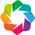

:Chord   [source,target]   (value)

In [123]:
import holoviews as hv
hv.extension('bokeh')

maize_2023 = lm[lm['Year'] == 2023]

chord_df = maize_2023[['O_name', 'D_name', 'Final Value']]

chord_top20 = chord_df.sort_values(by='Final Value', ascending=False).head(20)
chord_top20 = chord_top20[chord_top20['Final Value'] > 0] 

chord_top20 = chord_top20.rename(columns={
    'O_name': 'source',
    'D_name': 'target',
    'Final Value': 'value'
})

nodes = list(set(chord_top20['source']).union(set(chord_top20['target'])))
nodes_df = pd.DataFrame({'name': nodes})

chord = hv.Chord((chord_top20, hv.Dataset(nodes_df, 'name')))

chord.opts(
    width=800, height=800,
    cmap='Category20',
    edge_color='source',
    node_color='name',
    labels='name',
    title='Top 20 Maize Trade Flows (2023)'
)


In [124]:
maize_2023 = lm[lm['Year'] == 2023]

chord_df = maize_2023[['O_name', 'D_name', 'Final Value']]

chord_top20 = chord_df.sort_values(by='Final Value', ascending=False).head(20)
chord_top20 = chord_top20[chord_top20['Final Value'] > 0]  

df = chord_top20.rename(columns={
    'O_name': 'source',
    'D_name': 'target',
    'Final Value': 'weight'
})

d3 = D3Blocks(chart='Chord', frame=False)

d3.set_node_properties(df, opacity=0.7, cmap='tab20')
d3.set_edge_properties(df, color='source', opacity='source')

d3.show()

[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Edge properties are set.
[d3blocks] >INFO> File already exists and will be overwritten: [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> File not found: [file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Open browser: file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html


## 1986 Network Visualization (In/Out Degree based)

**node size: out_degree (수출 많이 한 나라일수록 더 큼)**

**node color: in_degree (수입 많이 한 나라일수록 노란색)**

**edge width: Final Value (무역량 많을수록 굵음)**

**Direction: Directed (수출->수입)**

In [125]:
node_merge = pd.merge(pop, macro, on=['country_code', 'country', 'Year'], how='inner')

node = pd.merge(node_merge, crop, on=['country_code', 'country', 'Year'], how='inner')

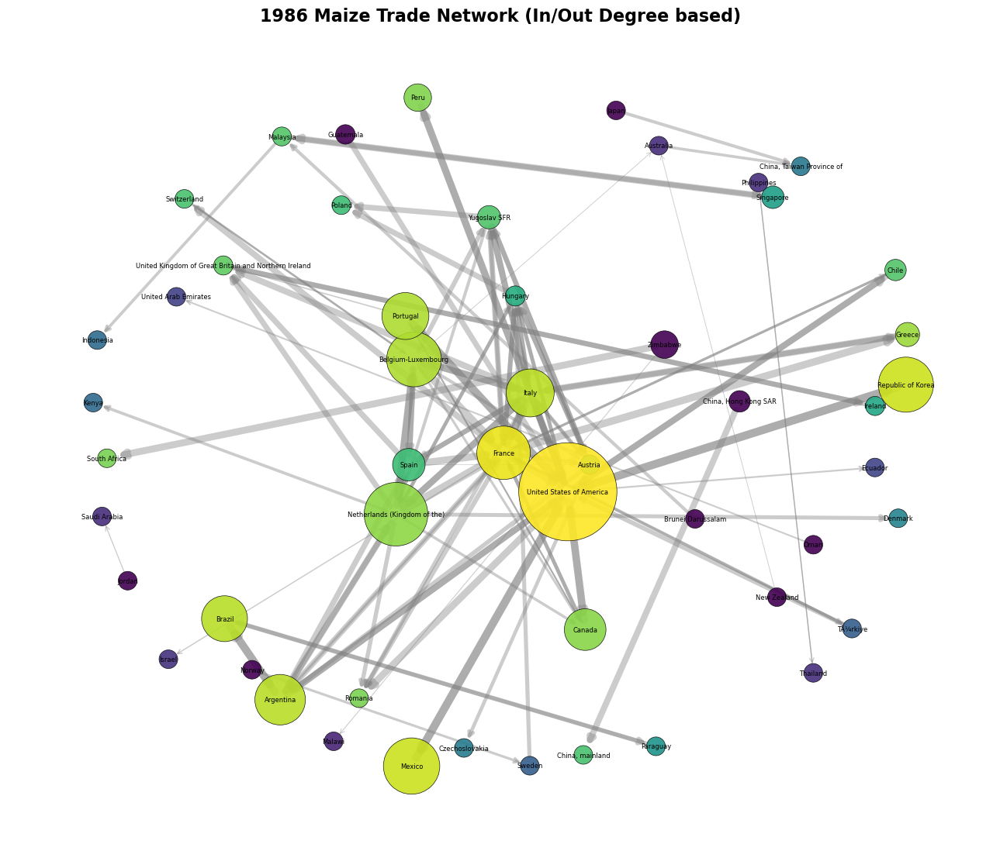

In [126]:
lm_1986 = lm[lm['Year'] == 1986]
node_1986 = node[node['Year'] == 1986].drop_duplicates(subset='country')

g_1986 = nx.from_pandas_edgelist(
    lm_1986,
    source='O_name',
    target='D_name',
    edge_attr='Final Value',
    create_using=nx.DiGraph()
)

node_attr = node_1986.set_index('country').to_dict('index')
nx.set_node_attributes(g_1986, node_attr)

in_deg = dict(g_1986.in_degree(weight='Final Value'))
out_deg = dict(g_1986.out_degree(weight='Final Value'))

nx.set_node_attributes(g_1986, in_deg, 'in_degree')
nx.set_node_attributes(g_1986, out_deg, 'out_degree')

in_degrees = np.array([g_1986.nodes[n].get('in_degree', 0) for n in g_1986.nodes()])
out_degrees = np.array([g_1986.nodes[n].get('out_degree', 0) for n in g_1986.nodes()])
node_sizes = 300 + 8000 * out_degrees / (out_degrees.max() + 1e-9)

log_in_deg = np.log1p(in_degrees)
color_vals = (log_in_deg - log_in_deg.min()) / (log_in_deg.max() - log_in_deg.min() + 1e-9)
node_colors = plt.cm.viridis(color_vals)

# Edge weight
edge_weights = np.array([d['Final Value'] for u, v, d in g_1986.edges(data=True)])
log_weights = np.log1p(edge_weights)
norm_weights = 0.5 + 7 * (log_weights - log_weights.min()) / (log_weights.max() - log_weights.min() + 1e-9)  # max width 7


plt.figure(figsize=(13, 11))
pos = nx.spring_layout(g_1986, seed=42, k=1.2)

nx.draw_networkx_nodes(
    g_1986, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.9,
    linewidths = 0.5
)

nx.draw_networkx_edges(
    g_1986, pos,
    edge_color='gray',
    width=norm_weights,
    arrows=True,
    arrowstyle='->',
    alpha=0.4,
    min_source_margin=1,
    min_target_margin=1
)

nx.draw_networkx_labels(g_1986, pos, font_size=6)

plt.title("1986 Maize Trade Network (In/Out Degree based)", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()


## 1986 Out Degree Top 20

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/3132640373.py:45: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



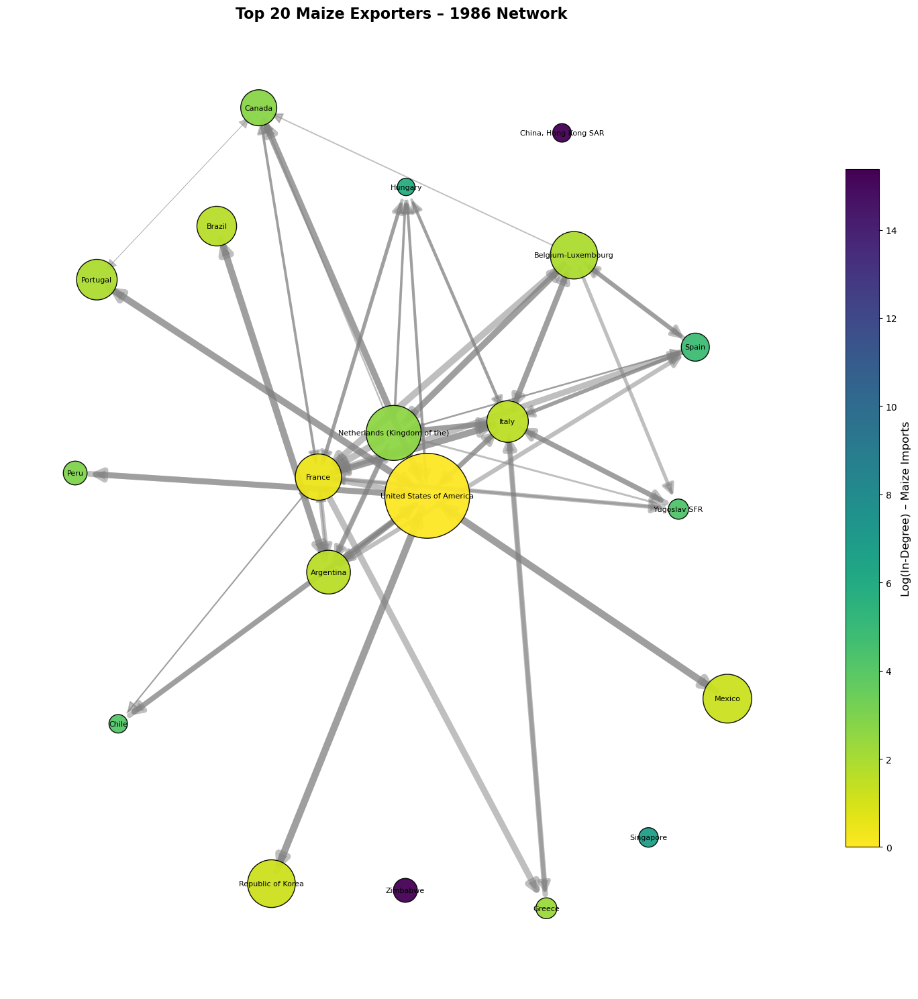

In [127]:
top20 = sorted(g_1986.nodes(data=True), key=lambda x: x[1].get('out_degree', 0), reverse=True)[:20]
top20_names = [n[0] for n in top20]

g_1986_top20 = g_1986.subgraph(top20_names).copy()

in_deg_top = np.array([g_1986_top20.nodes[n].get('in_degree', 0) for n in g_1986_top20.nodes()])
out_deg_top = np.array([g_1986_top20.nodes[n].get('out_degree', 0) for n in g_1986_top20.nodes()])
node_sizes_top = 300 + 8000 * out_deg_top / (out_deg_top.max() + 1e-9)

log_in_top = np.log1p(in_deg_top)
color_vals_top = (log_in_top - log_in_top.min()) / (log_in_top.max() - log_in_top.min() + 1e-9)
node_colors_top = plt.cm.viridis(color_vals_top)

edge_weights_top = np.array([d['Final Value'] for u, v, d in g_1986_top20.edges(data=True)])
log_weights_top = np.log1p(edge_weights_top)
norm_weights_top = 0.5 + 7 * (log_weights_top - log_weights_top.min()) / (log_weights_top.max() - log_weights_top.min() + 1e-9)

plt.figure(figsize=(15, 15))
pos_top = nx.spring_layout(g_1986_top20, seed=42, k=1.5)

nx.draw_networkx_nodes(
    g_1986_top20, pos_top,
    node_size=node_sizes_top,
    node_color=node_colors_top,
    edgecolors='black',
    alpha=0.95
)

nx.draw_networkx_edges(
    g_1986_top20, pos_top,
    edge_color='gray',
    width=norm_weights_top,
    arrows=True,
    arrowstyle='-|>',
    arrowsize=25,
    alpha=0.5,
    min_source_margin=15,
    min_target_margin=15
)

nx.draw_networkx_labels(g_1986_top20, pos_top, font_size=8)

sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis_r)
sm.set_array(log_in_top)
cbar = plt.colorbar(sm, shrink=0.7)
cbar.set_label("Log(In-Degree) – Maize Imports", fontsize=12)

plt.title("Top 20 Maize Exporters – 1986 Network", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

## 2023 Network Visualization (In/Out Degree based)

**node size: out_degree (수출 많이 한 나라일수록 더 큼)**

**node color: in_degree (수입 많이 한 나라일수록 노란색)**

**edge width: Final Value (무역량 많을수록 굵음)**

**Direction: Directed (수출->수입)**

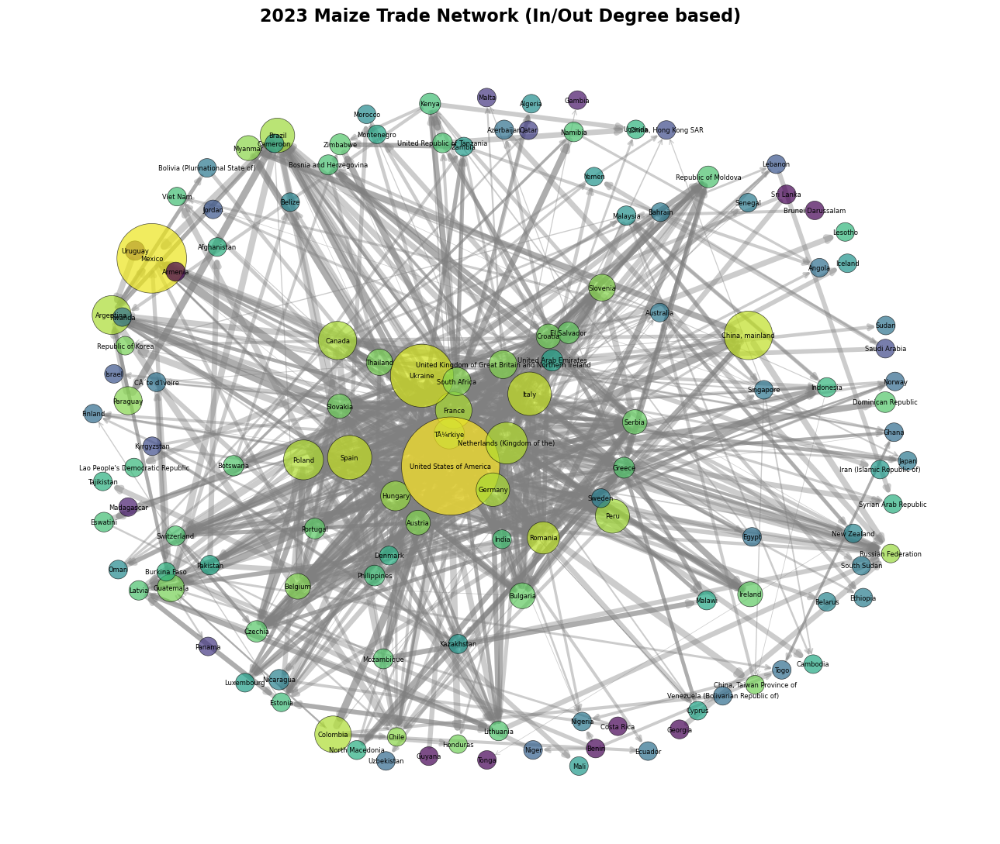

In [128]:
lm_2023 = lm[lm['Year'] == 2023]
m_node_2023 = node[node['Year'] == 2023].drop_duplicates(subset='country')

m_g_2023 = nx.from_pandas_edgelist(
    lm_2023,
    source='O_name',
    target='D_name',
    edge_attr='Final Value',
    create_using=nx.DiGraph()
)

node_attr = m_node_2023.set_index('country').to_dict('index')
nx.set_node_attributes(m_g_2023, node_attr)

in_deg = dict(m_g_2023.in_degree(weight='Final Value'))
out_deg = dict(m_g_2023.out_degree(weight='Final Value'))

nx.set_node_attributes(m_g_2023, in_deg, 'in_degree')
nx.set_node_attributes(m_g_2023, out_deg, 'out_degree')

in_degrees = np.array([m_g_2023.nodes[n].get('in_degree', 0) for n in m_g_2023.nodes()])
out_degrees = np.array([m_g_2023.nodes[n].get('out_degree', 0) for n in m_g_2023.nodes()])
node_sizes = 300 + 8000 * out_degrees / (out_degrees.max() + 1e-9)

log_in_deg = np.log1p(in_degrees)
color_vals = (log_in_deg - log_in_deg.min()) / (log_in_deg.max() - log_in_deg.min() + 1e-9)
node_colors = plt.cm.viridis(color_vals)

edge_weights = np.array([d['Final Value'] for u, v, d in m_g_2023.edges(data=True)])
log_weights = np.log1p(edge_weights)
norm_weights = 0.5 + 7 * (log_weights - log_weights.min()) / (log_weights.max() - log_weights.min() + 1e-9)  # max width 7


plt.figure(figsize=(13, 11))
pos = nx.spring_layout(m_g_2023, seed=42, k=1.2)

nx.draw_networkx_nodes(
    m_g_2023, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.7,
    linewidths = 0.5
)

nx.draw_networkx_edges(
    m_g_2023, pos,
    edge_color='gray',
    width=norm_weights,
    arrows=True,
    arrowstyle='->',
    alpha=0.4,
    min_source_margin=1,
    min_target_margin=1
)

nx.draw_networkx_labels(m_g_2023, pos, font_size=6)

plt.title("2023 Maize Trade Network (In/Out Degree based)", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/487141380.py:45: MatplotlibDeprecationWarning:

Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.



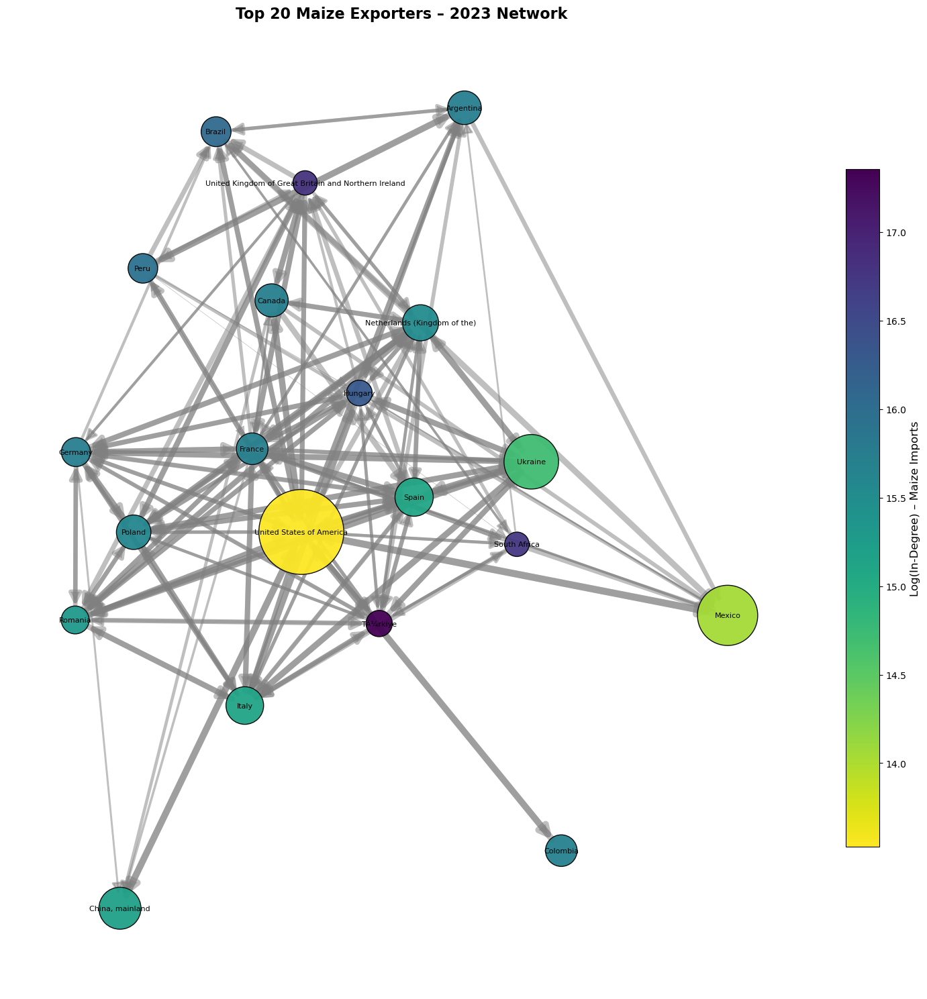

In [129]:
top20 = sorted(m_g_2023.nodes(data=True), key=lambda x: x[1].get('out_degree', 0), reverse=True)[:20]
top20_names = [n[0] for n in top20]

m_g_2023_top20 = m_g_2023.subgraph(top20_names).copy()

in_deg_top = np.array([m_g_2023_top20.nodes[n].get('in_degree', 0) for n in m_g_2023_top20.nodes()])
out_deg_top = np.array([m_g_2023_top20.nodes[n].get('out_degree', 0) for n in m_g_2023_top20.nodes()])
node_sizes_top = 300 + 8000 * out_deg_top / (out_deg_top.max() + 1e-9)

log_in_top = np.log1p(in_deg_top)
color_vals_top = (log_in_top - log_in_top.min()) / (log_in_top.max() - log_in_top.min() + 1e-9)
node_colors_top = plt.cm.viridis(color_vals_top)

edge_weights_top = np.array([d['Final Value'] for u, v, d in m_g_2023_top20.edges(data=True)])
log_weights_top = np.log1p(edge_weights_top)
norm_weights_top = 0.5 + 7 * (log_weights_top - log_weights_top.min()) / (log_weights_top.max() - log_weights_top.min() + 1e-9)

plt.figure(figsize=(15, 15))
pos_top = nx.spring_layout(m_g_2023_top20, seed=42, k=1.5)

nx.draw_networkx_nodes(
    m_g_2023_top20, pos_top,
    node_size=node_sizes_top,
    node_color=node_colors_top,
    edgecolors='black',
    alpha=0.95
)

nx.draw_networkx_edges(
    m_g_2023_top20, pos_top,
    edge_color='gray',
    width=norm_weights_top,
    arrows=True,
    arrowstyle='-|>',
    arrowsize=25,
    alpha=0.5,
    min_source_margin=15,
    min_target_margin=15
)

nx.draw_networkx_labels(m_g_2023_top20, pos_top, font_size=8)

sm = plt.cm.ScalarMappable(cmap=plt.cm.viridis_r)
sm.set_array(log_in_top)
cbar = plt.colorbar(sm, shrink=0.7)
cbar.set_label("Log(In-Degree) – Maize Imports", fontsize=12)

plt.title("Top 20 Maize Exporters – 2023 Network", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

# Production 기준으로 노드 크기, Area harvested 기준으로 색상

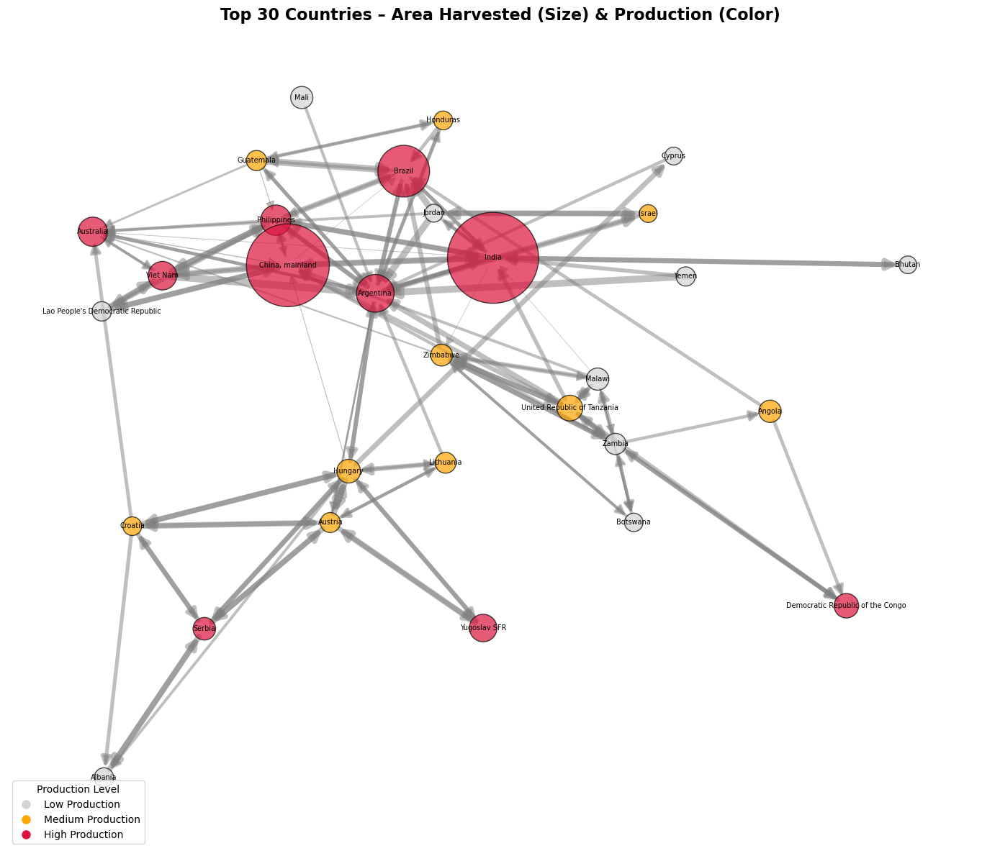

In [132]:
from matplotlib.lines import Line2D

top30_nodes = sorted(gm.nodes(data=True), key=lambda x: x[1].get('out_degree', 0), reverse=True)[:30]
top30_names = [n[0] for n in top30_nodes]
gm_top30 = gm.subgraph(top30_names).copy()

area_vals = np.array([gm_top30.nodes[n].get('Area harvested', 0) for n in gm_top30.nodes()])
node_sizes = 300 + 8000 * area_vals / (area_vals.max() + 1e-9)

prod_vals = np.array([gm_top30.nodes[n].get('Production', 0) for n in gm_top30.nodes()])
p33, p66 = np.percentile(prod_vals, [33, 66])

node_colors = []
color_labels = []  
for n in gm_top30.nodes():
    val = gm_top30.nodes[n].get('Production', 0)
    if val < p33:
        node_colors.append('lightgray')
        color_labels.append('Low')
    elif val < p66:
        node_colors.append('orange')
        color_labels.append('Medium')
    else:
        node_colors.append('crimson')
        color_labels.append('High')

edge_weights = [d['Final Value'] for _, _, d in gm_top30.edges(data=True)]
widths = 0.5 + 7 * (np.log1p(edge_weights) - np.log1p(min(edge_weights))) / \
                 (np.log1p(max(edge_weights)) - np.log1p(min(edge_weights)) + 1e-9)

plt.figure(figsize=(14, 12))
pos = nx.spring_layout(gm_top30, seed=42)

# Nodes
nx.draw_networkx_nodes(
    gm_top30, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.7
)

# Edges
nx.draw_networkx_edges(
    gm_top30, pos,
    edge_color='gray',
    width=widths,
    arrows=True,
    arrowstyle='-|>',
    arrowsize=20,
    alpha=0.5,
    min_source_margin=10,
    min_target_margin=10
)

# Labels
nx.draw_networkx_labels(gm_top30, pos, font_size=7)

legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Low Production', markerfacecolor='lightgray', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Medium Production', markerfacecolor='orange', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='High Production', markerfacecolor='crimson', markersize=10)
]
plt.legend(handles=legend_elements, title="Production Level", loc='lower left', fontsize=10)

# Title
plt.title("Top 30 Countries – Area Harvested (Size) & Production (Color)", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

# [Chicken] Network Visualization

## All Countries Network Visualization (Size = Betweenness, Color = Modularity)

In [133]:
gc.nodes(data = True)

NodeDataView({'Benin': {'country_code': 53, 'Year': 1970, 'population': 3065.057, 'GDP_total': 162.90109660000002, 'GDP_per_capita': 106.12035599999999, 'Area harvested': 49443.53333333333, 'Producing Animals/Slaughtered': 135283.68421052632, 'Production': 47921.493295454544, 'i_degree': 0, 'o_degree': 4888.57, 'betweenness': 0.01431171928943569, 'modularity': 1}, 'Australia': {'country_code': 10, 'Year': 1970, 'population': 12599.411, 'GDP_total': 23171.6575682, 'GDP_per_capita': 3570.2966109999998, 'Area harvested': 279869.0853658537, 'Producing Animals/Slaughtered': 10931666.869565217, 'Production': 685306.3551923076, 'i_degree': 0, 'o_degree': 88.18, 'betweenness': 0.038478438265017886, 'modularity': 0}, 'Seychelles': {'country_code': 196, 'Year': 1970, 'population': 54.252, 'GDP_total': 11.0565308, 'GDP_per_capita': 408.7653965, 'Area harvested': 1622.875, 'Producing Animals/Slaughtered': 1179.4375, 'Production': 968.5355319148936, 'i_degree': 0.6, 'o_degree': 0, 'betweenness': 0.

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/3269406881.py:4: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



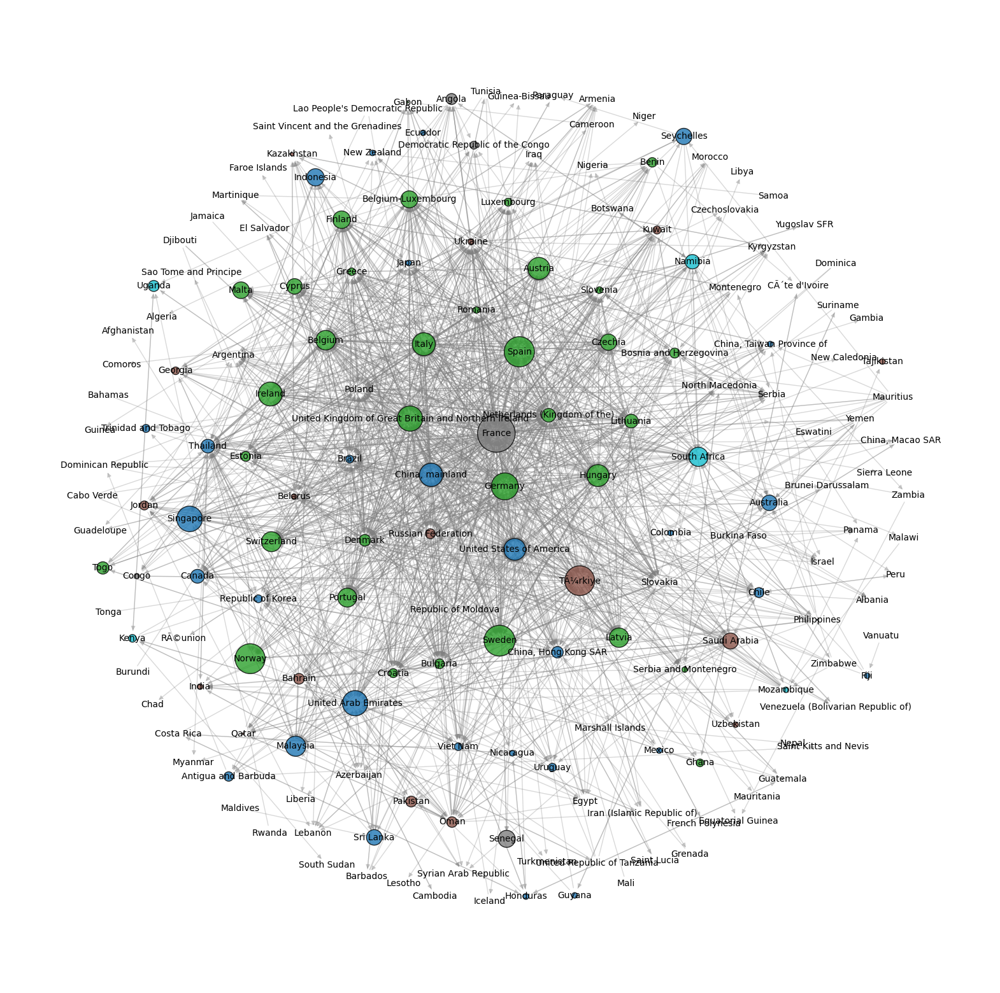

In [134]:
node_sizes = [8000 * gc.nodes[node]['betweenness'] for node in gc.nodes()]  
node_colors = [gc.nodes[node]['modularity'] for node in gc.nodes()] 

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)  
plt.figure(figsize=(20, 20))
pos = nx.arf_layout(gc, pos=None, scaling=1, a=1.1, etol=1e-06, dt=0.001, max_iter=1000)

nx.draw_networkx_nodes(gc, pos, 
                       node_size=node_sizes, 
                       node_color=node_colors, 
                       cmap=cmap, 
                       alpha=0.8, 
                       edgecolors='black')

nx.draw_networkx_edges(gc, pos, alpha=0.3, edge_color='gray')

nx.draw_networkx_labels(gc, pos, font_size=10)

plt.axis("off")
plt.show()

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/3315798598.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



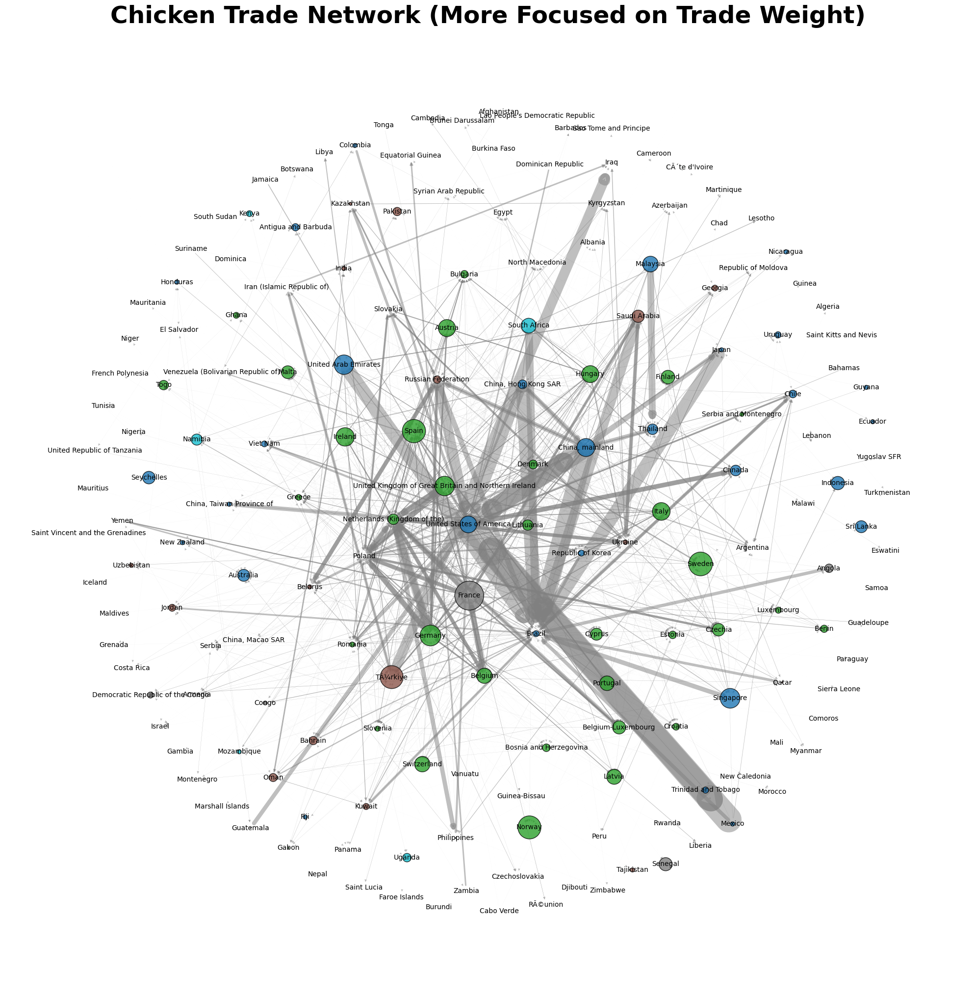

In [135]:
node_sizes = [8000 * gc.nodes[node]['betweenness'] for node in gc.nodes()]  
node_colors = [gc.nodes[node]['modularity'] for node in gc.nodes()] 

edge_weights = [gc[u][v]['Final Value'] for u, v in gc.edges()]
edge_widths = [w / 20000 for w in edge_weights] 


cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)  
plt.figure(figsize=(20, 20))

pos = nx.arf_layout(gc, pos=None, scaling=1, a=1.1, etol=1e-06, dt=0.001, max_iter=1000)

nx.draw_networkx_nodes(gc, pos, 
                       node_size=node_sizes, 
                       node_color=node_colors, 
                       cmap=cmap, 
                       alpha=0.8, 
                       edgecolors='black')

nx.draw_networkx_edges(
    gc, pos,
    arrows=True,
    arrowstyle='-|>',
    arrowsize=8,
    edge_color='gray',
    width=edge_widths,
    alpha=0.5
)

nx.draw_networkx_labels(gc, pos, font_size=10)

plt.axis("off")
plt.tight_layout()
plt.title("Chicken Trade Network (More Focused on Trade Weight)", fontsize = 35, fontweight='bold')
plt.show()

## Top50 Countries with highest Betweenness (Size = Betweenness, Color = Modularity)

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/3438365844.py:8: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



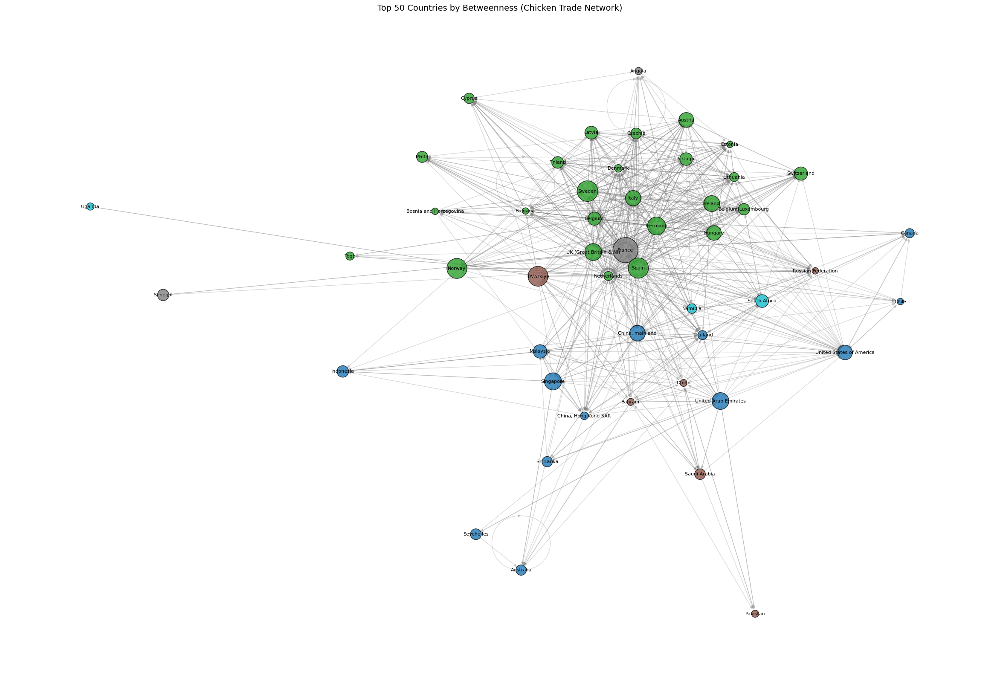

In [136]:
top_nodes = sorted(gc.nodes(data=True), key=lambda x: x[1].get('betweenness', 0), reverse=True)[:50]
top_node_names = [n[0] for n in top_nodes]
gc_sub = gc.subgraph(top_node_names)

node_sizes = [8000 * gc_sub.nodes[node]['betweenness'] for node in gc_sub.nodes()]
node_colors = [gc_sub.nodes[node]['modularity'] for node in gc_sub.nodes()]

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1) 

plt.figure(figsize=(30, 20))
pos = nx.spring_layout(gc_sub, seed=42, k=1.2, iterations=200) 

nx.draw_networkx_nodes(
    gc_sub, pos,
    node_size=node_sizes,
    node_color=node_colors,
    cmap=cmap,
    alpha=0.8,
    edgecolors='black'
)

nx.draw_networkx_edges(gc_sub, pos, alpha=0.3, edge_color='gray')

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK (Great Britain & NI)"
}

final_labels = {node: custom_labels.get(node, node) for node in gc_sub.nodes()}

nx.draw_networkx_labels(gc_sub, pos, labels=final_labels, font_size=8)

plt.axis("off")
plt.title("Top 50 Countries by Betweenness (Chicken Trade Network)", fontsize=14, )
plt.show()

In [137]:
modularity_info = pd.DataFrame([
    {
        "Country": node,
        "Modularity Group": gc_sub.nodes[node].get('modularity'),
        "Betweenness": gc_sub.nodes[node].get('betweenness')
    }
    for node in gc_sub.nodes()
])

modularity_info = modularity_info.sort_values(by="Modularity Group")
display(modularity_info)


,Country,Modularity Group,Betweenness
38,Australia,0,0.038478
27,Indonesia,0,0.047863
20,Seychelles,0,0.042370
29,Singapore,0,0.104294
30,Sri Lanka,0,0.038604
32,"China, Hong Kong SAR",0,0.021091
12,Thailand,0,0.030004
9,United Arab Emirates,0,0.101500
48,"China, mainland",0,0.086780
6,Chile,0,0.015661


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/847837765.py:11: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



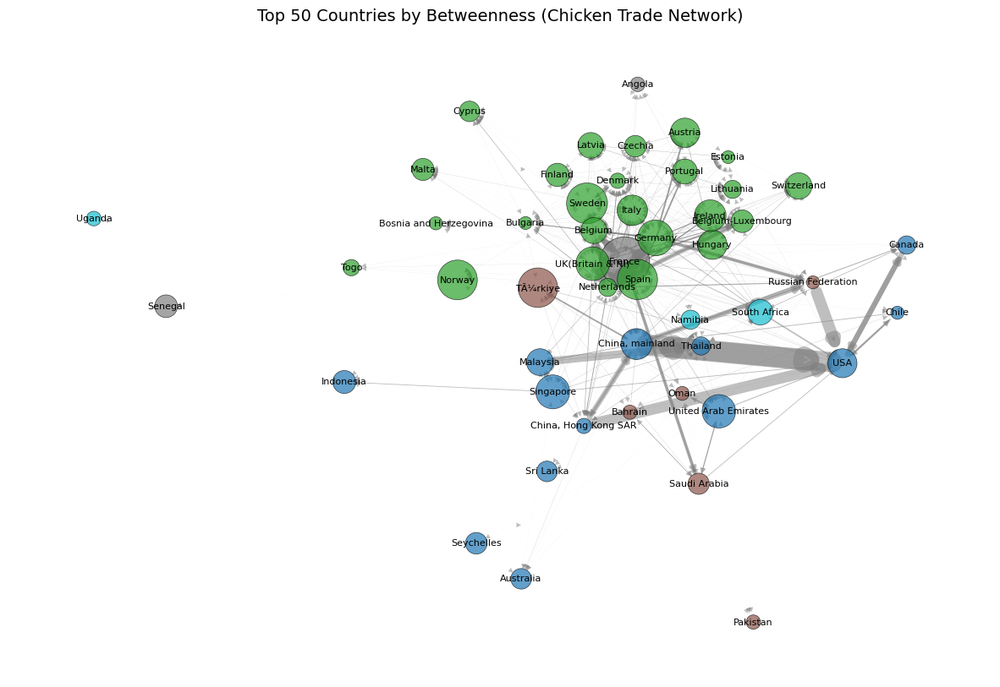

In [138]:
top_nodes = sorted(gc.nodes(data=True), key=lambda x: x[1].get('betweenness', 0), reverse=True)[:50]
top_node_names = [n[0] for n in top_nodes]
gc_sub = gc.subgraph(top_node_names)

node_sizes = [8000 * gc_sub.nodes[node]['betweenness'] for node in gc_sub.nodes()]
node_colors = [gc_sub.nodes[node]['modularity'] for node in gc_sub.nodes()]

edge_weights = [gc_sub[u][v]['Final Value'] for u, v in gc_sub.edges()]
edge_widths = [w / 30000 for w in edge_weights]

cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1) 

plt.figure(figsize=(15, 10))
pos = nx.spring_layout(gc_sub, seed=42, k=1.2, iterations=200) 

nx.draw_networkx_nodes(
    gc_sub, pos,
    node_size=node_sizes,
    node_color=node_colors,
    cmap=cmap,
    alpha=0.7,
    edgecolors='black',
    linewidths = 0.5
)

nx.draw_networkx_edges(
    gc_sub, pos,
    edge_color='gray',
    arrows=True,
    arrowstyle='-|>',
    arrowsize=10,
    width=edge_widths,
    alpha=0.5
)

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK(Britain & NI)",
    "United States of America": "USA"
}

final_labels = {node: custom_labels.get(node, node) for node in gc_sub.nodes()}

nx.draw_networkx_labels(gc_sub, pos, labels=final_labels, font_size=8)

plt.axis("off")
plt.title("Top 50 Countries by Betweenness (Chicken Trade Network)", fontsize=14, )
plt.show()

## Top 50 Countries by Betweenness (Chicken Trade Network)

/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/1770777802.py:11: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



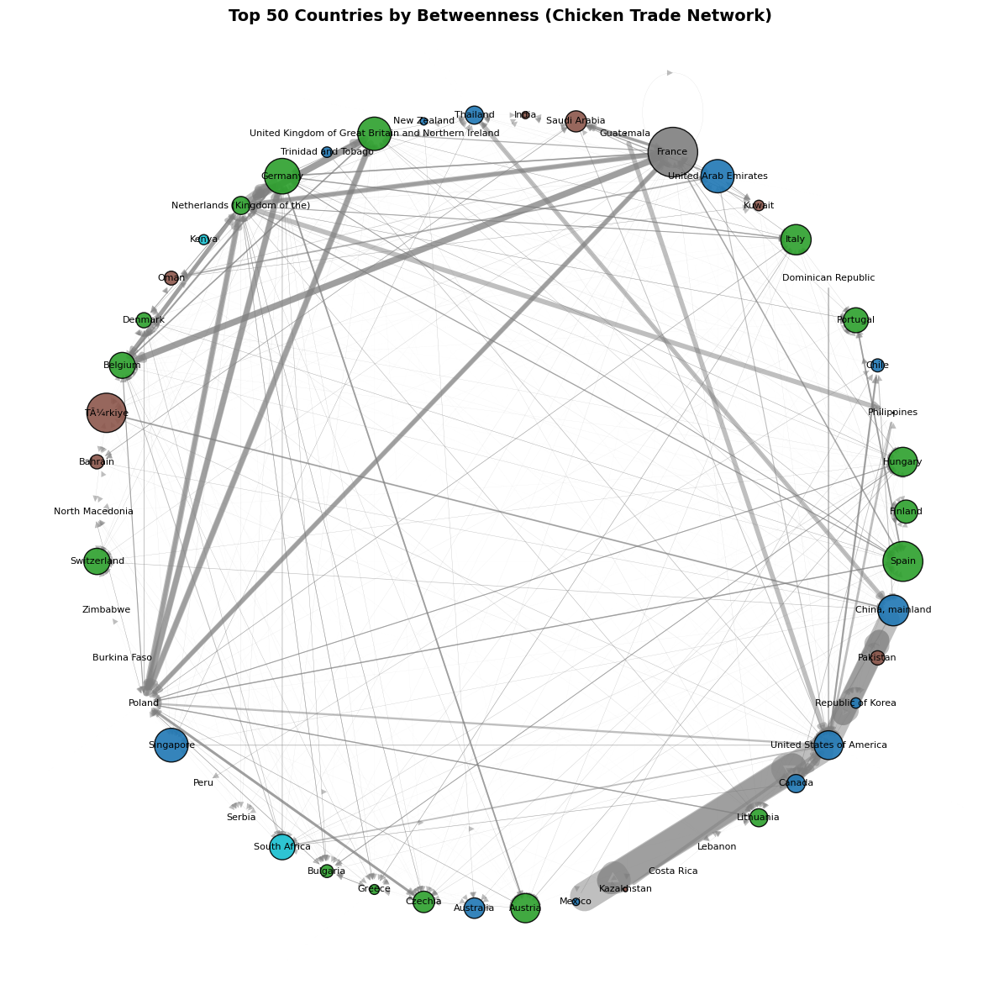

In [139]:
top_nodes = sorted(gm.nodes(data=True), key=lambda x: x[1].get('betweenness', 0), reverse=True)[:50]
top_node_names = [n[0] for n in top_nodes]
gc_sub = gc.subgraph(top_node_names).copy()

node_sizes = [8000 * gc_sub.nodes[node]['betweenness'] for node in gc_sub.nodes()]
node_colors = [gc_sub.nodes[node]['modularity'] for node in gc_sub.nodes()]

edge_weights = [gc_sub[u][v].get('Final Value', 1) / 30000 for u, v in gc_sub.edges()]


cmap = plt.cm.get_cmap('tab10', max(node_colors) + 1)
pos = nx.circular_layout(gc_sub)

plt.figure(figsize=(12, 12))

nx.draw_networkx_nodes(gc_sub, pos,
                       node_size=node_sizes,
                       node_color=node_colors,
                       cmap=cmap,
                       alpha=0.9,
                       edgecolors='black')

nx.draw_networkx_edges(gc_sub, pos,
                       edge_color='gray',
                       alpha=0.5,
                       arrows=True,
                       arrowstyle='-|>',
                       arrowsize=12,
                       width=edge_weights)

nx.draw_networkx_labels(gc_sub, pos, font_size=8)

plt.title("Top 50 Countries by Betweenness (Chicken Trade Network)", fontsize=14, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

## Chordal graph (1896 & 2023)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
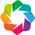

:Chord   [source,target]   (value)

In [140]:
hv.extension('bokeh')

chicken_1986 = lc[lc['Year'] == 1986]

Chi_chord_df = chicken_1986[['O_name', 'D_name', 'Final Value']]

Chi_chord_top20 = Chi_chord_df.sort_values(by='Final Value', ascending=False).head(20)
Chi_chord_top20 = Chi_chord_top20[Chi_chord_top20['Final Value'] > 0] 

Chi_chord_top20 = Chi_chord_top20.rename(columns={
    'O_name': 'source',
    'D_name': 'target',
    'Final Value': 'value'
})

Chi_nodes = list(set(Chi_chord_top20['source']).union(set(Chi_chord_top20['target'])))
Chi_nodes_df = pd.DataFrame({'name': Chi_nodes})

Chi_chord = hv.Chord((Chi_chord_top20, hv.Dataset(Chi_nodes_df, 'name')))

Chi_chord.opts(
    width=800, height=800,
    cmap='Category20',
    edge_color='source',
    node_color='name',
    labels='name',
    title='Top 20 Chicken Trade Flows (1986)'
)


In [141]:
chicken_1986 = lc[lc['Year'] == 1986]

chord_df = chicken_1986[['O_name', 'D_name', 'Final Value']]

chord_top20 = chord_df.sort_values(by='Final Value', ascending=False).head(20)
chord_top20 = chord_top20[chord_top20['Final Value'] > 0]  

name_map = {
    'United Kingdom of Great Britain and Northern Ireland': 'UK of Britain and Northern Ireland'
}

chord_top20['source'] = chord_top20['O_name'].replace(name_map)
chord_top20['target'] = chord_top20['D_name'].replace(name_map)

df = chord_top20[['source', 'target', 'Final Value']].rename(columns={'Final Value': 'weight'})

d3 = D3Blocks(chart='Chord', frame=False)
d3.set_node_properties(df, opacity=0.7, cmap='tab20')
d3.set_edge_properties(df, color='source', opacity='source')
d3.show()

[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Edge properties are set.
[d3blocks] >INFO> File already exists and will be overwritten: [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> File not found: [file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Open browser: file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
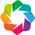

:Chord   [source,target]   (value)

In [142]:
hv.extension('bokeh')

chicken_2023 = lc[lc['Year'] == 2023]

Chi_chord_df23 = chicken_2023[['O_name', 'D_name', 'Final Value']]

Chi_chord_top20_23 = Chi_chord_df23.sort_values(by='Final Value', ascending=False).head(20)
Chi_chord_top20_23 = Chi_chord_top20_23[Chi_chord_top20_23['Final Value'] > 0]  # 0 제거 (혹시 몰라서)

Chi_chord_top20_23 = Chi_chord_top20_23.rename(columns={
    'O_name': 'source',
    'D_name': 'target',
    'Final Value': 'value'
})

Chi_nodes_23 = list(set(Chi_chord_top20_23['source']).union(set(Chi_chord_top20_23['target'])))
Chi_nodes_df_23 = pd.DataFrame({'name': Chi_nodes_23})

Chi_chord23 = hv.Chord((Chi_chord_top20_23, hv.Dataset(Chi_nodes_df_23, 'name')))

Chi_chord23.opts(
    width=800, height=800,
    cmap='Category20',
    edge_color='source',
    node_color='name',
    labels='name',
    title='Top 20 Chicken Trade Flows (2023)'
)

In [143]:
chicken_2023 = lc[lc['Year'] == 2023]

chord_df = chicken_2023[['O_name', 'D_name', 'Final Value']]

chord_top20 = chord_df.sort_values(by='Final Value', ascending=False).head(20)
chord_top20 = chord_top20[chord_top20['Final Value'] > 0]  

name_map = {
    'United Kingdom of Great Britain and Northern Ireland': 'UK of Britain, Northern Ireland'
}

chord_top20['source'] = chord_top20['O_name'].replace(name_map)
chord_top20['target'] = chord_top20['D_name'].replace(name_map)

df = chord_top20[['source', 'target', 'Final Value']].rename(columns={'Final Value': 'weight'})

d3 = D3Blocks(chart='Chord', frame=False)
d3.set_node_properties(df, opacity=0.7, cmap='tab20')
d3.set_edge_properties(df, color='source', opacity='source')
d3.show()

[d3blocks] >INFO> Cleaning edge_properties and config parameters..
[d3blocks] >INFO> Initializing [Chord]
[d3blocks] >INFO> filepath is set to [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Node properties are set.
[d3blocks] >INFO> Edge properties are set.
[d3blocks] >INFO> File already exists and will be overwritten: [/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> File not found: [file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html]
[d3blocks] >INFO> Open browser: file:////var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/d3blocks/chord.html


## 1986 Network Visualization (In/Out Degree based)

**node size: out_degree (수출 많이 한 나라일수록 더 큼)**

**node color: in_degree (수입 많이 한 나라일수록 노란색)**

**edge width: Final Value (무역량 많을수록 굵음)**

**Direction: Directed (수출->수입)**

In [144]:
node_merge = pd.merge(pop, macro, on=['country_code', 'country', 'Year'], how='inner')

node = pd.merge(node_merge, crop, on=['country_code', 'country', 'Year'], how='inner')

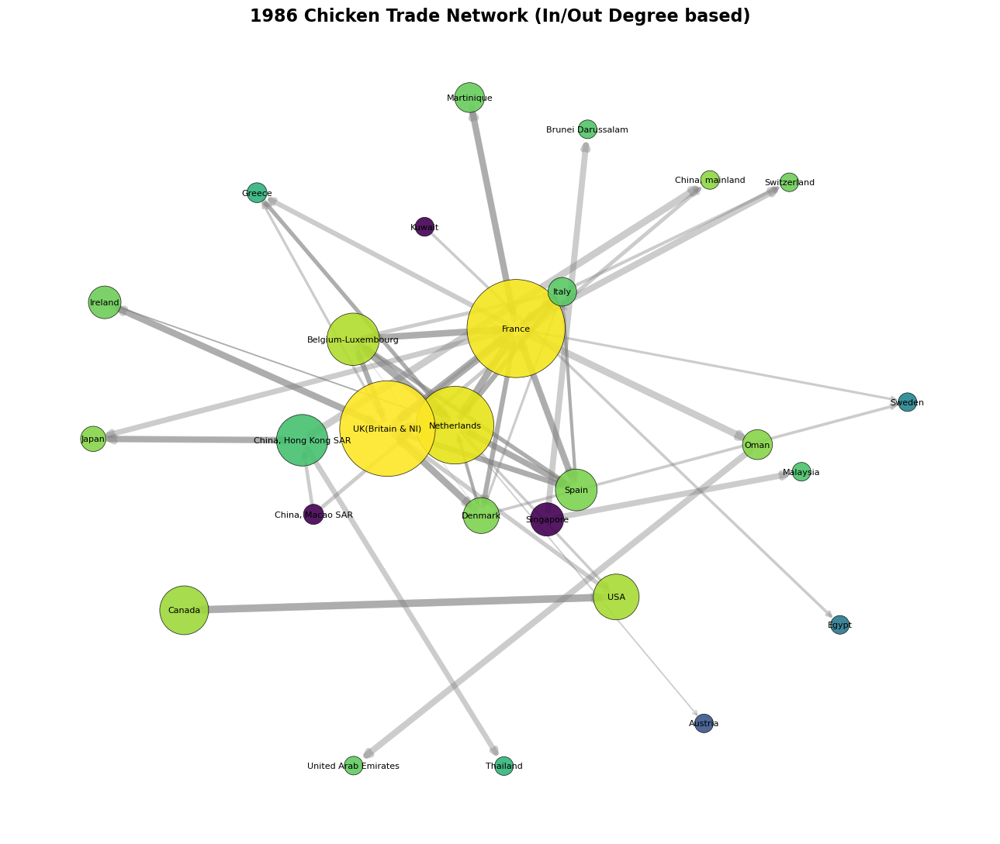

In [145]:
lc_1986 = lc[lc['Year'] == 1986]
C_node_1986 = node[node['Year'] == 1986].drop_duplicates(subset='country')

gc_1986 = nx.from_pandas_edgelist(
    lc_1986,
    source='O_name',
    target='D_name',
    edge_attr='Final Value',
    create_using=nx.DiGraph()
)

C_node_attr = C_node_1986.set_index('country').to_dict('index')
nx.set_node_attributes(gc_1986, C_node_attr)

in_deg = dict(gc_1986.in_degree(weight='Final Value'))
out_deg = dict(gc_1986.out_degree(weight='Final Value'))

nx.set_node_attributes(gc_1986, in_deg, 'in_degree')
nx.set_node_attributes(gc_1986, out_deg, 'out_degree')

in_degrees = np.array([gc_1986.nodes[n].get('in_degree', 0) for n in gc_1986.nodes()])
out_degrees = np.array([gc_1986.nodes[n].get('out_degree', 0) for n in gc_1986.nodes()])
node_sizes = 300 + 8000 * out_degrees / (out_degrees.max() + 1e-9)

log_in_deg = np.log1p(in_degrees)
color_vals = (log_in_deg - log_in_deg.min()) / (log_in_deg.max() - log_in_deg.min() + 1e-9)
node_colors = plt.cm.viridis(color_vals)

# Edge weight
edge_weights = np.array([d['Final Value'] for u, v, d in gc_1986.edges(data=True)])
log_weights = np.log1p(edge_weights)
norm_weights = 0.5 + 7 * (log_weights - log_weights.min()) / (log_weights.max() - log_weights.min() + 1e-9)  # max width 7


plt.figure(figsize=(13, 11))
pos = nx.spring_layout(gc_1986, seed=42, k=1.2)

nx.draw_networkx_nodes(
    gc_1986, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.9,
    linewidths = 0.5
)

nx.draw_networkx_edges(
    gc_1986, pos,
    edge_color='gray',
    width=norm_weights,
    arrows=True,
    arrowstyle='->',
    alpha=0.4,
    min_source_margin=1,
    min_target_margin=1
)

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK(Britain & NI)",
    "United States of America": "USA"
}


final_labels = {node: custom_labels.get(node, node) for node in gc_1986.nodes()}

nx.draw_networkx_labels(gc_1986, pos, labels=final_labels, font_size=8)

plt.title("1986 Chicken Trade Network (In/Out Degree based)", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()


## 1986 Out Degree Top 20

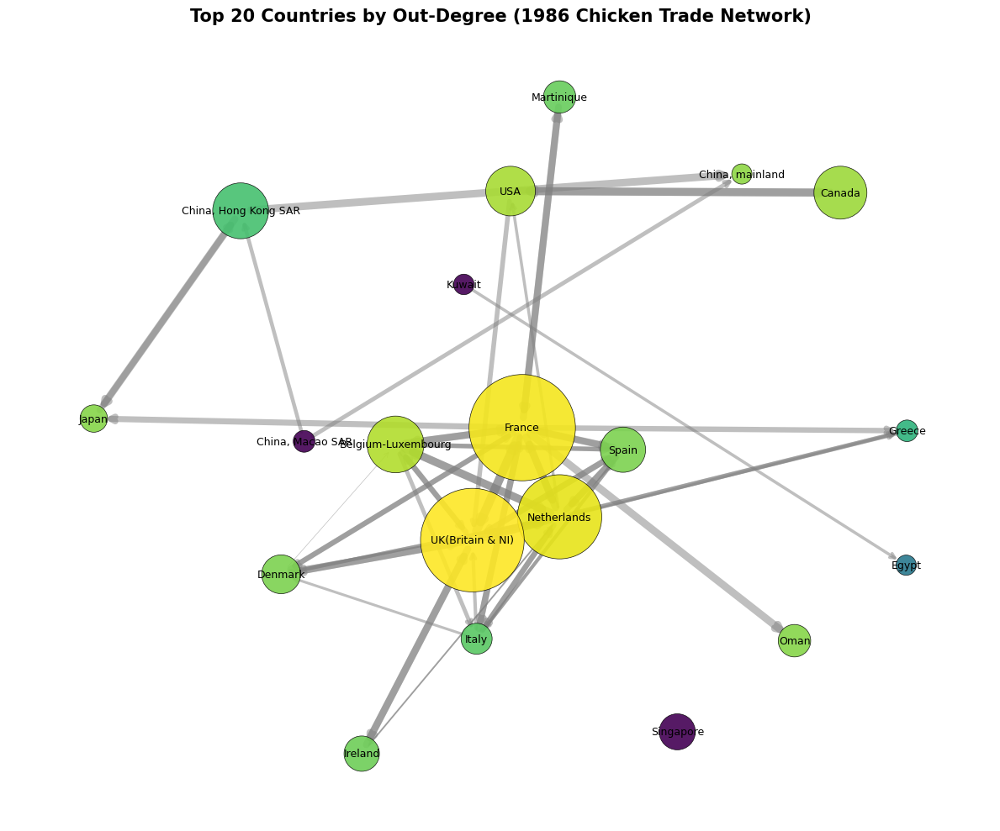

In [146]:
top20_out_nodes = sorted(gc_1986.nodes(data=True), key=lambda x: x[1].get('out_degree', 0), reverse=True)[:20]
top20_node_names = [node[0] for node in top20_out_nodes]

gc_1986_top20 = gc_1986.subgraph(top20_node_names).copy()

out_degrees = np.array([gc_1986_top20.nodes[n].get('out_degree', 0) for n in gc_1986_top20.nodes()])
node_sizes = 300 + 8000 * out_degrees / (out_degrees.max() + 1e-9)

in_degrees = np.array([gc_1986_top20.nodes[n].get('in_degree', 0) for n in gc_1986_top20.nodes()])
log_in_deg = np.log1p(in_degrees)
color_vals = (log_in_deg - log_in_deg.min()) / (log_in_deg.max() - log_in_deg.min() + 1e-9)
node_colors = plt.cm.viridis(color_vals)

edge_weights = np.array([d.get('Final Value', 1) for u, v, d in gc_1986_top20.edges(data=True)])
log_weights = np.log1p(edge_weights)
norm_weights = 0.5 + 7 * (log_weights - log_weights.min()) / (log_weights.max() - log_weights.min() + 1e-9)

plt.figure(figsize=(12, 10))
pos = nx.spring_layout(gc_1986_top20, seed=42, k=1.2)

nx.draw_networkx_nodes(
    gc_1986_top20, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.9,
    linewidths=0.5
)

nx.draw_networkx_edges(
    gc_1986_top20, pos,
    edge_color='gray',
    width=norm_weights,
    arrows=True,
    arrowstyle='->',
    alpha=0.5,
    min_source_margin=1,
    min_target_margin=1
)

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK(Britain & NI)",
    "United States of America": "USA"
}
final_labels = {node: custom_labels.get(node, node) for node in gc_1986_top20.nodes()}

nx.draw_networkx_labels(gc_1986_top20, pos, labels=final_labels, font_size=9)

plt.title("Top 20 Countries by Out-Degree (1986 Chicken Trade Network)", fontsize=15, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()


## 2023 Network Visualization (In/Out Degree based)

**node size: out_degree (수출 많이 한 나라일수록 더 큼)**

**node color: in_degree (수입 많이 한 나라일수록 노란색)**

**edge width: Final Value (무역량 많을수록 굵음)**

**Direction: Directed (수출->수입)**

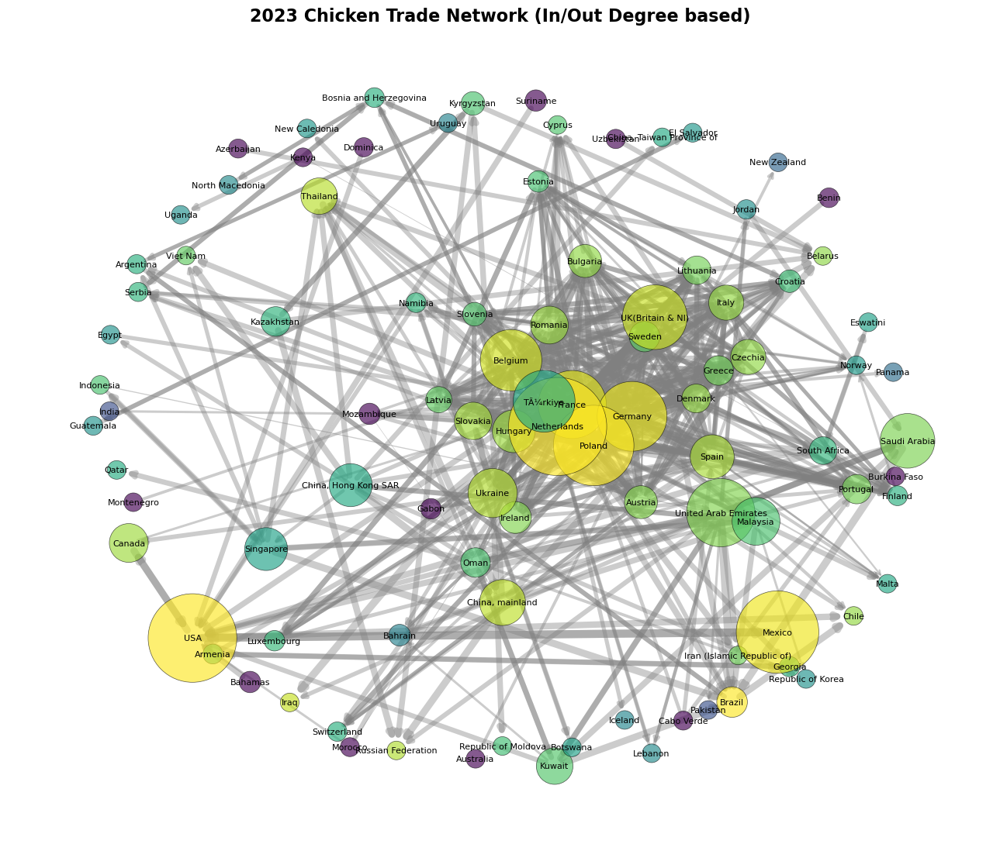

In [147]:
lc_2023 = lc[lc['Year'] == 2023]
C_node_2023 = node[node['Year'] == 2023].drop_duplicates(subset='country')

gc_2023 = nx.from_pandas_edgelist(
    lc_2023,
    source='O_name',
    target='D_name',
    edge_attr='Final Value',
    create_using=nx.DiGraph()
)

C_node_attr = C_node_2023.set_index('country').to_dict('index')
nx.set_node_attributes(gc_2023, C_node_attr)

in_deg = dict(gc_2023.in_degree(weight='Final Value'))
out_deg = dict(gc_2023.out_degree(weight='Final Value'))

nx.set_node_attributes(gc_2023, in_deg, 'in_degree')
nx.set_node_attributes(gc_2023, out_deg, 'out_degree')

in_degrees = np.array([gc_2023.nodes[n].get('in_degree', 0) for n in gc_2023.nodes()])
out_degrees = np.array([gc_2023.nodes[n].get('out_degree', 0) for n in gc_2023.nodes()])
node_sizes = 300 + 8000 * out_degrees / (out_degrees.max() + 1e-9)

log_in_deg = np.log1p(in_degrees)
color_vals = (log_in_deg - log_in_deg.min()) / (log_in_deg.max() - log_in_deg.min() + 1e-9)
node_colors = plt.cm.viridis(color_vals)

# Edge weight
edge_weights = np.array([d['Final Value'] for u, v, d in gc_2023.edges(data=True)])
log_weights = np.log1p(edge_weights)
norm_weights = 0.5 + 7 * (log_weights - log_weights.min()) / (log_weights.max() - log_weights.min() + 1e-9)  # max width 7


plt.figure(figsize=(13, 11))
pos = nx.spring_layout(gc_2023, seed=42, k=1.2)

nx.draw_networkx_nodes(
    gc_2023, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.65,
    linewidths = 0.5
)

nx.draw_networkx_edges(
    gc_2023, pos,
    edge_color='gray',
    width=norm_weights,
    arrows=True,
    arrowstyle='->',
    alpha=0.4,
    min_source_margin=1,
    min_target_margin=1
)

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK(Britain & NI)",
    "United States of America": "USA"
}

final_labels = {node: custom_labels.get(node, node) for node in gc_2023.nodes()}

nx.draw_networkx_labels(gc_2023, pos, labels=final_labels, font_size=8)

plt.title("2023 Chicken Trade Network (In/Out Degree based)", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

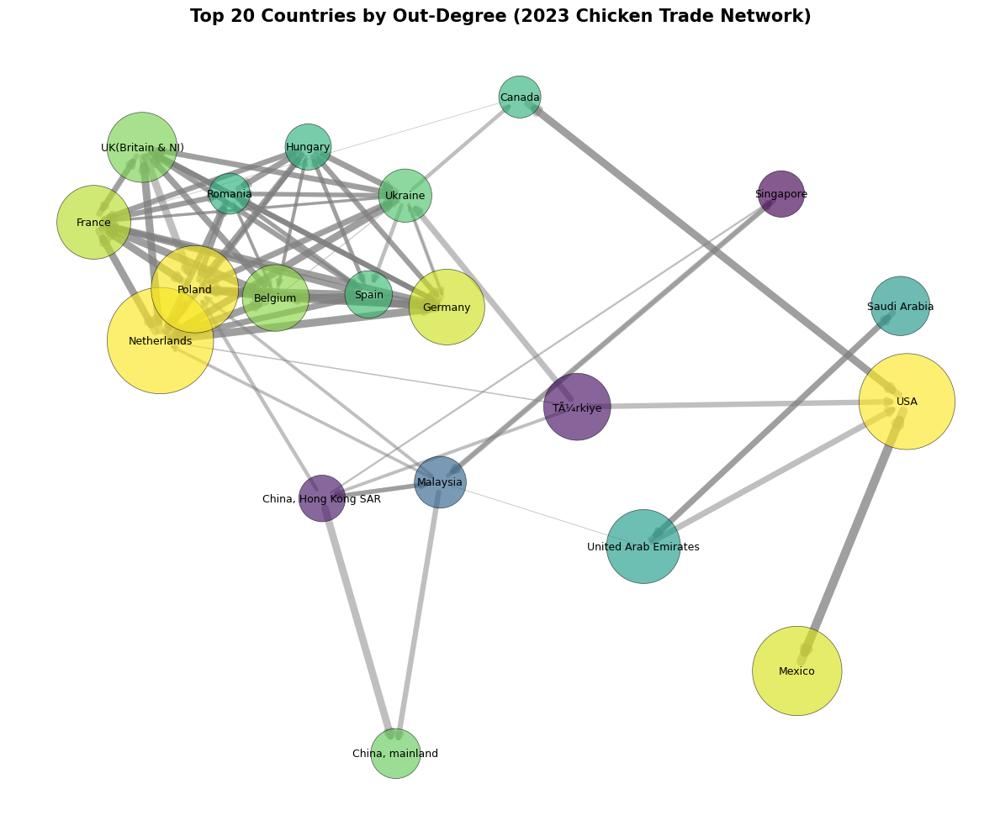

In [148]:
top20_out_nodes = sorted(gc_2023.nodes(data=True), key=lambda x: x[1].get('out_degree', 0), reverse=True)[:20]
top20_node_names = [node[0] for node in top20_out_nodes]

gc_2023_top20 = gc_2023.subgraph(top20_node_names).copy()

out_degrees = np.array([gc_2023_top20.nodes[n].get('out_degree', 0) for n in gc_2023_top20.nodes()])
node_sizes = 300 + 8000 * out_degrees / (out_degrees.max() + 1e-9)

in_degrees = np.array([gc_2023_top20.nodes[n].get('in_degree', 0) for n in gc_2023_top20.nodes()])
log_in_deg = np.log1p(in_degrees)
color_vals = (log_in_deg - log_in_deg.min()) / (log_in_deg.max() - log_in_deg.min() + 1e-9)
node_colors = plt.cm.viridis(color_vals)

edge_weights = np.array([d.get('Final Value', 1) for u, v, d in gc_2023_top20.edges(data=True)])
log_weights = np.log1p(edge_weights)
norm_weights = 0.5 + 7 * (log_weights - log_weights.min()) / (log_weights.max() - log_weights.min() + 1e-9)

plt.figure(figsize=(12, 10))
pos = nx.spring_layout(gc_2023_top20, seed=42, k=1.2)

nx.draw_networkx_nodes(
    gc_2023_top20, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.65,
    linewidths=0.5
)

nx.draw_networkx_edges(
    gc_2023_top20, pos,
    edge_color='gray',
    width=norm_weights,
    arrows=True,
    arrowstyle='->',
    alpha=0.5,
    min_source_margin=1,
    min_target_margin=1
)

custom_labels = {
    "Netherlands (Kingdom of the)": "Netherlands",
    "United Kingdom of Great Britain and Northern Ireland": "UK(Britain & NI)",
    "United States of America": "USA"
}
final_labels = {node: custom_labels.get(node, node) for node in gc_2023_top20.nodes()}

nx.draw_networkx_labels(gc_2023_top20, pos, labels=final_labels, font_size=9)

plt.title("Top 20 Countries by Out-Degree (2023 Chicken Trade Network)", fontsize=15, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()


## Production 기준으로 노드 크기, Area harvested 기준으로 색상

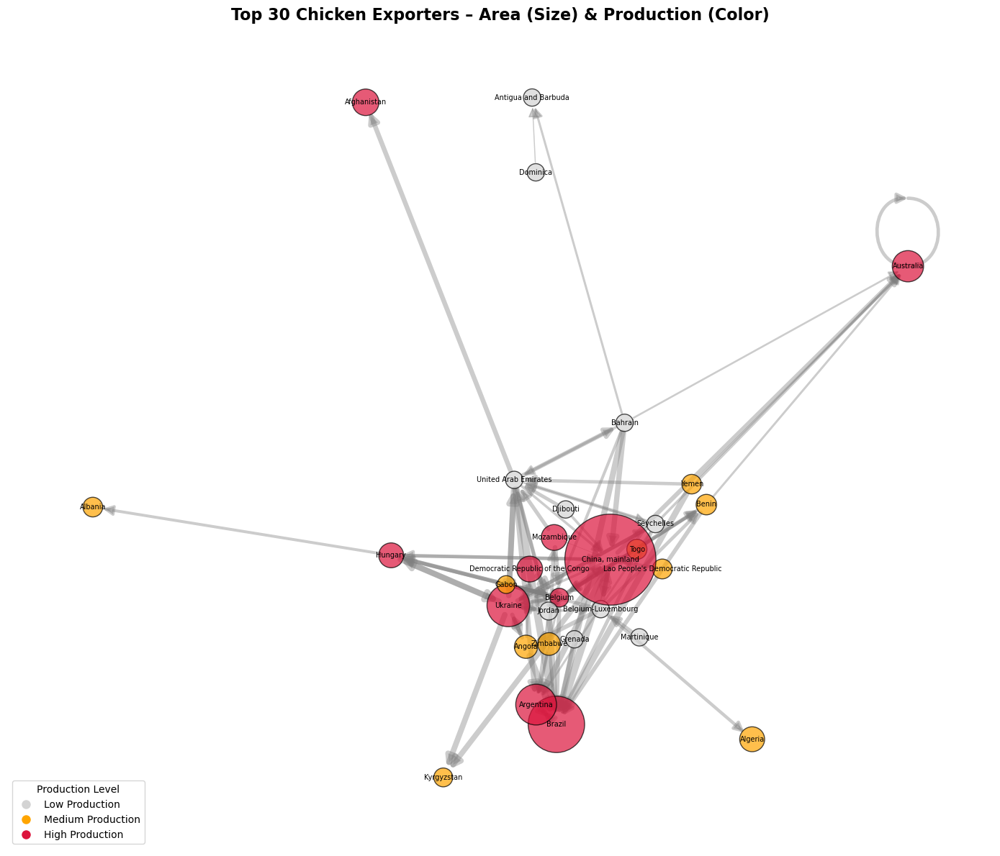

In [149]:
from matplotlib.lines import Line2D

# Top 30 by out-degree
top30_nodes = sorted(gc.nodes(data=True), key=lambda x: x[1].get('out_degree', 0), reverse=True)[:30]
top30_names = [n[0] for n in top30_nodes]
gc_top30 = gc.subgraph(top30_names).copy()

# --- Node size: Area (Area harvested or similar) ---
area_vals = np.array([gc_top30.nodes[n].get('Area harvested', 0) for n in gc_top30.nodes()])
node_sizes = 300 + 8000 * area_vals / (area_vals.max() + 1e-9)

# --- Node color: Production level (3-stage color) ---
prod_vals = np.array([gc_top30.nodes[n].get('Production', 0) for n in gc_top30.nodes()])
p33, p66 = np.percentile(prod_vals, [33, 66])

node_colors = []
for n in gc_top30.nodes():
    val = gc_top30.nodes[n].get('Production', 0)
    if val < p33:
        node_colors.append('lightgray')
    elif val < p66:
        node_colors.append('orange')
    else:
        node_colors.append('crimson')

# --- Edge width: Final Value (log-scaled) ---
edge_weights = [d['Final Value'] for _, _, d in gc_top30.edges(data=True)]
widths = 0.5 + 7 * (np.log1p(edge_weights) - np.log1p(min(edge_weights))) / \
                 (np.log1p(max(edge_weights)) - np.log1p(min(edge_weights)) + 1e-9)

# --- Visualization ---
plt.figure(figsize=(14, 12))
pos = nx.spring_layout(gc_top30, seed=42)

# Draw nodes
nx.draw_networkx_nodes(
    gc_top30, pos,
    node_size=node_sizes,
    node_color=node_colors,
    edgecolors='black',
    alpha=0.7
)

# Draw edges
nx.draw_networkx_edges(
    gc_top30, pos,
    edge_color='gray',
    width=widths,
    arrows=True,
    arrowstyle='-|>',
    arrowsize=20,
    alpha=0.4,
    min_source_margin=10,
    min_target_margin=10
)

# Draw labels
nx.draw_networkx_labels(gc_top30, pos, font_size=7)

# Custom legend
legend_elements = [
    Line2D([0], [0], marker='o', color='w', label='Low Production', markerfacecolor='lightgray', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='Medium Production', markerfacecolor='orange', markersize=10),
    Line2D([0], [0], marker='o', color='w', label='High Production', markerfacecolor='crimson', markersize=10)
]
plt.legend(handles=legend_elements, title="Production Level", loc='lower left', fontsize=10)

# Title & layout
plt.title("Top 30 Chicken Exporters – Area (Size) & Production (Color)", fontsize=16, fontweight='bold')
plt.axis("off")
plt.tight_layout()
plt.show()

# World Map Mapping

## [Maize] Map

In [150]:
import geopandas as gpd
import pandas as pd
import plotly.graph_objects as go

# (1) Read shapefile and extract centroids
gdf = gpd.read_file("world_countries_new.shp")
gdf['centroid'] = gdf.geometry.centroid
gdf['lon'] = gdf.centroid.x
gdf['lat'] = gdf.centroid.y
gdf = gdf[['Area', 'lon', 'lat']].dropna(subset=['Area'])

# (2) Extract node data from network
node_data = pd.DataFrame.from_dict(dict(gm.nodes(data=True)), orient='index')
node_data.reset_index(inplace=True)
node_data.rename(columns={'index': 'node'}, inplace=True)

# (3) Merge node data with shapefile using 'Area' (country name)
merged_node = pd.merge(
    node_data.assign(node=node_data['node'].astype(str)),
    gdf.assign(Area=gdf['Area'].astype(str)),
    left_on='node',
    right_on='Area',
    how='left'
)

# (4) Prepare edge data for mapping
edge_data = pd.DataFrame([
    {'source': u, 'target': v, **data}
    for u, v, data in gm.edges(data=True)
])

# (5) Add source coordinates
merged_edge = pd.merge(
    edge_data,
    gdf,
    left_on='source',
    right_on='Area',
    how='inner'
).rename(columns={'lon': 'start_lon', 'lat': 'start_lat'}).drop(columns=['Area'])

# (6) Add target coordinates
merged_edge = pd.merge(
    merged_edge,
    gdf,
    left_on='target',
    right_on='Area',
    how='inner'
).rename(columns={'lon': 'end_lon', 'lat': 'end_lat'}).drop(columns=['Area'])

# (7) Filter for major trades only
merged_edge_s = merged_edge[merged_edge['Final Value'] > 50].reset_index(drop=True)

# (8) Plotting
fig = go.Figure()

# --- Node markers ---
fig.add_trace(go.Scattergeo(
    lon=merged_node['lon'],
    lat=merged_node['lat'],
    text=merged_node['node'],  # hover info
    hoverinfo='text',
    mode='markers',
    marker=dict(
        size=merged_node['i_degree'], 
        sizemode='area',
        sizeref=2. * merged_node['i_degree'].max() / (40. ** 2),
        sizemin=2,
        color='rgb(255, 0, 0)',
        line=dict(width=1, color='rgba(68, 68, 68, 0.3)')
    )
))

# --- Edge lines ---
for i, row in merged_edge_s.iterrows():
    fig.add_trace(go.Scattergeo(
        lon=[row['start_lon'], row['end_lon']],
        lat=[row['start_lat'], row['end_lat']],
        mode='lines',
        line=dict(
            width=0.5 + 4 * (row['Final Value'] / merged_edge_s['Final Value'].max()),
            color='red'
        ),
        opacity=0.6
    ))

# --- Layout ---
fig.update_layout(
    title_text='2023 Global Trade – Maize (Country Names + Flow)',
    showlegend=False,
    geo=dict(
        scope='world',
        projection_type='equirectangular',
        showland=True,
        landcolor='rgb(243, 243, 243)',
        countrycolor='rgb(204, 204, 204)',
    )
)

fig.show()


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/655946446.py:7: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/655946446.py:8: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/655946446.py:9: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.




## [Chicken] Map

In [151]:
# --- Step 1: Read and prepare shapefile ---
gdf = gpd.read_file("world_countries_new.shp")

# Reproject for accurate centroid calculation
gdf = gdf.to_crs(epsg=3857)
gdf['centroid'] = gdf.geometry.centroid

# Convert back to lat/lon
gdf = gdf.to_crs(epsg=4326)
gdf['lon'] = gdf.centroid.x
gdf['lat'] = gdf.centroid.y

# Keep relevant columns
gdf = gdf[['Area', 'lon', 'lat']].dropna()

# --- Step 2: Prepare node data from gc (Chicken network) ---
node_data = pd.DataFrame.from_dict(dict(gc.nodes(data=True)), orient='index')
node_data.reset_index(inplace=True)
node_data.rename(columns={'index': 'node'}, inplace=True)

# Merge node info with country coordinates by country name
merged_node = pd.merge(
    node_data.assign(node=node_data['node'].astype(str)),
    gdf.assign(Area=gdf['Area'].astype(str)),
    left_on='node',
    right_on='Area',
    how='left'
)

# --- Step 3: Prepare edge data from gc ---
edge_data = pd.DataFrame([
    {'source': u, 'target': v, **data}
    for u, v, data in gc.edges(data=True)
])

# Add source coordinates
merged_edge = pd.merge(
    edge_data,
    gdf,
    left_on='source',
    right_on='Area',
    how='inner'
).rename(columns={'lon': 'start_lon', 'lat': 'start_lat'}).drop(columns=['Area'])

# Add target coordinates
merged_edge = pd.merge(
    merged_edge,
    gdf,
    left_on='target',
    right_on='Area',
    how='inner'
).rename(columns={'lon': 'end_lon', 'lat': 'end_lat'}).drop(columns=['Area'])

# Optional: filter for large trade flows
merged_edge_s = merged_edge[merged_edge['Final Value'] > 50].reset_index(drop=True)

# --- Step 4: Plotting ---
fig = go.Figure()

# Draw nodes
fig.add_trace(go.Scattergeo(
    lon=merged_node['lon'],
    lat=merged_node['lat'],
    text=merged_node['node'],
    hoverinfo='text',
    mode='markers',
    marker=dict(
        size=merged_node['i_degree'],  
        sizemode='area',
        sizeref=2. * merged_node['i_degree'].max() / (40. ** 2),
        sizemin=2,
        color='rgb(255, 0, 0)',
        line=dict(width=1, color='rgba(68, 68, 68, 0.3)')
    )
))

# Draw trade edges
for i, row in merged_edge_s.iterrows():
    fig.add_trace(go.Scattergeo(
        lon=[row['start_lon'], row['end_lon']],
        lat=[row['start_lat'], row['end_lat']],
        mode='lines',
        line=dict(
            width=0.5 + 4 * (row['Final Value'] / merged_edge_s['Final Value'].max()),
            color='red'
        ),
        opacity=0.6
    ))

# Final layout
fig.update_layout(
    title_text='2023 Global Trade – Chicken (Country Names + Flow)',
    showlegend=False,
    geo=dict(
        scope='world',
        projection_type='equirectangular',
        showland=True,
        landcolor='rgb(243, 243, 243)',
        countrycolor='rgb(204, 204, 204)',
    )
)

fig.show()


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/497772780.py:10: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


/var/folders/lm/sbbqnfc90fbdd149t608pb9w0000gn/T/ipykernel_43431/497772780.py:11: UserWarning:

Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.


